# I. Jeux de données

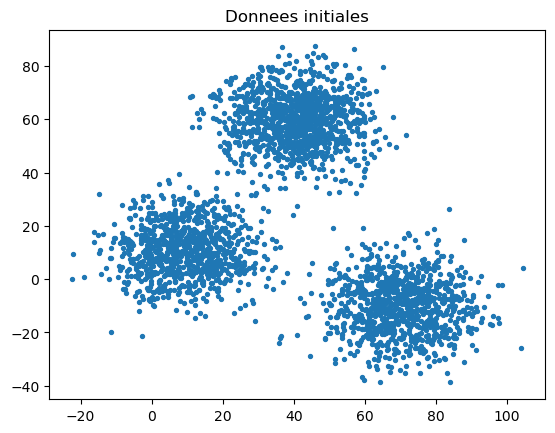

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import arff
# Parser un fichier de donnees au format arff
# data est un tableau d ’ exemples avec pour chacun
# la liste des valeurs des features
#
# Dans les jeux de donnees consideres :
# il y a 2 features ( dimension 2 )
# Ex : [[ - 0 . 499261 , -0 . 0612356 ] ,
# [ - 1 . 51369 , 0 . 265446 ] ,
# [ - 1 . 60321 , 0 . 362039 ] , .....
# ]
#
# Note : chaque exemple du jeu de donnees contient aussi un
# numero de cluster . On retire cette information
path = './artificial/'
databrut = arff.loadarff(open(path + "xclara.arff", 'r'))
datanp = np.array([[x[0],x[1]] for x in databrut[0]])
# Affichage en 2D
# Extraire chaque valeur de features pour en faire une liste
# Ex pour f0 = [ - 0 . 499261 , -1 . 51369 , -1 . 60321 , ...]
# Ex pour f1 = [ - 0 . 0612356 , 0 . 265446 , 0 . 362039 , ...]
f0 = datanp[:,0] # tous les elements de la premiere colonne
f1 = datanp[:,1] # tous les elements de la deuxieme colonne
plt.scatter (f0 ,f1 ,s=8)
plt.title("Donnees initiales")
plt.show()

# II. Clustering k-Means

Appel KMeans pour une valeur fixée de k


/home/ronan/anaconda3/lib/python3.12/site-packages/threadpoolctl.py:1214: RuntimeWarning: 
Found Intel OpenMP ('libiomp') and LLVM OpenMP ('libomp') loaded at
the same time. Both libraries are known to be incompatible and this
can cause random crashes or deadlocks on Linux when loaded in the
same Python program.
Using threadpoolctl may cause crashes or deadlocks. For more
information and possible workarounds, please see
    https://github.com/joblib/threadpoolctl/blob/master/multiple_openmp.md

  warnings.warn(msg, RuntimeWarning)


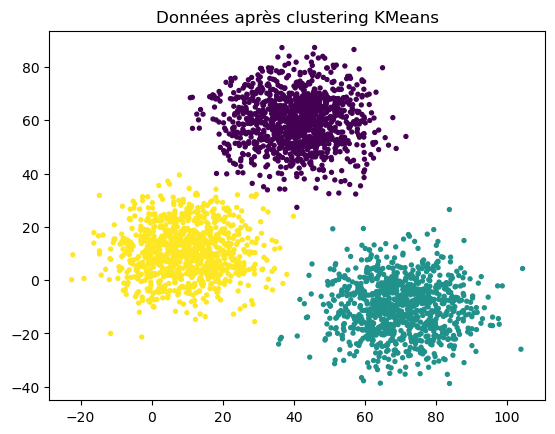

Nb clusters = 3 , Nb iter = 3 , Runtime = 36.03 ms


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import time
from sklearn import cluster

# Les données sont dans datanp (2 dimensions)
# f0 : valeurs sur la première dimension
# f1 : valeurs sur la deuxième dimension

print("Appel KMeans pour une valeur fixée de k")

# Start timing
tps1 = time.time()

# Number of clusters
k = 3

# Initialize and fit KMeans model
model = cluster.KMeans(n_clusters=k, init='k-means++')
model.fit(datanp)

# End timing
tps2 = time.time()

# Retrieve clustering results
labels = model.labels_
iteration = model.n_iter_

# Plot the clustered data
plt.scatter(f0, f1, c=labels, s=8)
plt.title("Données après clustering KMeans")
plt.show()

# Print results
print("Nb clusters =", k, ", Nb iter =", iteration, ", Runtime =", round((tps2 - tps1) * 1000, 2), "ms")


## II.2. Intérêts de la méthode k-Means

In [3]:
def show_dataset(file):
    path = './artificial/'
    databrut = arff.loadarff(open(path + file + ".arff", 'r'))
    datanp = np.array([[x[0],x[1]] for x in databrut[0]])
    f0 = datanp[:,0] 
    f1 = datanp[:,1]
    plt.scatter (f0 ,f1 ,s=8)
    plt.title(file)
    plt.show()

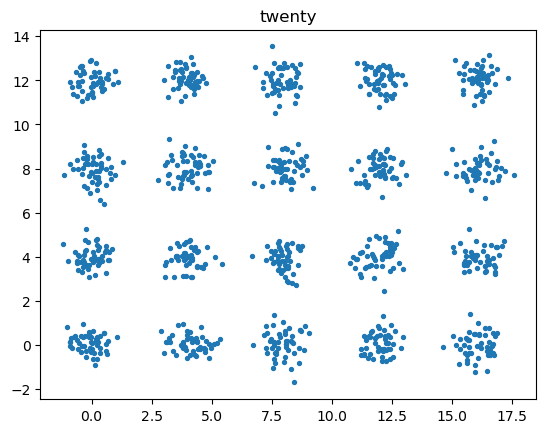

In [4]:
show_dataset("twenty")

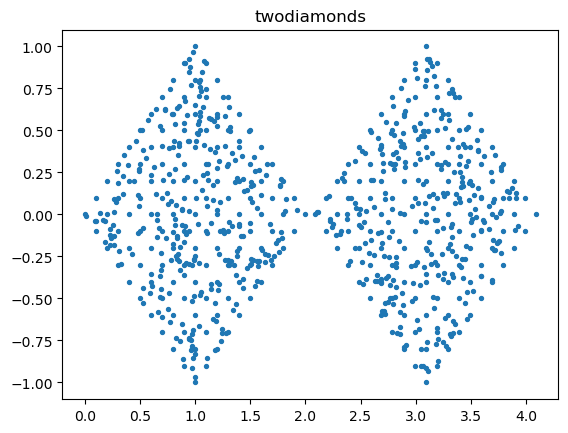

In [5]:
show_dataset("twodiamonds")

In [8]:
from sklearn.cluster import KMeans 
def k_means_clustering_fit(datanp, f0,f1,k):
    # Start timing
    tps1 = time.time()
    
    # Initialize and fit KMeans model
    model = cluster.KMeans(n_clusters=k, init='k-means++')
    model.fit(datanp)
    
    # End timing
    tps2 = time.time()
    
    # Retrieve clustering results
    labels = model.labels_
    iteration = model.n_iter_
    
    # Plot the clustered data
    # plt.scatter(f0, f1, c=labels, s=8)
    # plt.title("Données après clustering KMeans ")
    # plt.show()
    runtime = round((tps2 - tps1) * 1000, 2)

    # Print results
    # print("Nb clusters =", k, ", Nb iter =", iteration, ", Runtime =", runtime, "ms")
    return model, labels, runtime

def agglomerative_clustering_fit(datanp, f0,f1, n_clusters=None, linkage='ward', distance_threshold=None):
    tps1 = time.time()
    model = cluster.AgglomerativeClustering(
        linkage=linkage,
        n_clusters=n_clusters,
        distance_threshold=distance_threshold
    )
    model = model.fit(datanp)
    tps2 = time.time()
    
    # Retrieve clustering results for k clusters
    labels = model.labels_
    kres = model.n_clusters_
    leaves = model.n_leaves_
    
    # Display clustering results
    # plt.scatter(f0, f1, c=labels, s=8)
    # plt.title("Résultat du clustering")
    # plt.show()

    runtime = round((tps2 - tps1) * 1000, 2)

    # print("Nb clusters =", k, ", Runtime =", runtime, "ms")
    return model, labels, runtime

from sklearn.metrics import davies_bouldin_score, calinski_harabasz_score, silhouette_score
import numpy as np

def get_data(file, path='./artificial'):
    if path == './artificial':
        databrut = arff.loadarff(open(path + '/' + file + ".arff", 'r'))
        datanp = np.array([[x[0],x[1]] for x in databrut[0]])
        f0 = datanp[:,0] 
        f1 = datanp[:,1]
    else:
        datanp = np.loadtxt(path_rapport + '/' + file + '.txt')
        f0 = datanp[:,0]
        f1 = datanp[:,1]
    return datanp, f0, f1

def evaluate_clustering(file, algo_name, n_clusters=None, agglo_linkage='ward', path='./artificial', use_distance_threshold=False, dists=[]):
    datanp, f0, f1 = get_data(file, path)
    sil_scores = []
    db_scores = []
    ch_scores = []
    labels_list = []
    runtimes = []
    if not use_distance_threshold:
        for k in ks:
            if algo_name == "k_means":
                model, labels, runtime = k_means_clustering_fit(datanp, f0, f1, k)
            else:
                print(k,agglo_linkage)
                model, labels, runtime = agglomerative_clustering_fit(datanp, f0, f1, n_clusters=k, linkage=agglo_linkage)
            sil_scores.append(silhouette_score(datanp, model.fit_predict(datanp)))
            db_scores.append(davies_bouldin_score(datanp, model.fit_predict(datanp)))
            ch_scores.append(calinski_harabasz_score(datanp, model.fit_predict(datanp)))
            labels_list.append(labels)
            runtimes.append(runtime)
    
        figmodel, axesmodel = plt.subplots(5,4, figsize=(12,10))
        axesmodel = axesmodel.ravel()
    
        for idx, labels in enumerate(labels_list):
            scatter = axesmodel[idx].scatter(f0, f1, c=labels, s=4)
            axesmodel[idx].set_title(file+' '+algo_name+' '+ str(ks[idx]))
        
        plt.tight_layout()
        plt.show()   

    else:
        for d in dists:
            model, labels, runtime = agglomerative_clustering_fit(datanp, f0, f1, linkage=agglo_linkage, n_clusters=None, distance_threshold=d)
            # print(np.unique(labels))
            # print(len(np.unique(labels)))
            if len(np.unique(labels)) != 1 and len(np.unique(labels)) != len(f0):
                sil_scores.append(silhouette_score(datanp, model.fit_predict(datanp)))
                db_scores.append(davies_bouldin_score(datanp, model.fit_predict(datanp)))
                ch_scores.append(calinski_harabasz_score(datanp, model.fit_predict(datanp)))
                labels_list.append(labels)
                runtimes.append(runtime)
            else:
                print ("Only 1 cluster or as many clusters as points for this model with distance: ", d)
                sil_scores.append(-1)
                db_scores.append(0)
                ch_scores.append(1000)
                labels_list.append(labels)
                runtimes.append(runtime)
                
    
        figmodel, axesmodel = plt.subplots(5,4, figsize=(12,10))
        axesmodel = axesmodel.ravel()
    
        for idx, labels in enumerate(labels_list):
            scatter = axesmodel[idx].scatter(f0, f1, c=labels, s=4)
            axesmodel[idx].set_title(file+' '+agglo_linkage+' d='+ str(dists[idx]) + ' k='+ (str(ks[idx] if not use_distance_threshold else str(len(np.unique(labels_list[idx]))) )) )
        
        plt.tight_layout()
        plt.show()   
    
        
    # Create a 2x2 grid of subplots
    fig, axes = plt.subplots(2, 2, figsize=(12, 10))

    axes[0, 0].plot(ks if not use_distance_threshold else dists, runtimes, marker='o', linestyle='-', color='y')
    axes[0, 0].set_title("Runtime")
    axes[0, 0].set_xlabel("Number of Clusters (k)" if not use_distance_threshold else "Distance threshold")
    axes[0, 0].set_ylabel("Runtime in ms")
    axes[0, 0].grid(True)
    
    # First subplot: Silhouette Score
    axes[0, 1].plot(ks if not use_distance_threshold else dists, sil_scores, marker='o', linestyle='-', color='b')
    axes[0, 1].set_title("Silhouette Score")
    axes[0, 1].set_xlabel("Number of Clusters (k)" if not use_distance_threshold else "Distance threshold")
    axes[0, 1].set_ylabel("Silhouette Score")
    axes[0, 1].grid(True)
    
    # Second subplot: Davies-Bouldin Index
    axes[1, 0].plot(ks if not use_distance_threshold else dists, db_scores, marker='o', linestyle='-', color='r')
    axes[1, 0].set_title("Davies-Bouldin Index")
    axes[1, 0].set_xlabel("Number of Clusters (k)" if not use_distance_threshold else "Distance threshold")
    axes[1, 0].set_ylabel("Davies-Bouldin Index")
    axes[1, 0].grid(True)
    
    # Third subplot: Calinski-Harabasz Index
    axes[1, 1].plot(ks if not use_distance_threshold else dists, ch_scores, marker='o', linestyle='-', color='g')
    axes[1, 1].set_title("Calinski-Harabasz Index")
    axes[1, 1].set_xlabel("Number of Clusters (k)" if not use_distance_threshold else "Distance threshold")
    axes[1, 1].set_ylabel("Calinski-Harabasz Index")
    axes[1, 1].grid(True)

    if use_distance_threshold:
        axes[0, 0].set_xscale('log')
        axes[0, 1].set_xscale('log')
        axes[1, 0].set_xscale('log')
        axes[1, 1].set_xscale('log')
    
    # Remove the unused subplot (axes[0, 0])
    # axes[0, 0].axis('off')  # This will hide the subplot
    
    # Adjust layout and show the plot
    plt.tight_layout()
    plt.show()




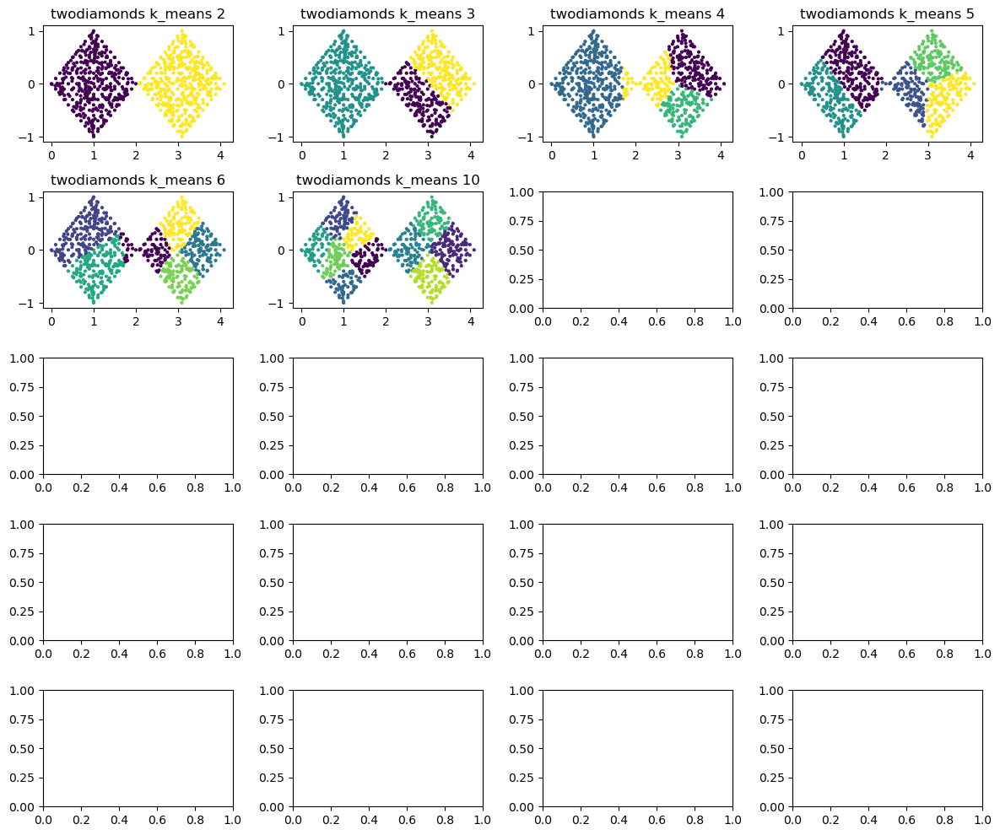

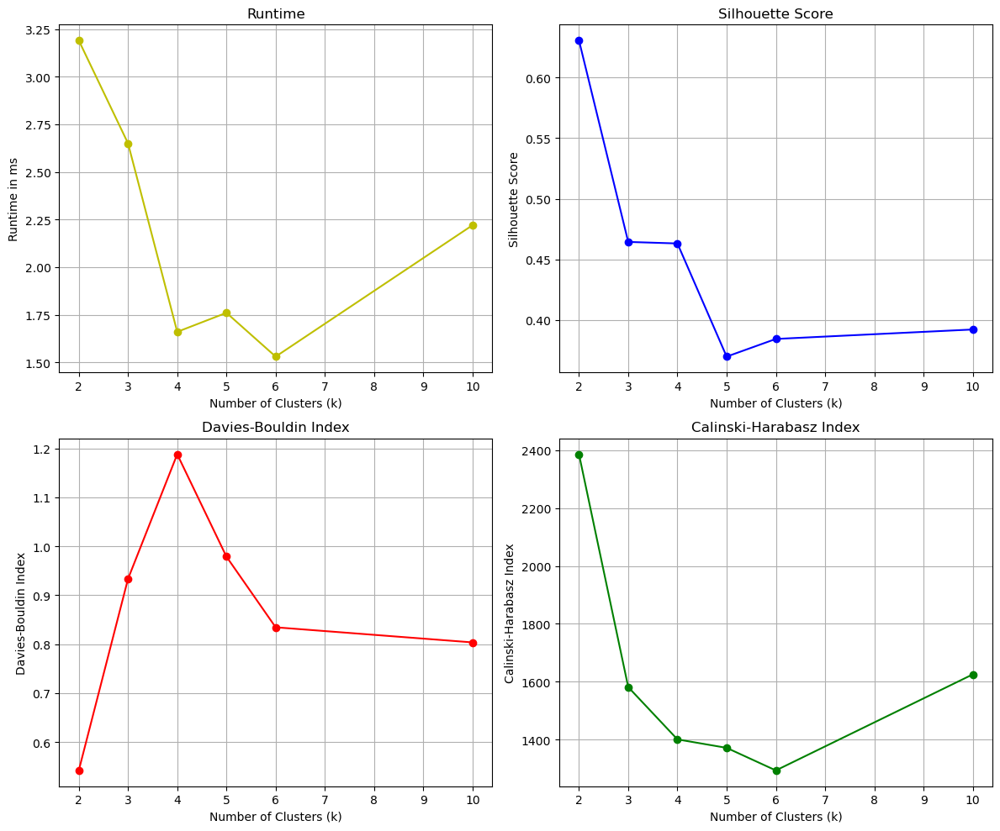

In [9]:
ks = [2,3,4,5,6,10]
evaluate_clustering("twodiamonds", "k_means", ks)

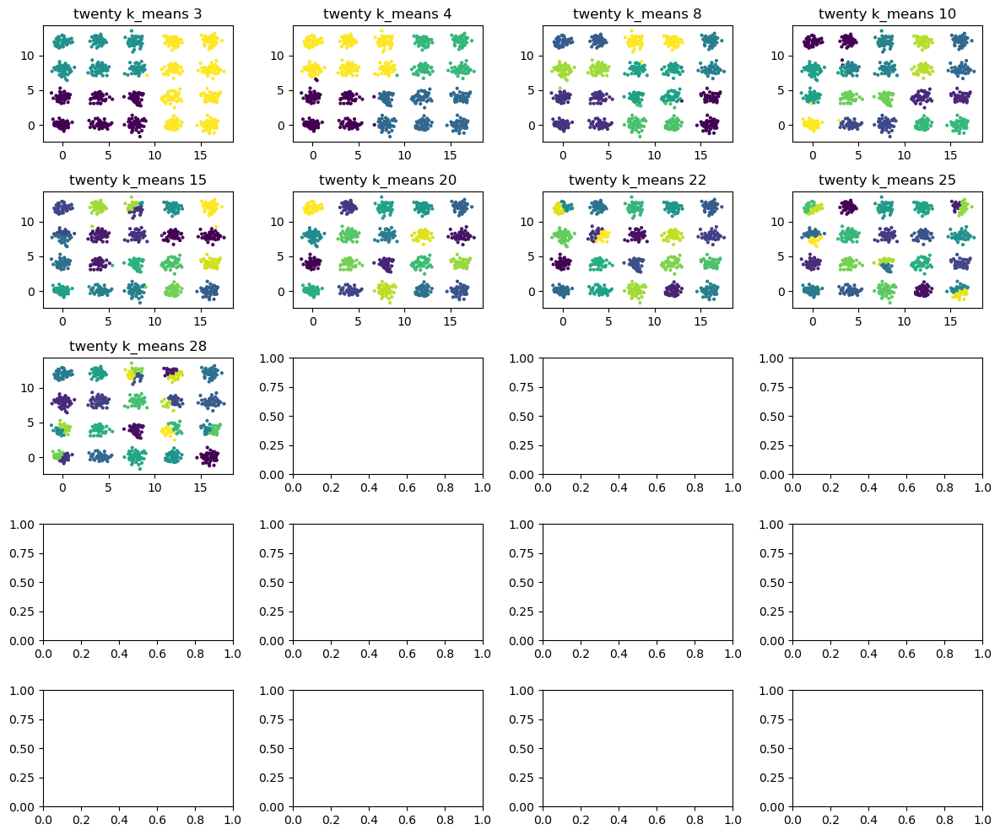

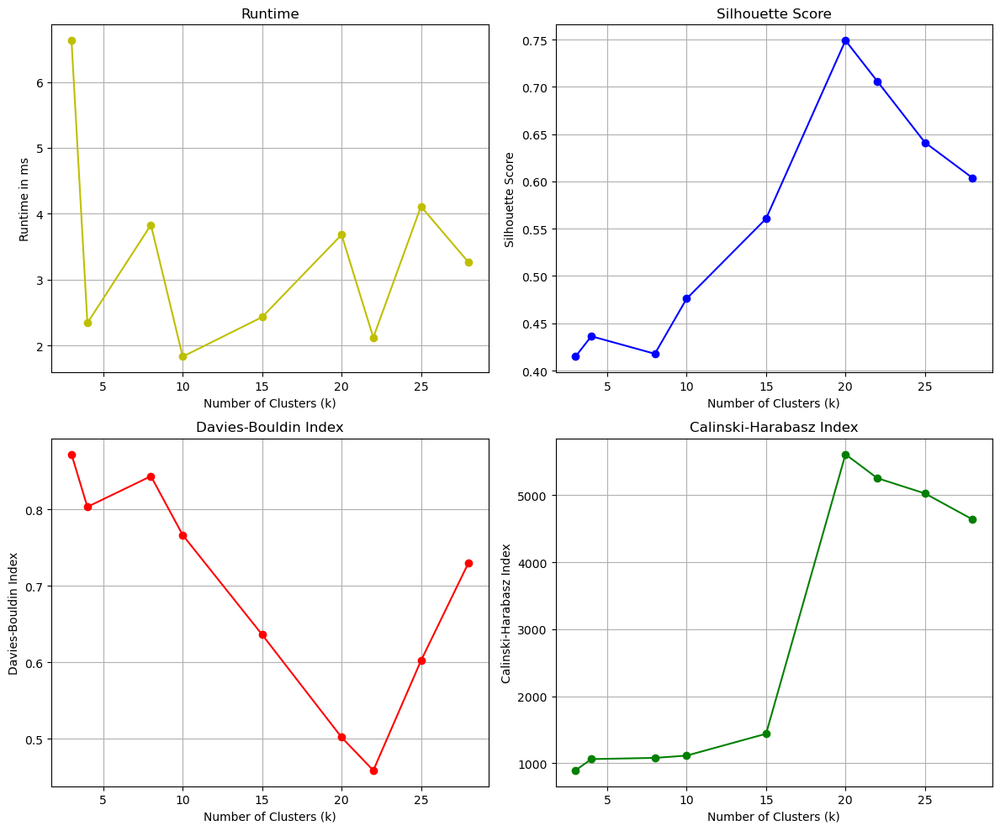

In [10]:
ks = [3,4,8,10,15,20,22,25,28]
evaluate_clustering("twenty", "k_means", ks)

## II.3. Limites de la méthode k-Means

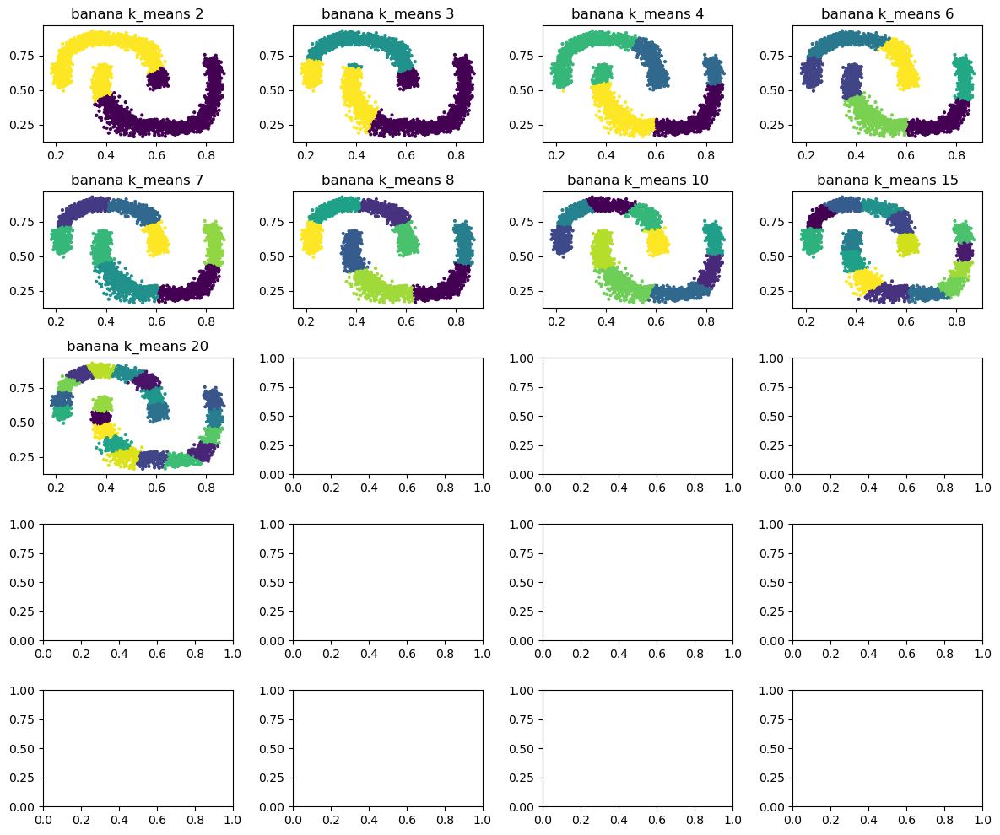

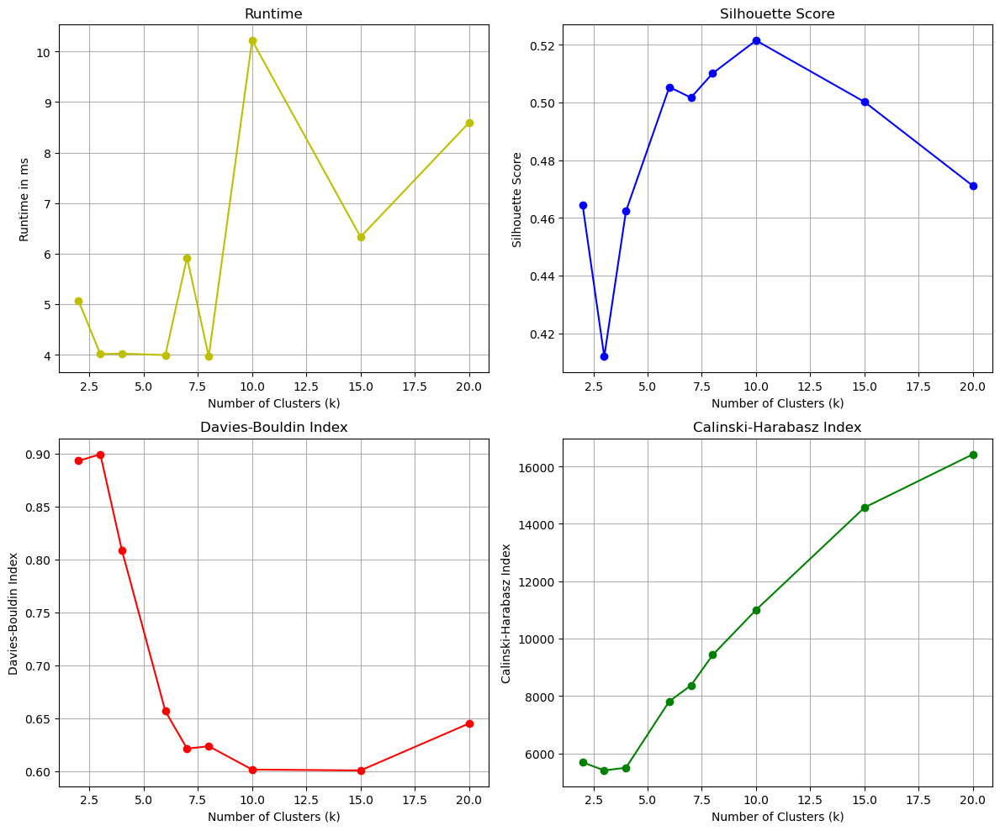

In [11]:
ks = [2,3,4,6,7,8,10,15,20]
evaluate_clustering("banana", "k_means", ks)

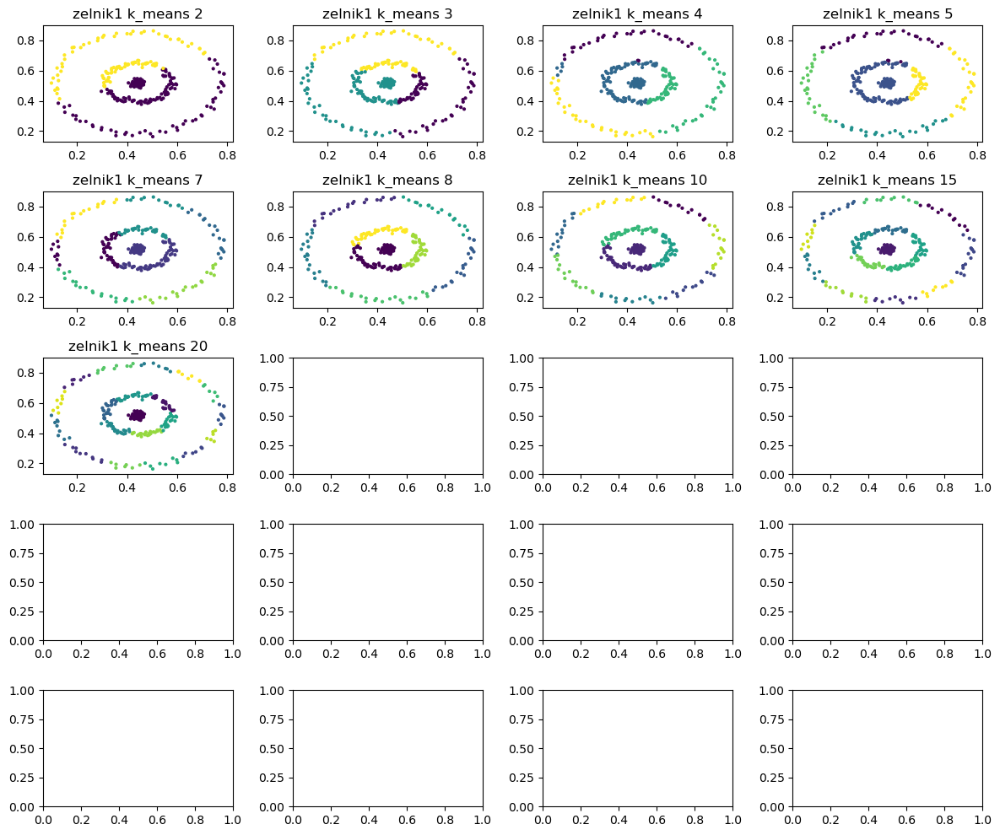

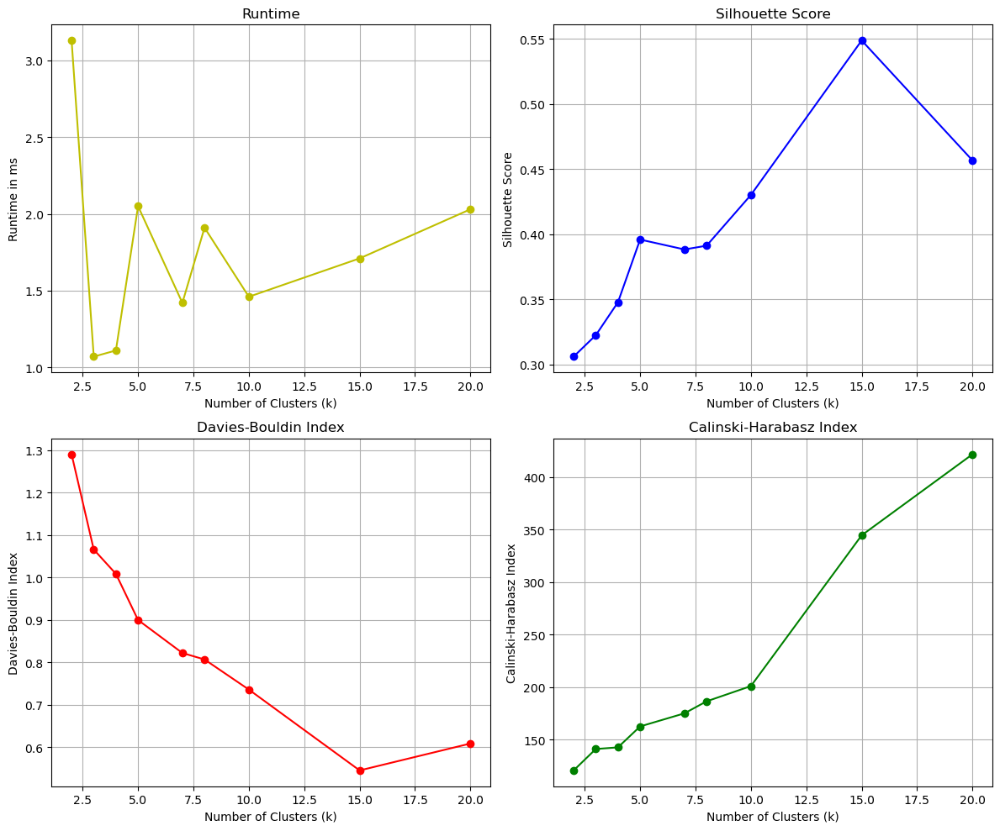

In [12]:
ks = [2,3,4,5,7,8,10,15,20]
evaluate_clustering("zelnik1", "k_means", ks)

# III. Clustering agglomératif

Dendrogramme 'single' données initiales


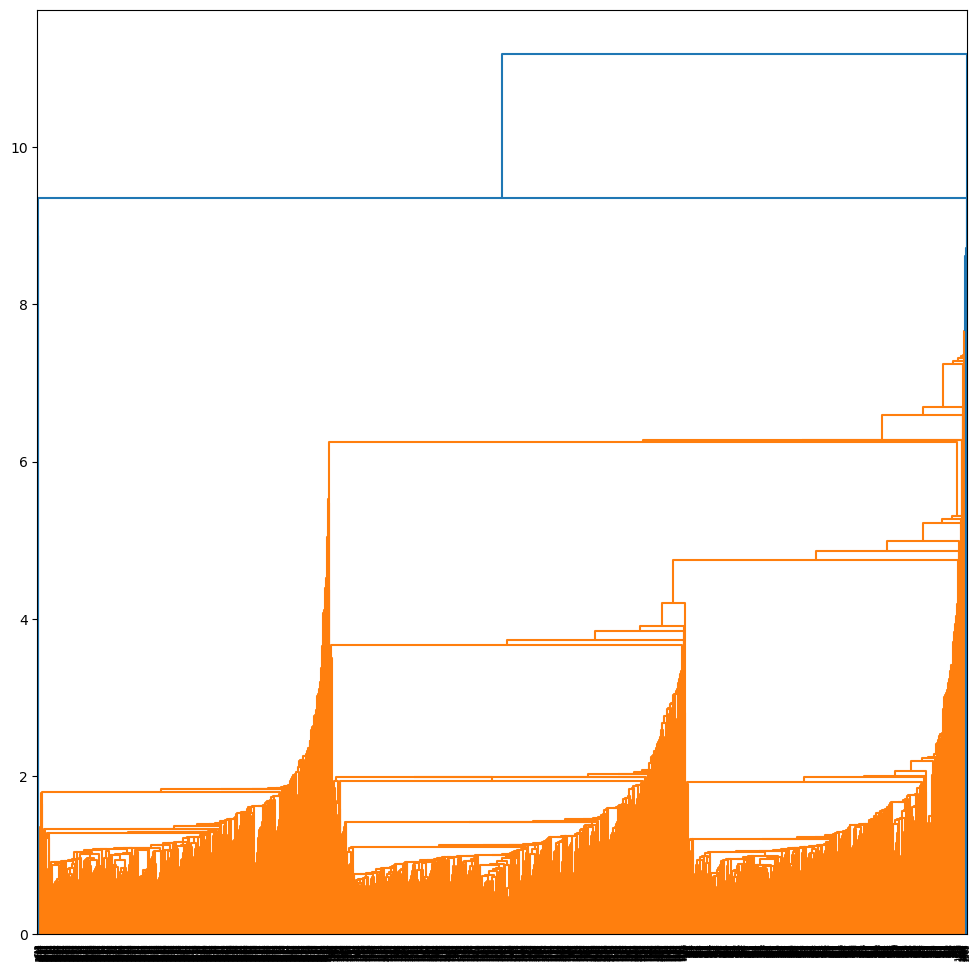

In [13]:
import scipy.cluster.hierarchy as shc
import time
from sklearn import cluster
import matplotlib.pyplot as plt

# Données dans datanp
print("Dendrogramme 'single' données initiales")

# Compute the linkage matrix
linked_mat = shc.linkage(datanp, 'single')

# Plot the dendrogram
plt.figure(figsize=(12, 12))
shc.dendrogram(
    linked_mat,
    orientation='top',
    distance_sort='descending',
    show_leaf_counts=False
)
plt.show()

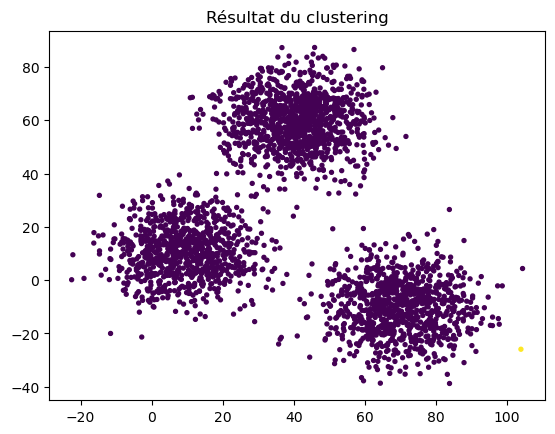

Nb clusters = 2 , Nb feuilles = 3000 , Runtime = 20.7 ms


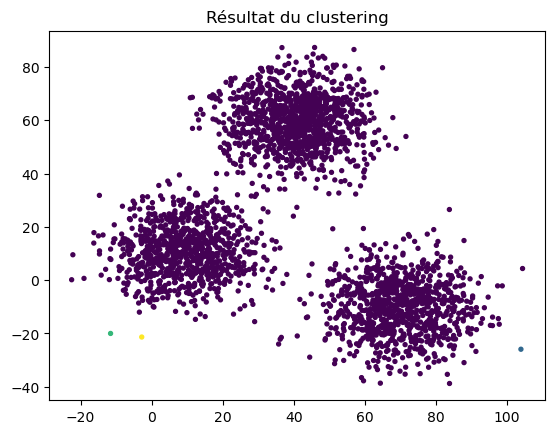

Nb clusters = 4 , Nb feuilles = 3000 , Runtime = 20.33 ms


In [14]:
# Set distance_threshold (0 ensures we compute the full tree)
tps1 = time.time()
model = cluster.AgglomerativeClustering(
    distance_threshold=10,
    linkage='single',
    n_clusters=None
)
model = model.fit(datanp)
tps2 = time.time()

# Retrieve clustering results
labels = model.labels_
k = model.n_clusters_
leaves = model.n_leaves_

# Display clustering results
plt.scatter(f0, f1, c=labels, s=8)
plt.title("Résultat du clustering")
plt.show()

# Print clustering information
print("Nb clusters =", k, ", Nb feuilles =", leaves, 
      ", Runtime =", round((tps2 - tps1) * 1000, 2), "ms")

# Set the number of clusters
k = 4
tps1 = time.time()
model = cluster.AgglomerativeClustering(
    linkage='single',
    n_clusters=k
)
model = model.fit(datanp)
tps2 = time.time()

# Retrieve clustering results for k clusters
labels = model.labels_
kres = model.n_clusters_
leaves = model.n_leaves_

# Display clustering results
plt.scatter(f0, f1, c=labels, s=8)
plt.title("Résultat du clustering")
plt.show()

# Print clustering information
print("Nb clusters =", k, ", Nb feuilles =", leaves, 
      ", Runtime =", round((tps2 - tps1) * 1000, 2), "ms")


## III.2.Intérêts de la méthode

### Banana

#### Banana with k

Evaluating with linkage single
2 single
3 single
4 single
6 single
7 single
8 single
10 single
15 single
20 single


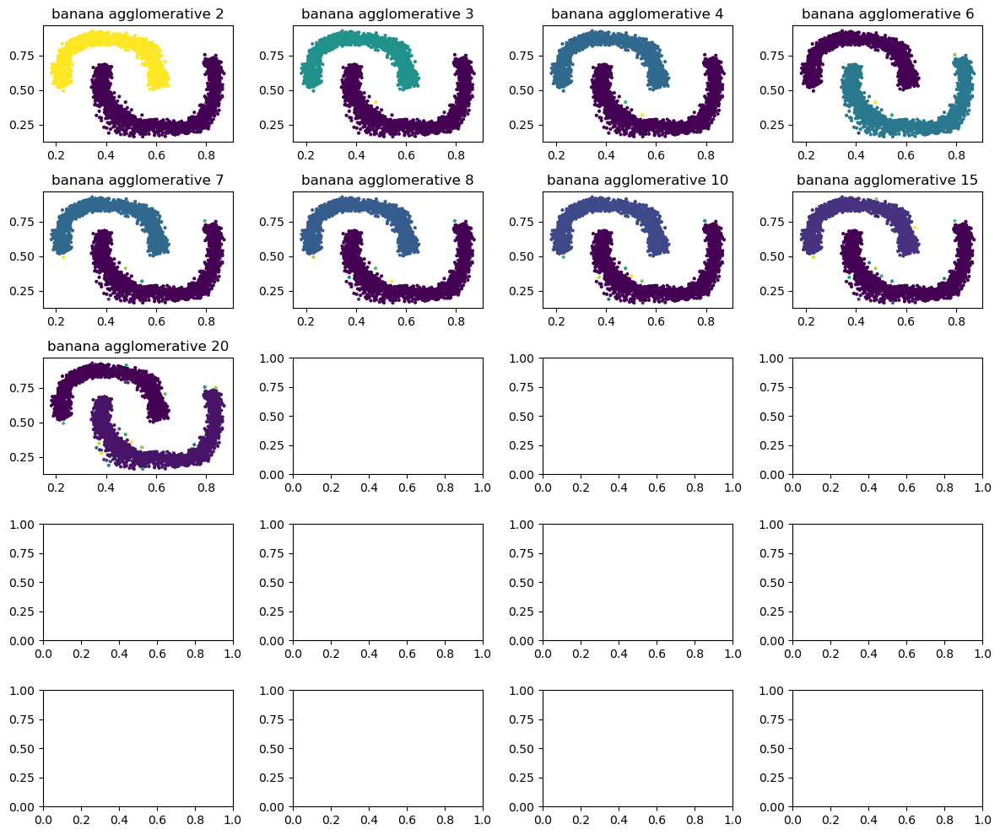

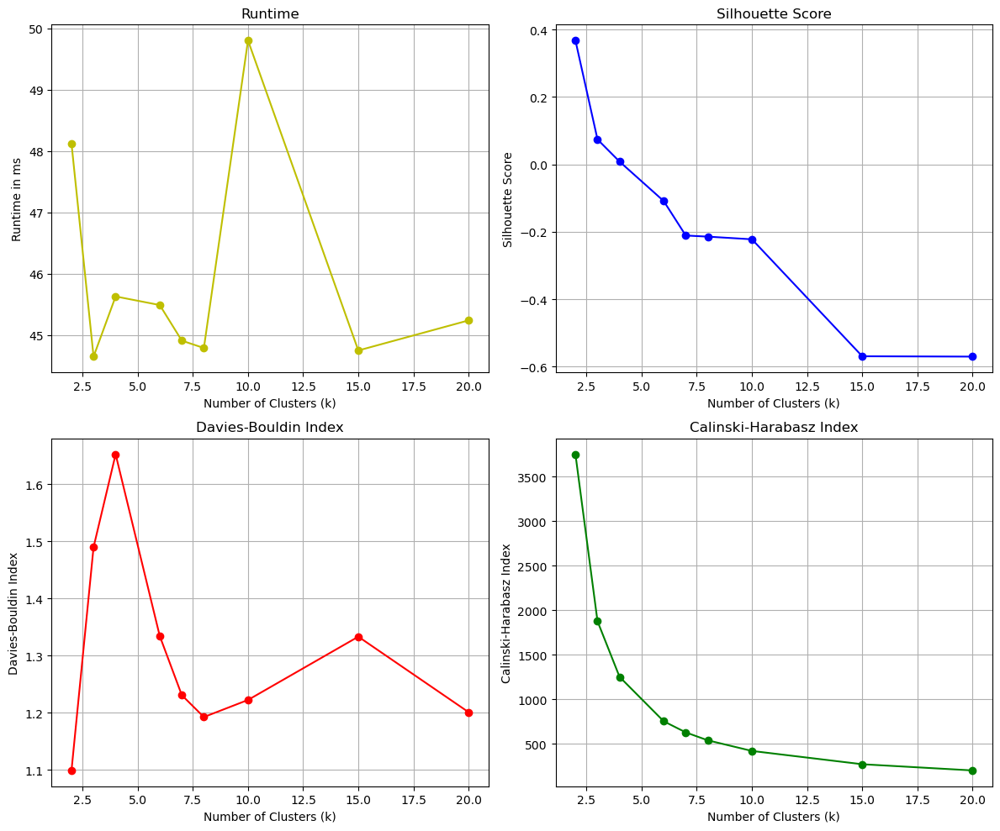

Evaluating with linkage average
2 average
3 average
4 average
6 average
7 average
8 average
10 average
15 average
20 average


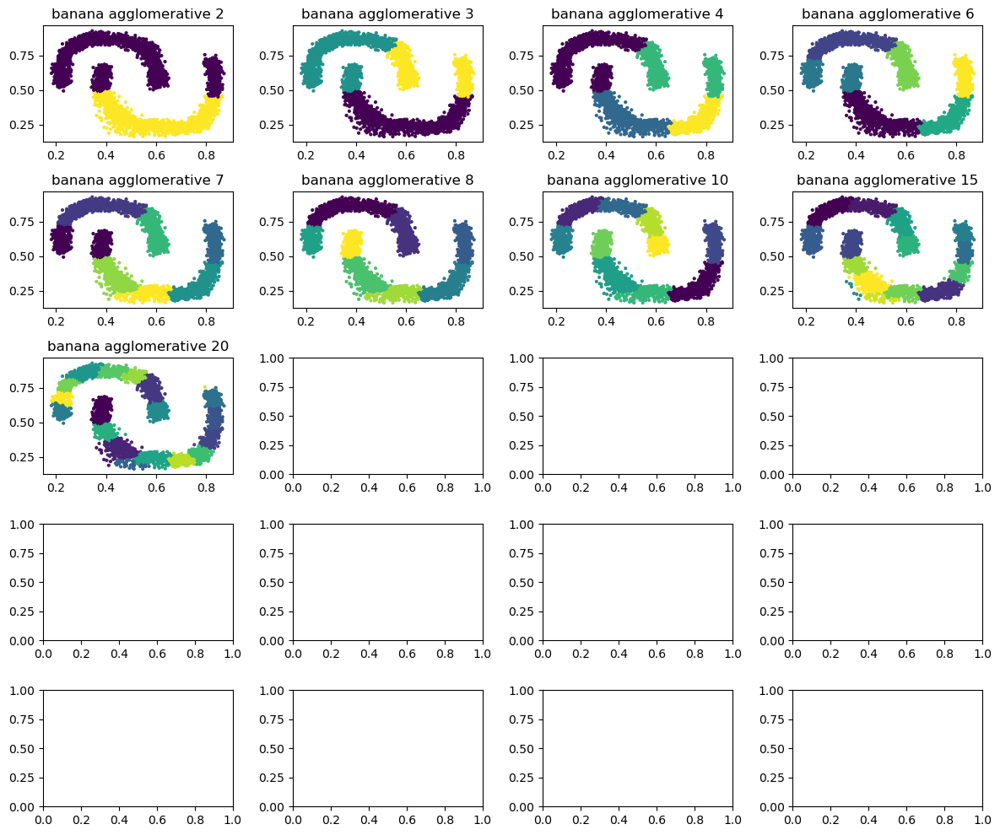

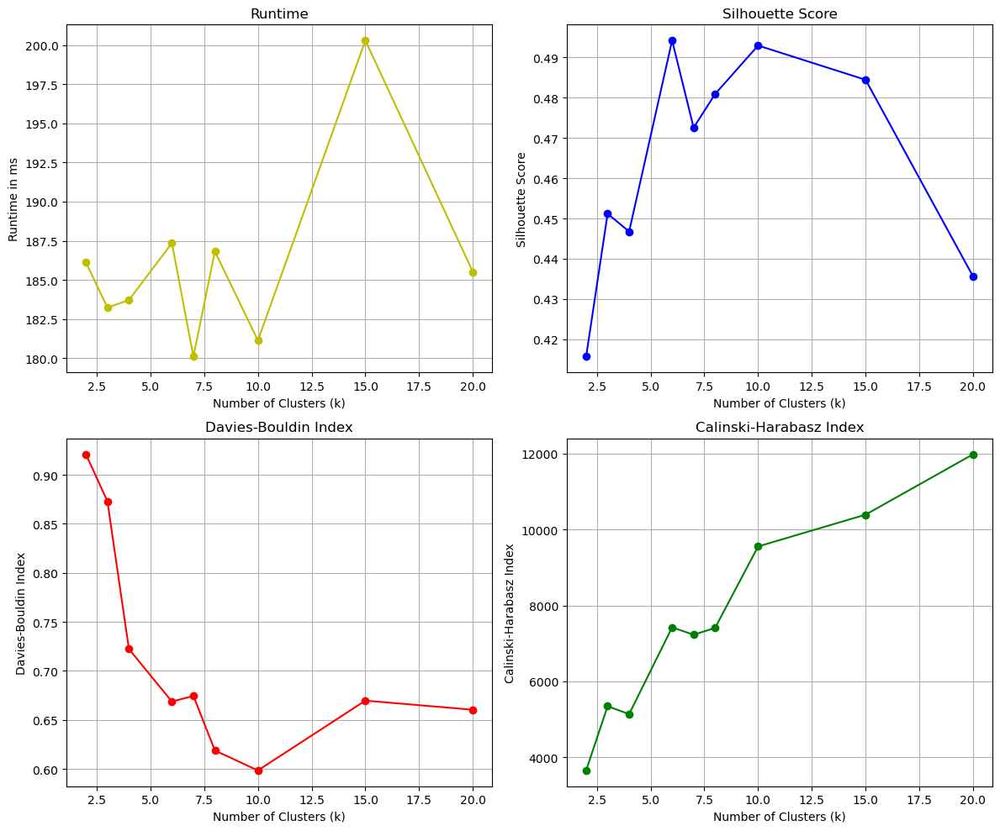

Evaluating with linkage complete
2 complete
3 complete
4 complete
6 complete
7 complete
8 complete
10 complete
15 complete
20 complete


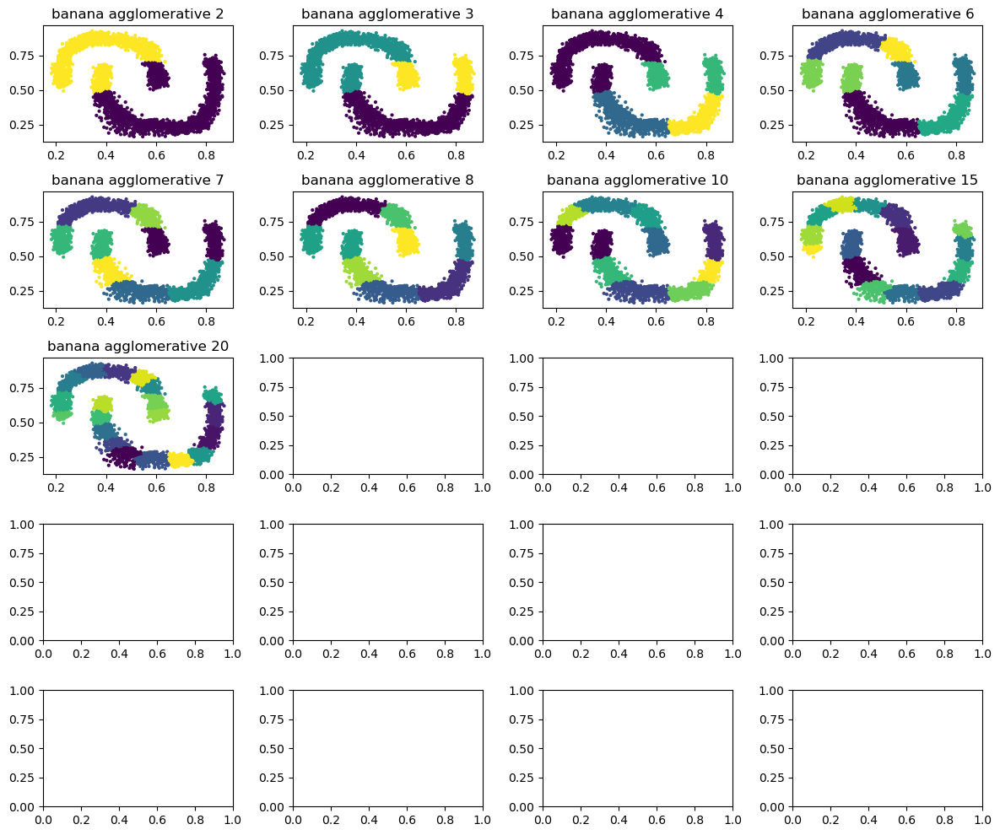

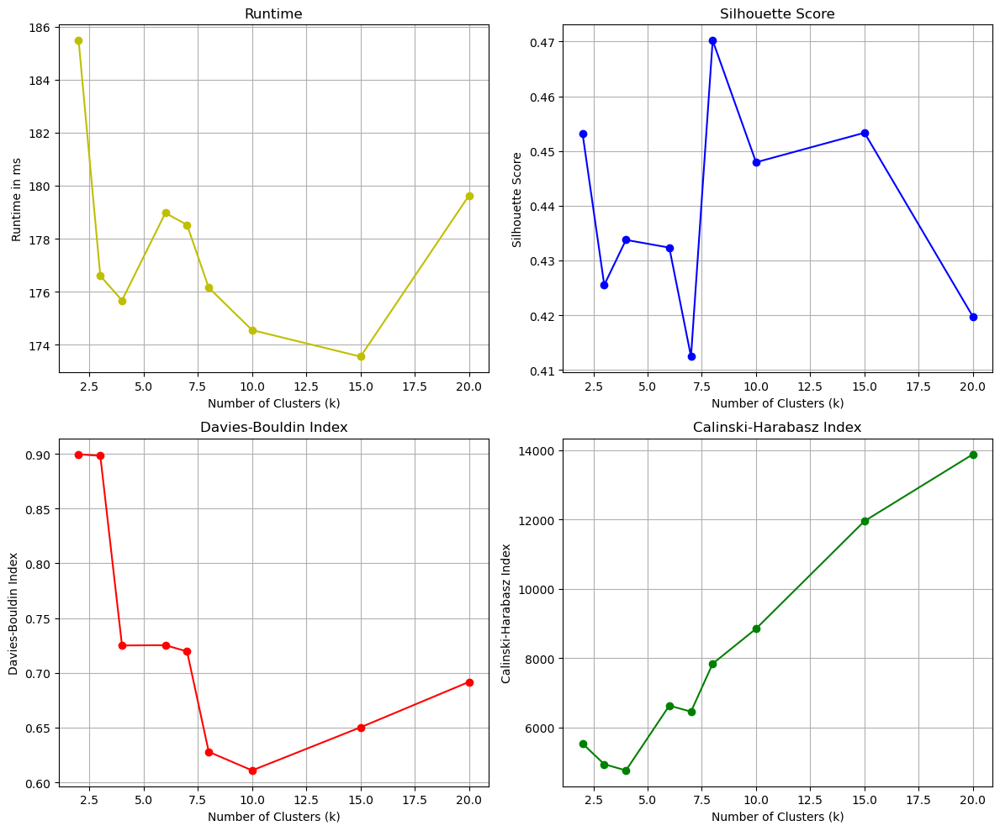

Evaluating with linkage ward
2 ward
3 ward
4 ward
6 ward
7 ward
8 ward
10 ward
15 ward
20 ward


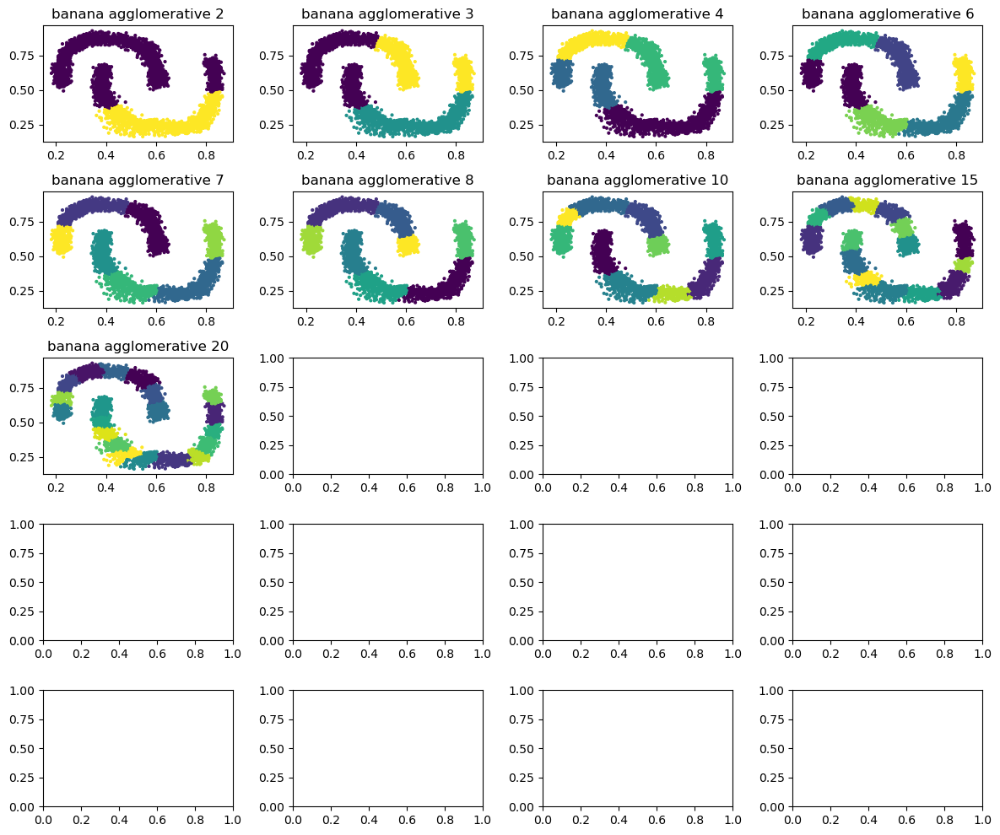

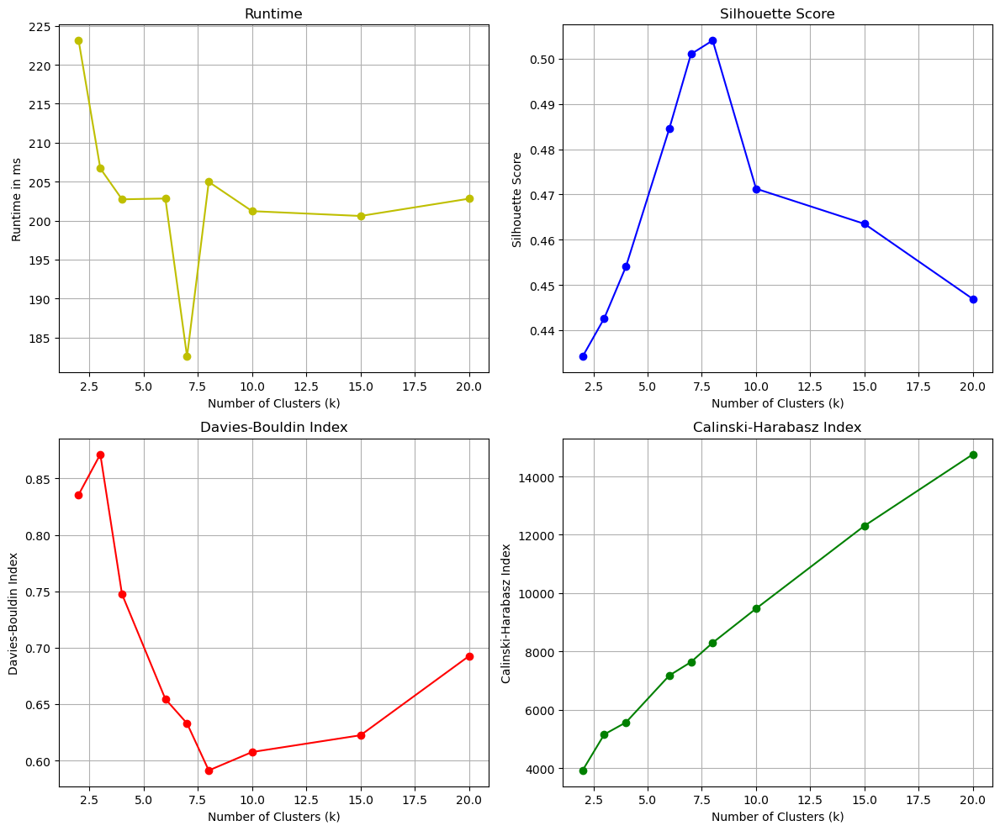

In [15]:
ks = [2,3,4,6,7,8,10,15,20]
print("Evaluating with linkage single")
evaluate_clustering("banana", "agglomerative", ks, 'single')
print("Evaluating with linkage average")
evaluate_clustering("banana", "agglomerative", ks, 'average')
print("Evaluating with linkage complete")
evaluate_clustering("banana", "agglomerative", ks, 'complete')
print("Evaluating with linkage ward")
evaluate_clustering("banana", "agglomerative", ks, 'ward')

#### Banana with distance

Evaluation with d
Linkage:  ward


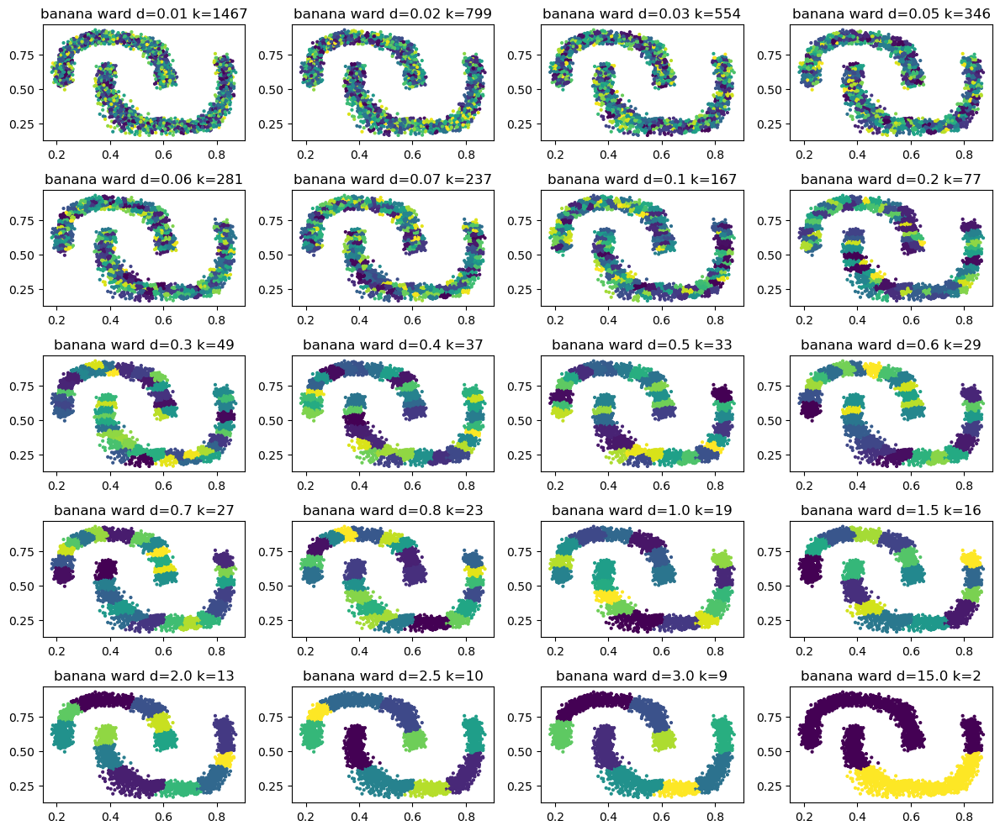

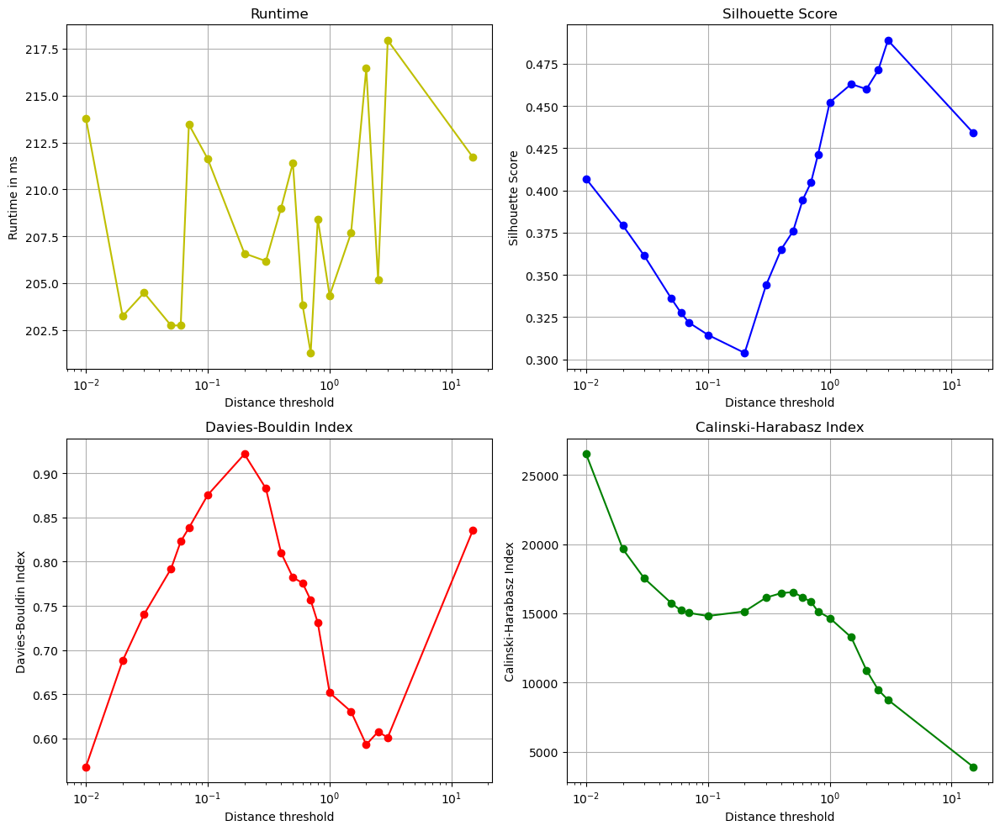

Linkage:  complete
Only 1 cluster or as many clusters as points for this model with distance:  1.0
Only 1 cluster or as many clusters as points for this model with distance:  1.5
Only 1 cluster or as many clusters as points for this model with distance:  2.0
Only 1 cluster or as many clusters as points for this model with distance:  2.5
Only 1 cluster or as many clusters as points for this model with distance:  3.0
Only 1 cluster or as many clusters as points for this model with distance:  15.0


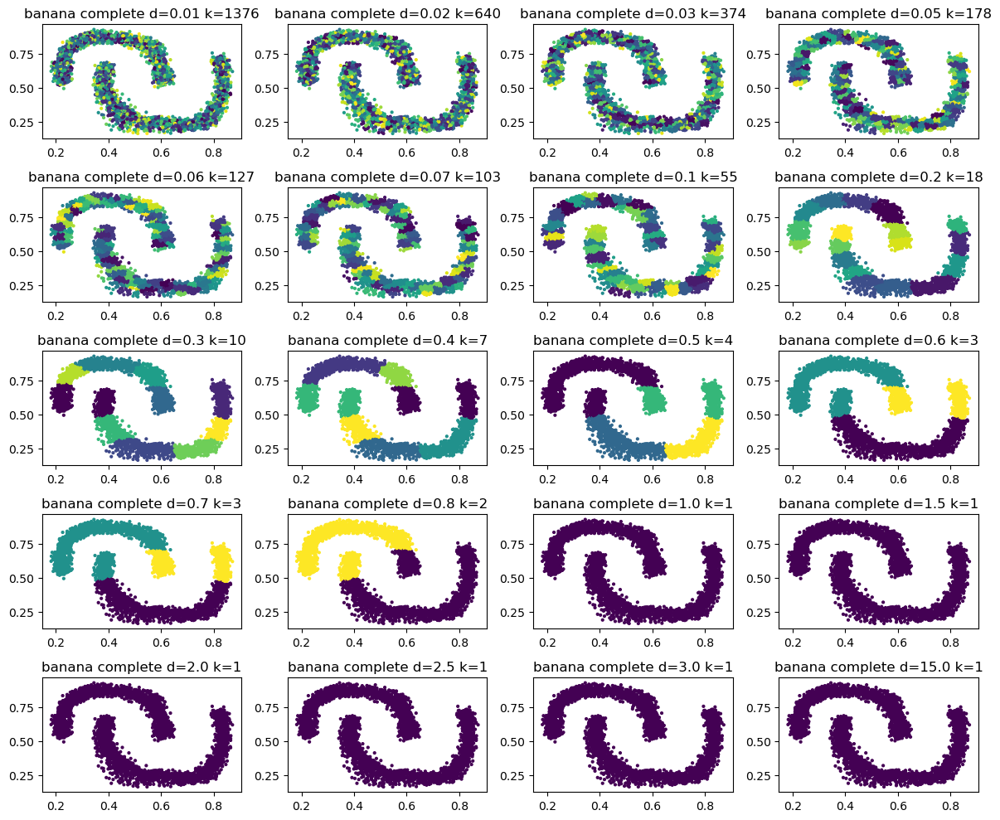

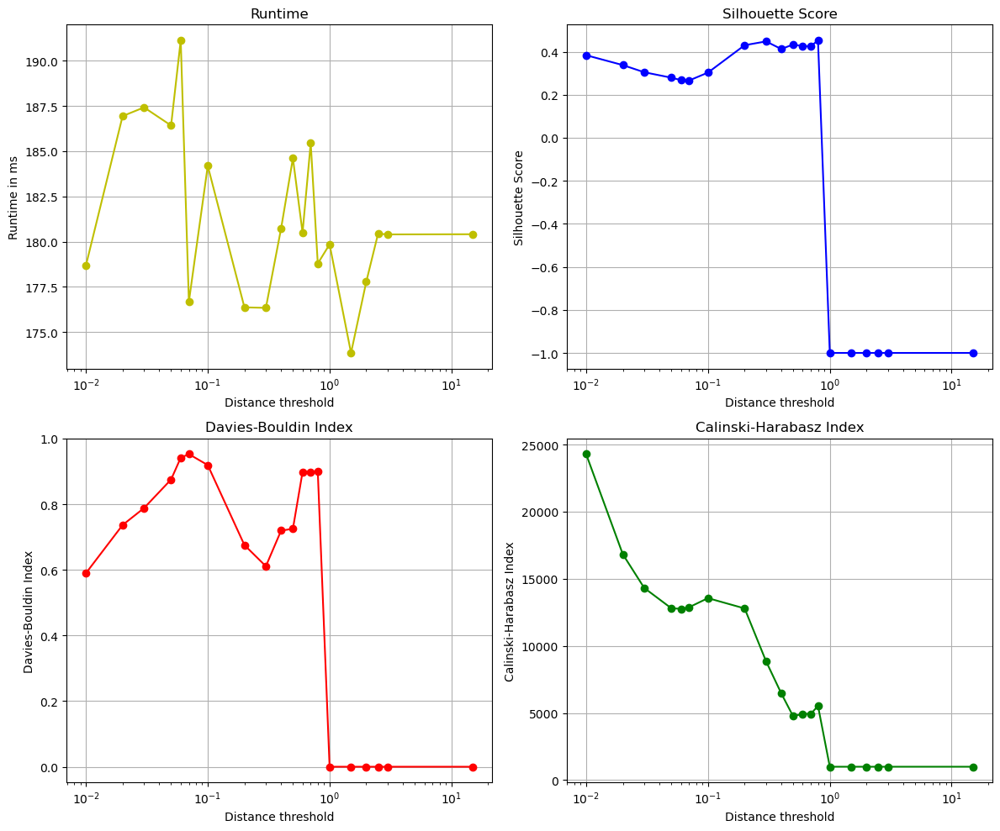

Linkage:  average
Only 1 cluster or as many clusters as points for this model with distance:  0.5
Only 1 cluster or as many clusters as points for this model with distance:  0.6
Only 1 cluster or as many clusters as points for this model with distance:  0.7
Only 1 cluster or as many clusters as points for this model with distance:  0.8
Only 1 cluster or as many clusters as points for this model with distance:  1.0
Only 1 cluster or as many clusters as points for this model with distance:  1.5
Only 1 cluster or as many clusters as points for this model with distance:  2.0
Only 1 cluster or as many clusters as points for this model with distance:  2.5
Only 1 cluster or as many clusters as points for this model with distance:  3.0
Only 1 cluster or as many clusters as points for this model with distance:  15.0


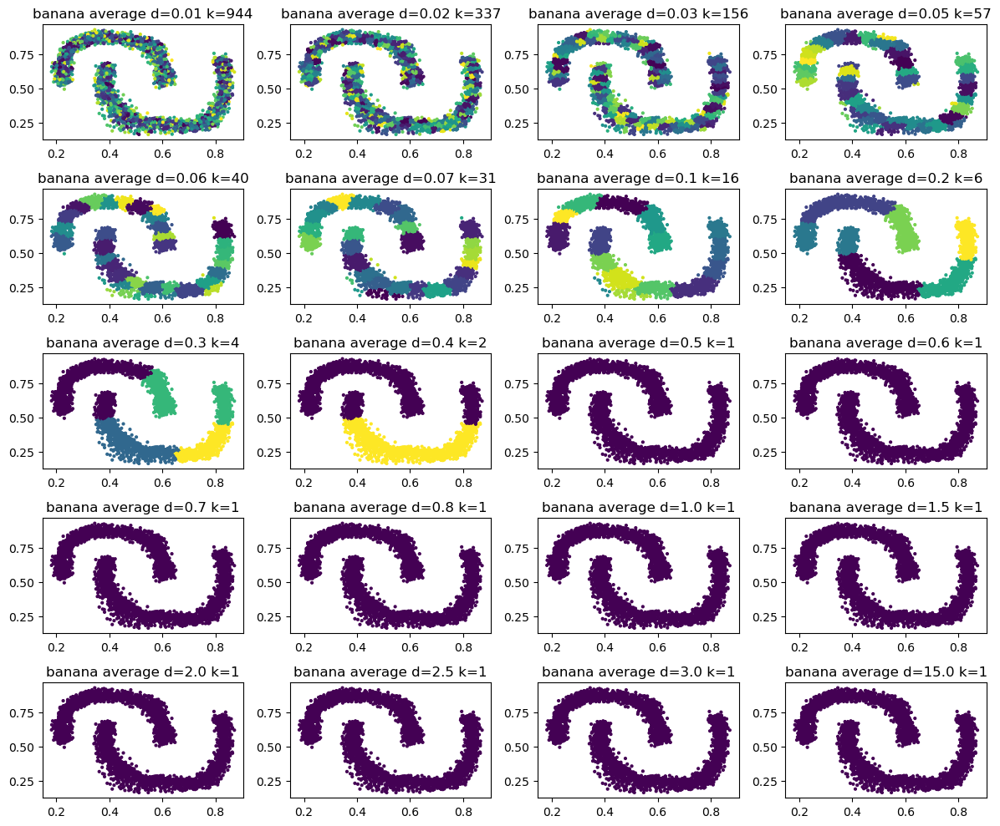

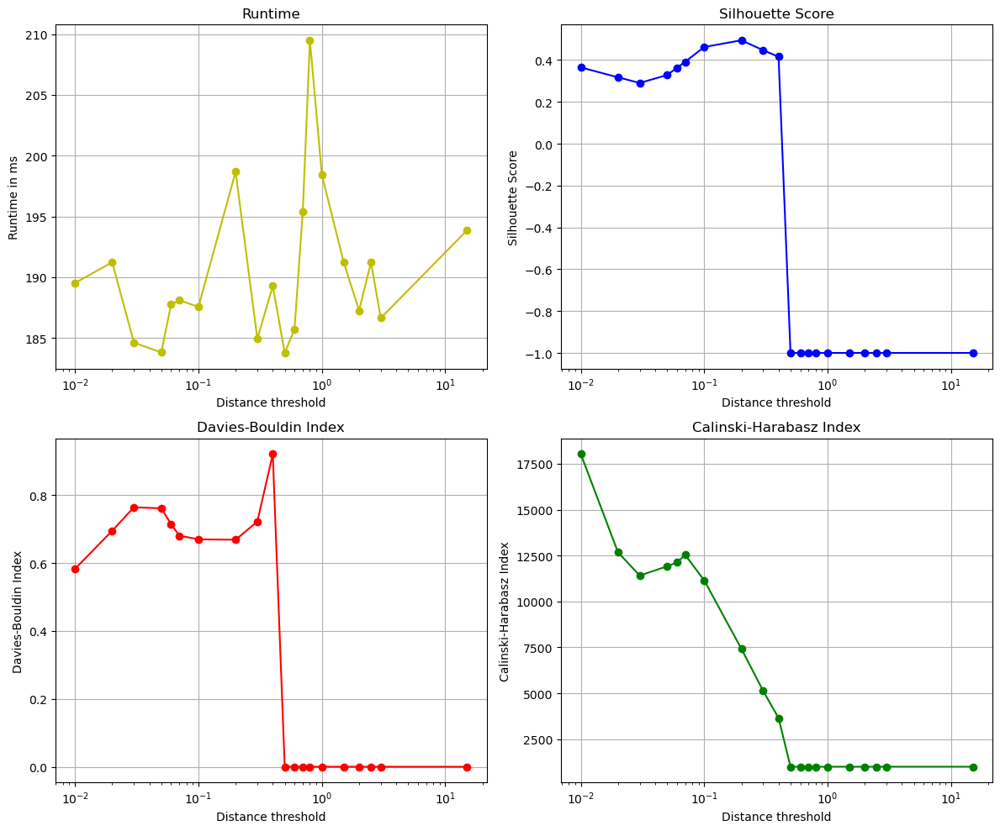

Linkage:  single
Only 1 cluster or as many clusters as points for this model with distance:  0.1
Only 1 cluster or as many clusters as points for this model with distance:  0.2
Only 1 cluster or as many clusters as points for this model with distance:  0.3
Only 1 cluster or as many clusters as points for this model with distance:  0.4
Only 1 cluster or as many clusters as points for this model with distance:  0.5
Only 1 cluster or as many clusters as points for this model with distance:  0.6
Only 1 cluster or as many clusters as points for this model with distance:  0.7
Only 1 cluster or as many clusters as points for this model with distance:  0.8
Only 1 cluster or as many clusters as points for this model with distance:  1.0
Only 1 cluster or as many clusters as points for this model with distance:  1.5
Only 1 cluster or as many clusters as points for this model with distance:  2.0
Only 1 cluster or as many clusters as points for this model with distance:  2.5
Only 1 cluster or as ma

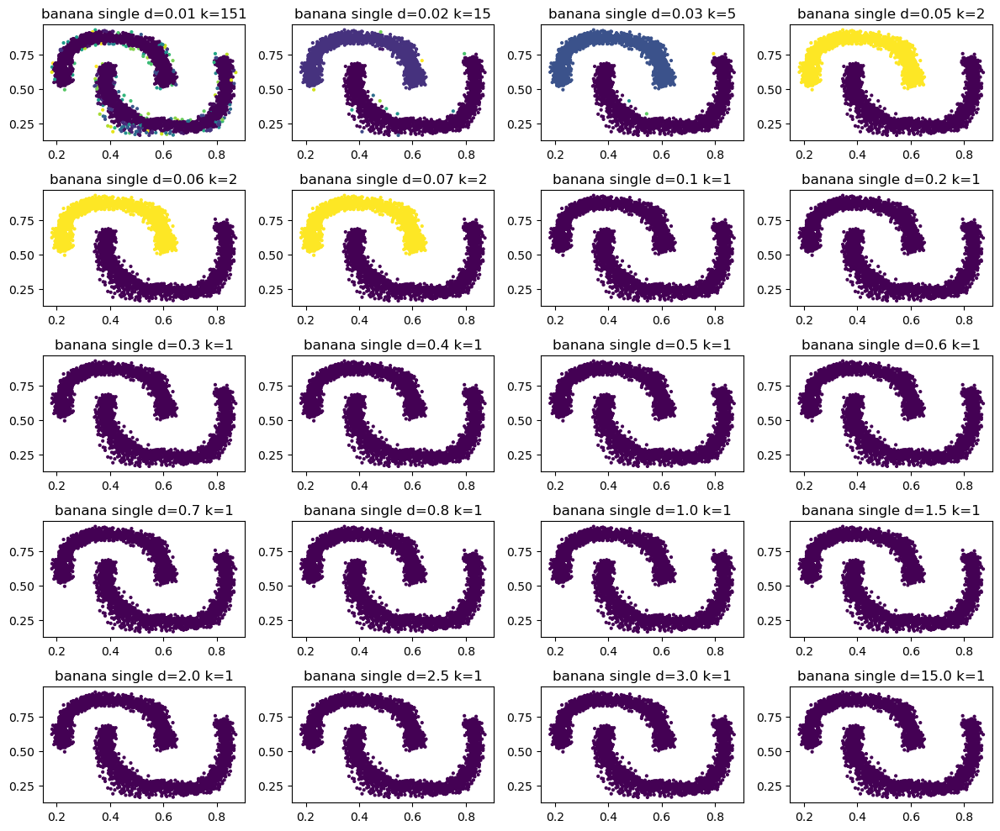

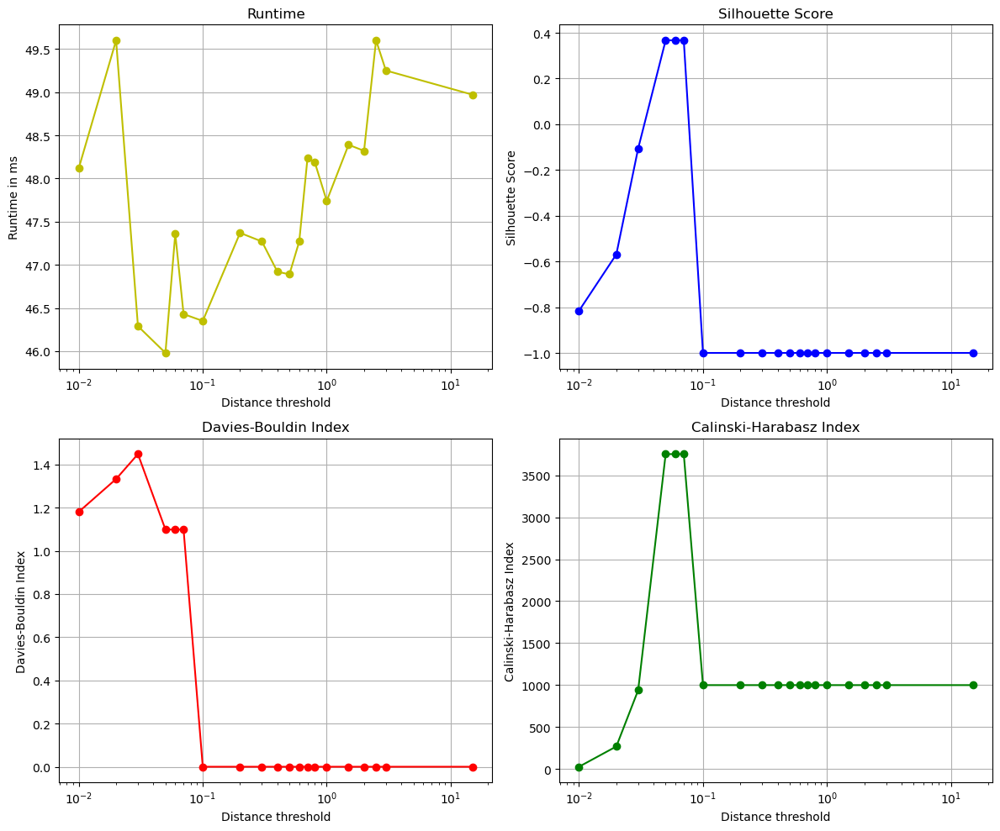

In [16]:
print("Evaluation with d")
dists=[0.01, 0.02, 0.03, 0.05, 0.06, 0.07, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1., 1.5, 2., 2.5, 3., 15.]
linkage = ['ward', 'complete', 'average', 'single']
for l in linkage:
    print("Linkage: ", l)
    evaluate_clustering("banana", "agglomerative", ks, l, use_distance_threshold=True, dists=dists)

#### Zelnik1 with k

Evaluating with linkage single
2 single
3 single
4 single
6 single
7 single
8 single
10 single
15 single
20 single


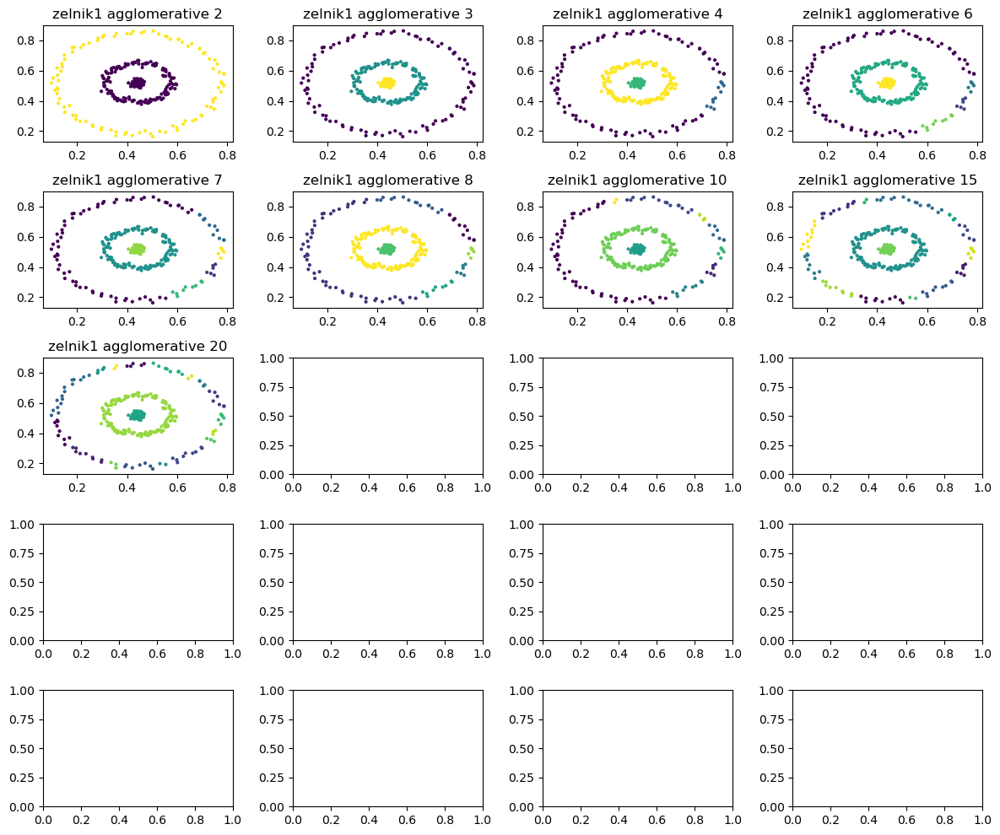

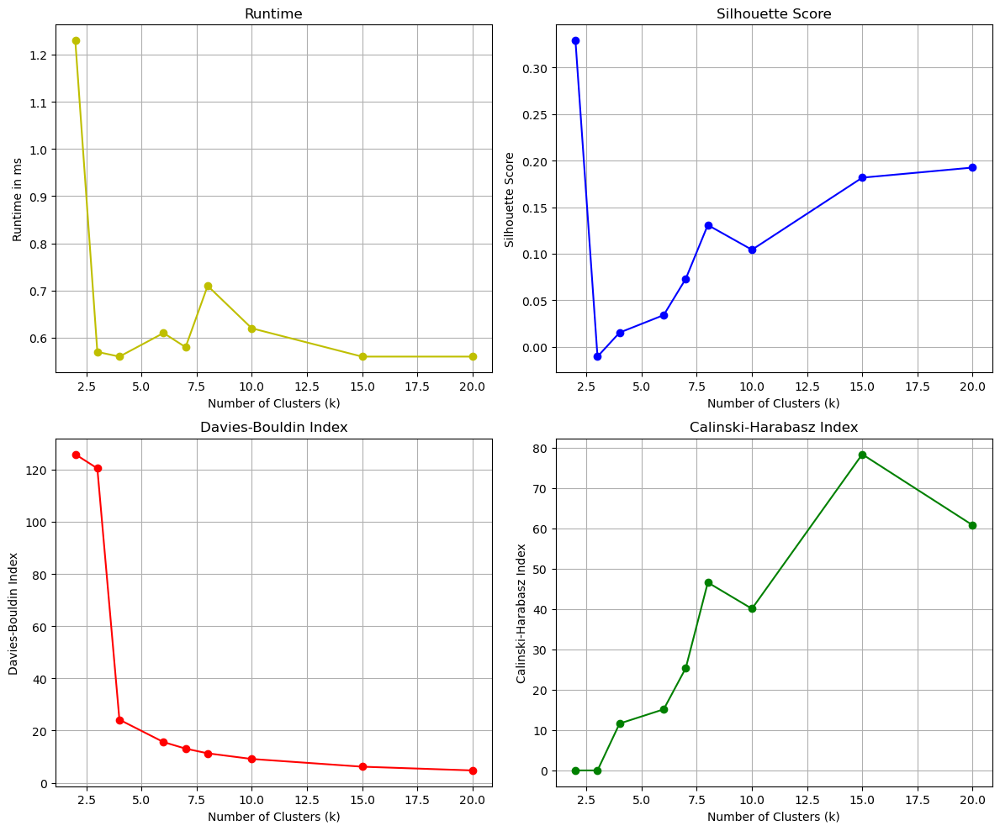

Evaluating with linkage average
2 average
3 average
4 average
6 average
7 average
8 average
10 average
15 average
20 average


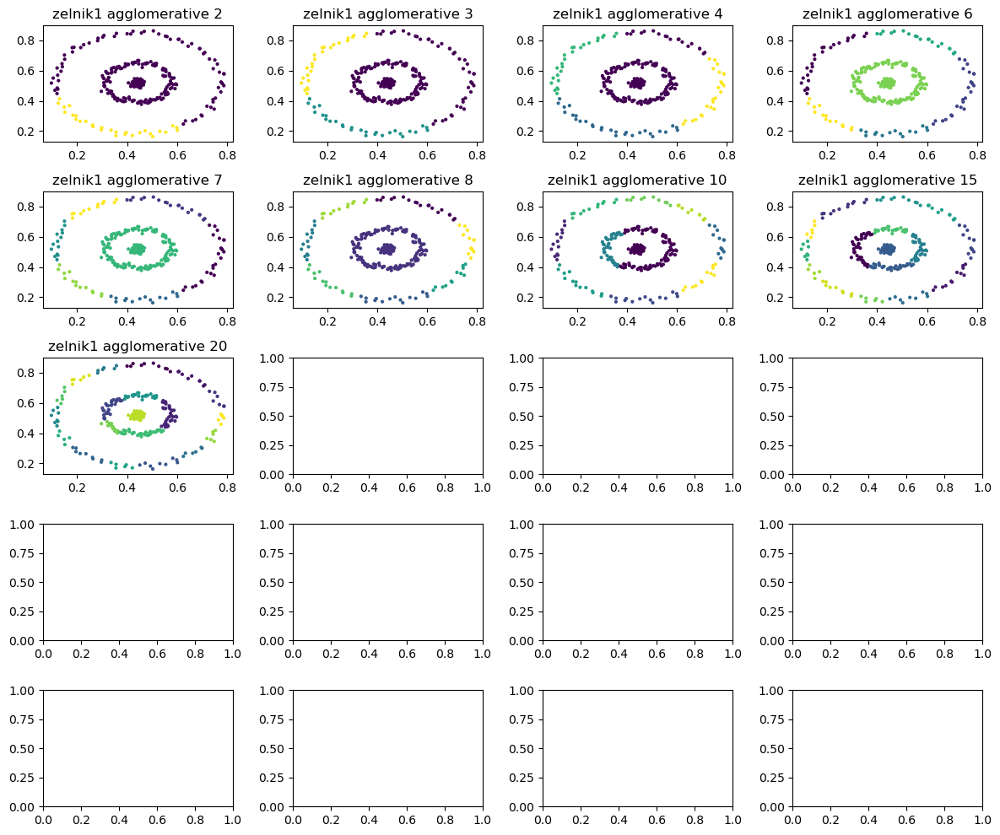

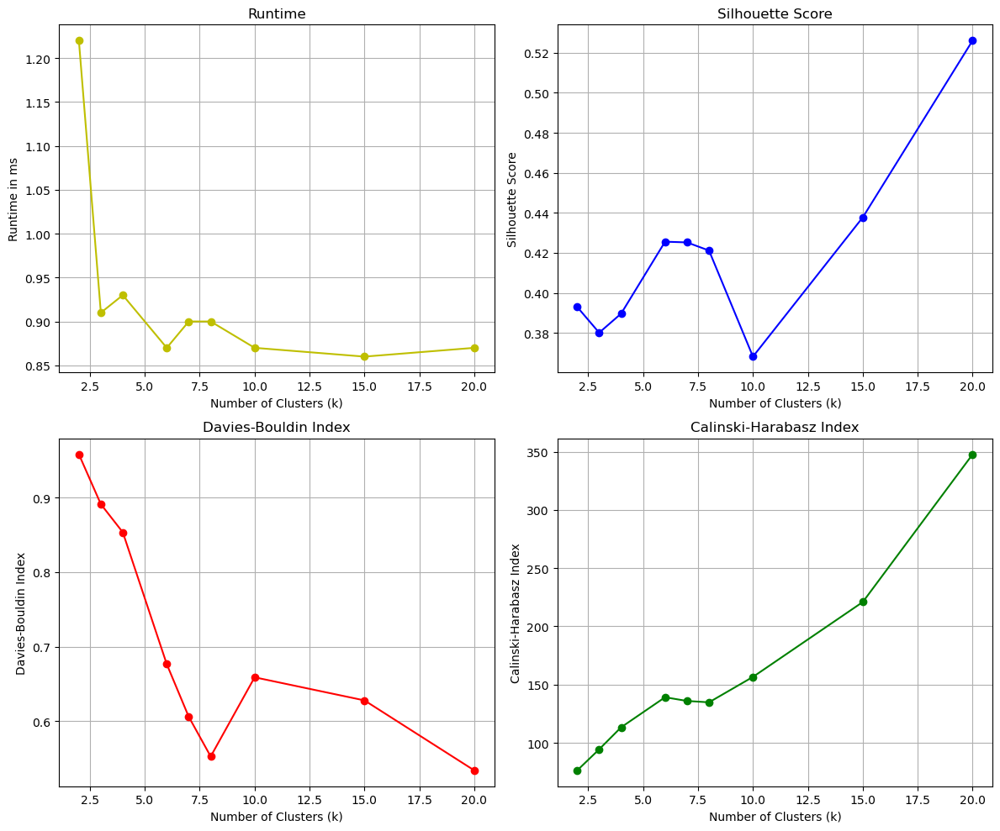

Evaluating with linkage complete
2 complete
3 complete
4 complete
6 complete
7 complete
8 complete
10 complete
15 complete
20 complete


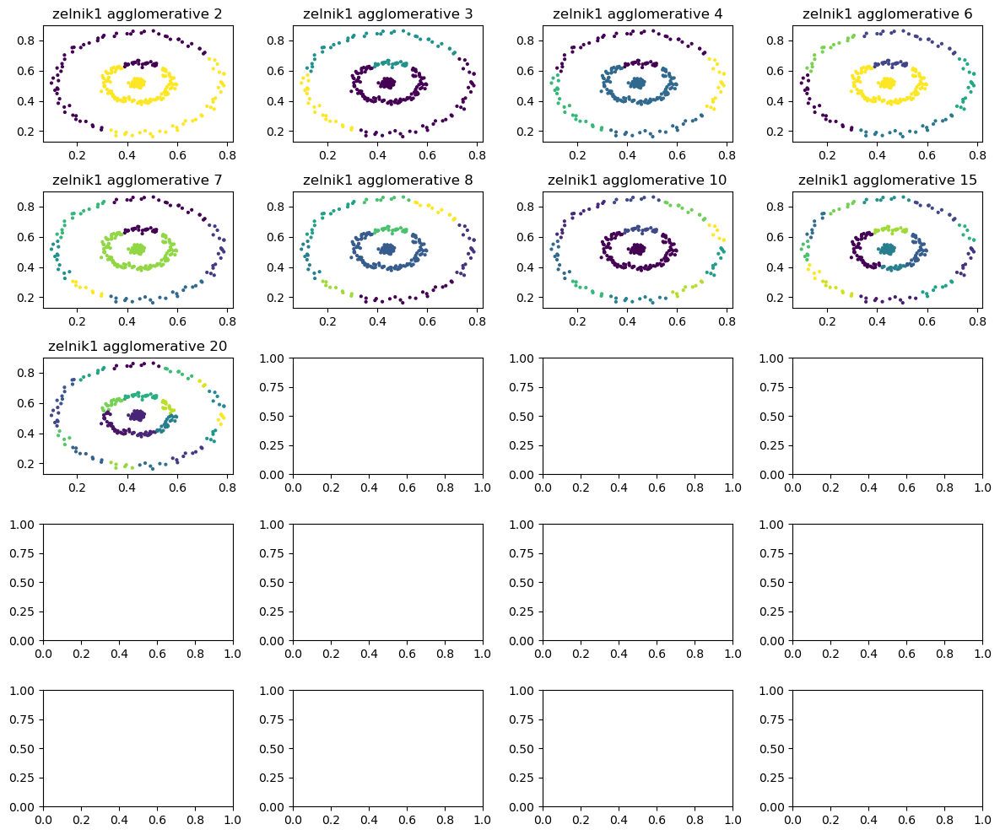

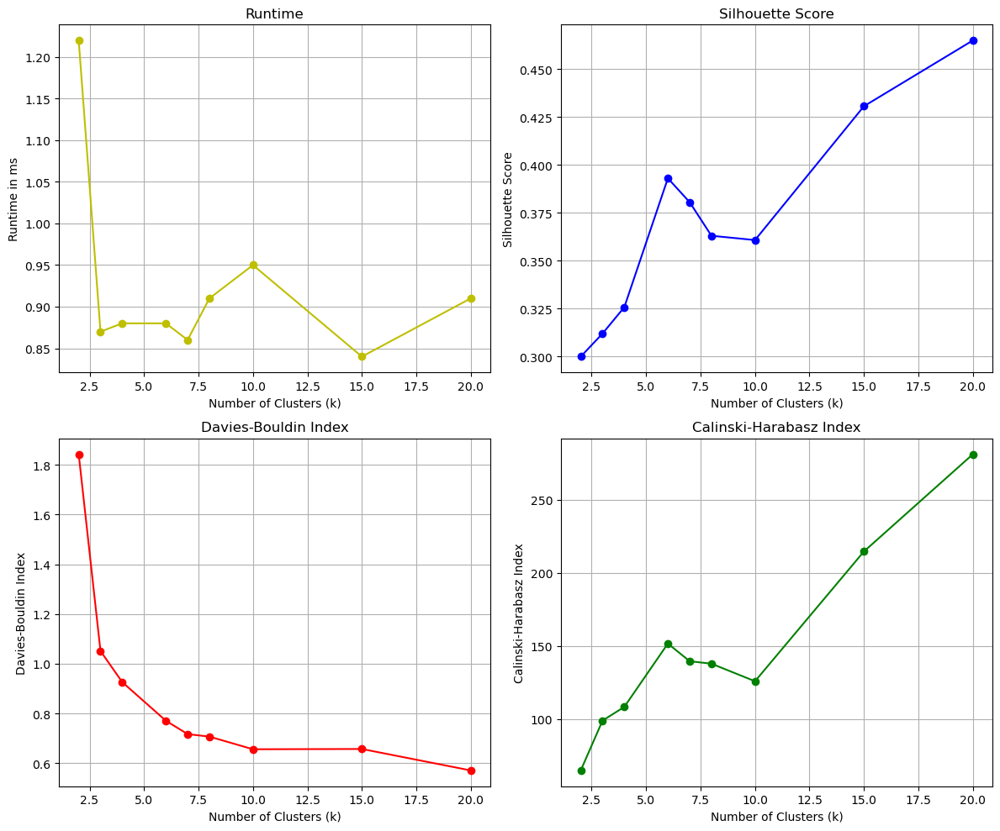

Evaluating with linkage ward
2 ward
3 ward
4 ward
6 ward
7 ward
8 ward
10 ward
15 ward
20 ward


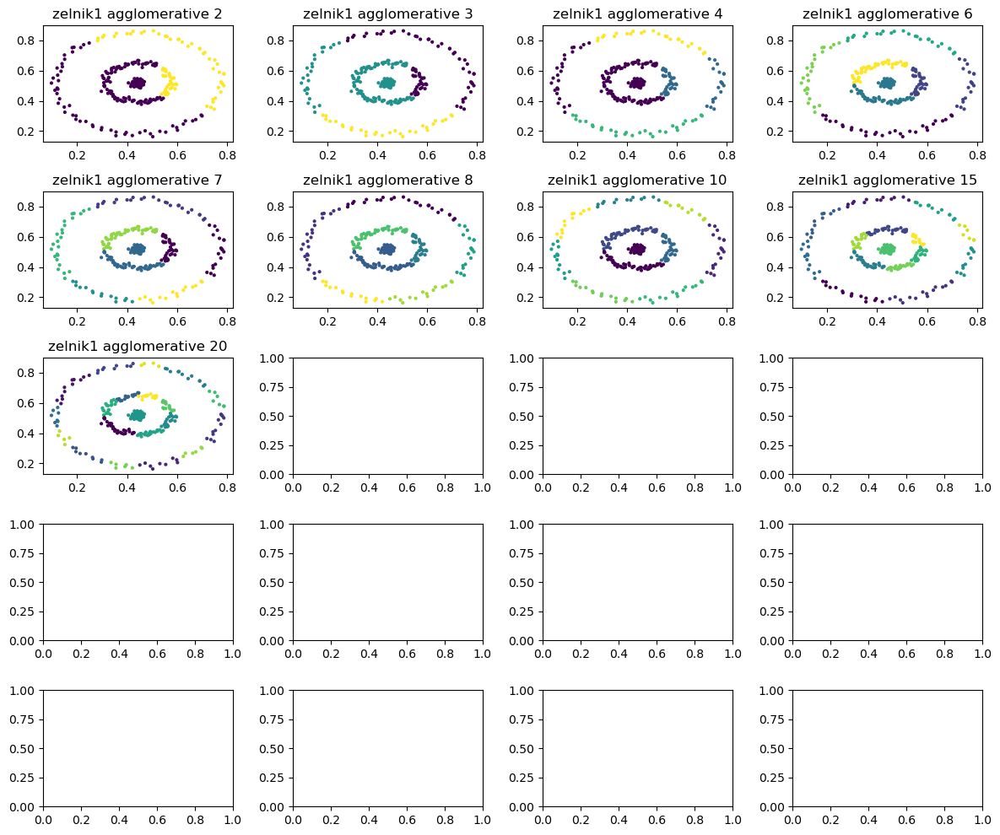

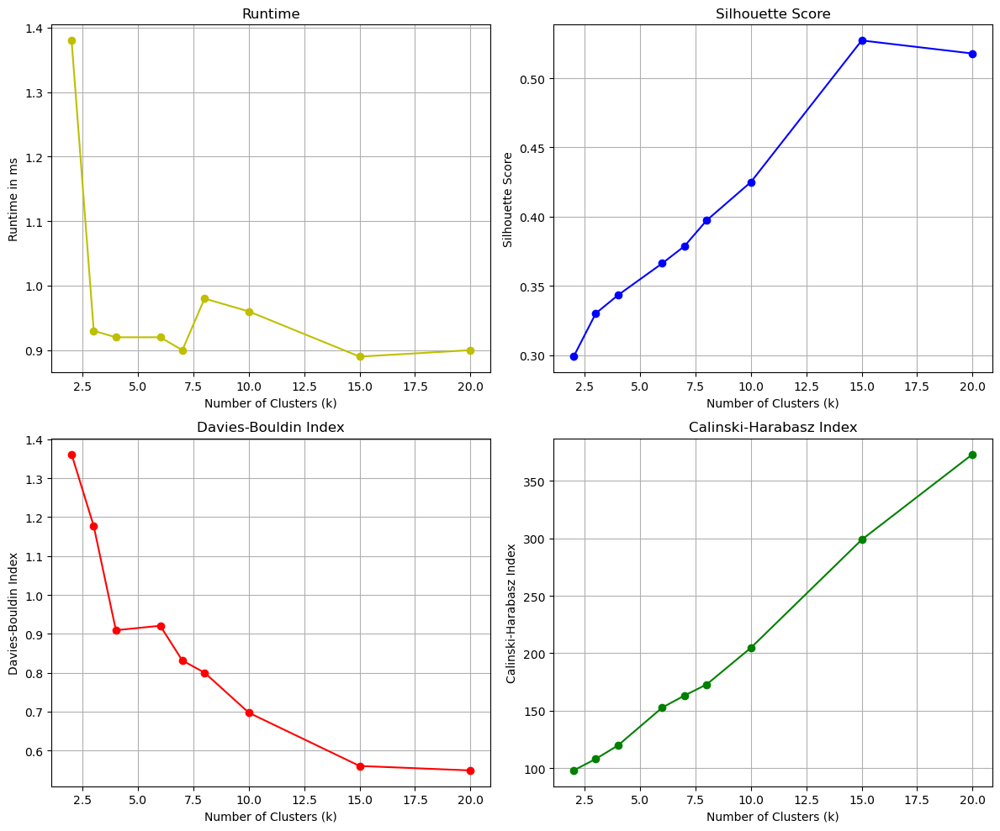

In [17]:
ks = [2,3,4,6,7,8,10,15,20]
print("Evaluating with linkage single")
evaluate_clustering("zelnik1", "agglomerative", ks, 'single')
print("Evaluating with linkage average")
evaluate_clustering("zelnik1", "agglomerative", ks, 'average')
print("Evaluating with linkage complete")
evaluate_clustering("zelnik1", "agglomerative", ks, 'complete')
print("Evaluating with linkage ward")
evaluate_clustering("zelnik1", "agglomerative", ks, 'ward')

#### Zelnik1 with d

Evaluation with d
Linkage:  ward
Only 1 cluster or as many clusters as points for this model with distance:  3.0


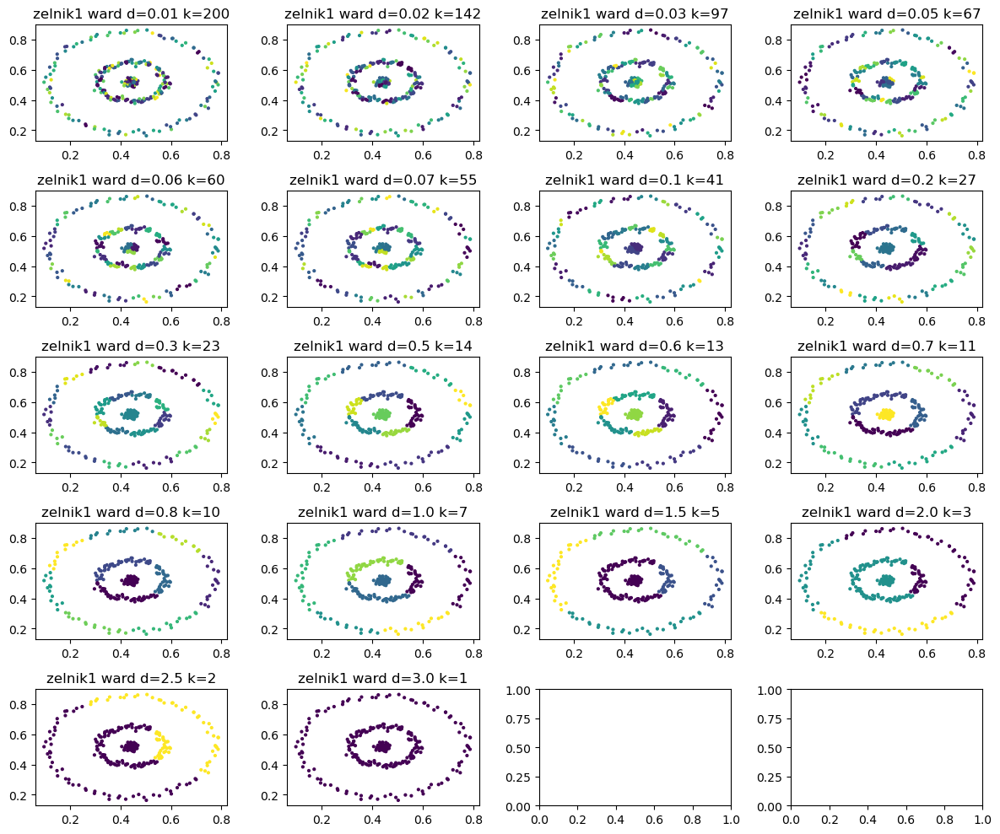

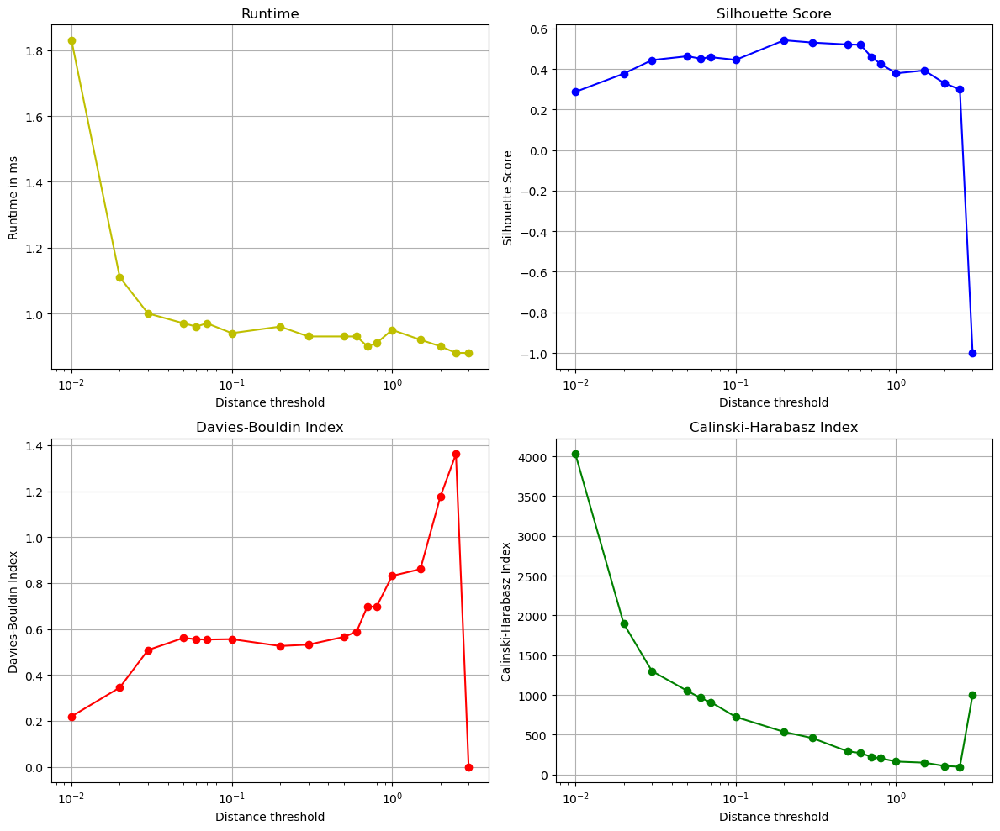

Linkage:  complete
Only 1 cluster or as many clusters as points for this model with distance:  0.8
Only 1 cluster or as many clusters as points for this model with distance:  1.0
Only 1 cluster or as many clusters as points for this model with distance:  1.5
Only 1 cluster or as many clusters as points for this model with distance:  2.0
Only 1 cluster or as many clusters as points for this model with distance:  2.5
Only 1 cluster or as many clusters as points for this model with distance:  3.0


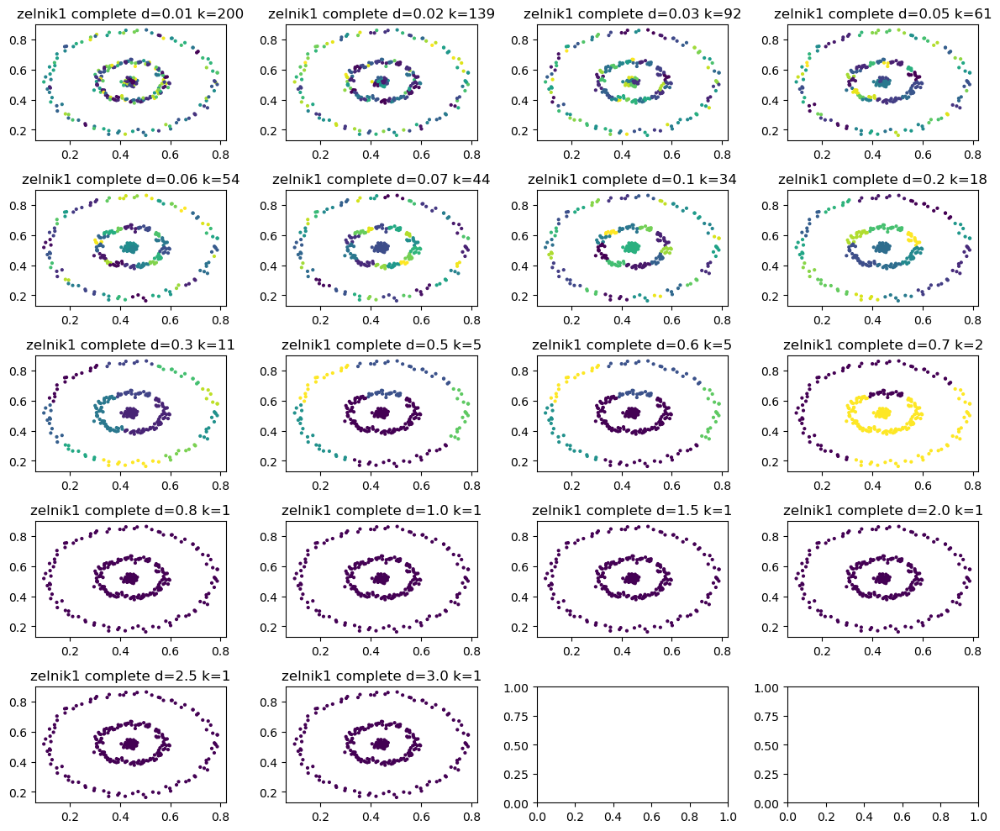

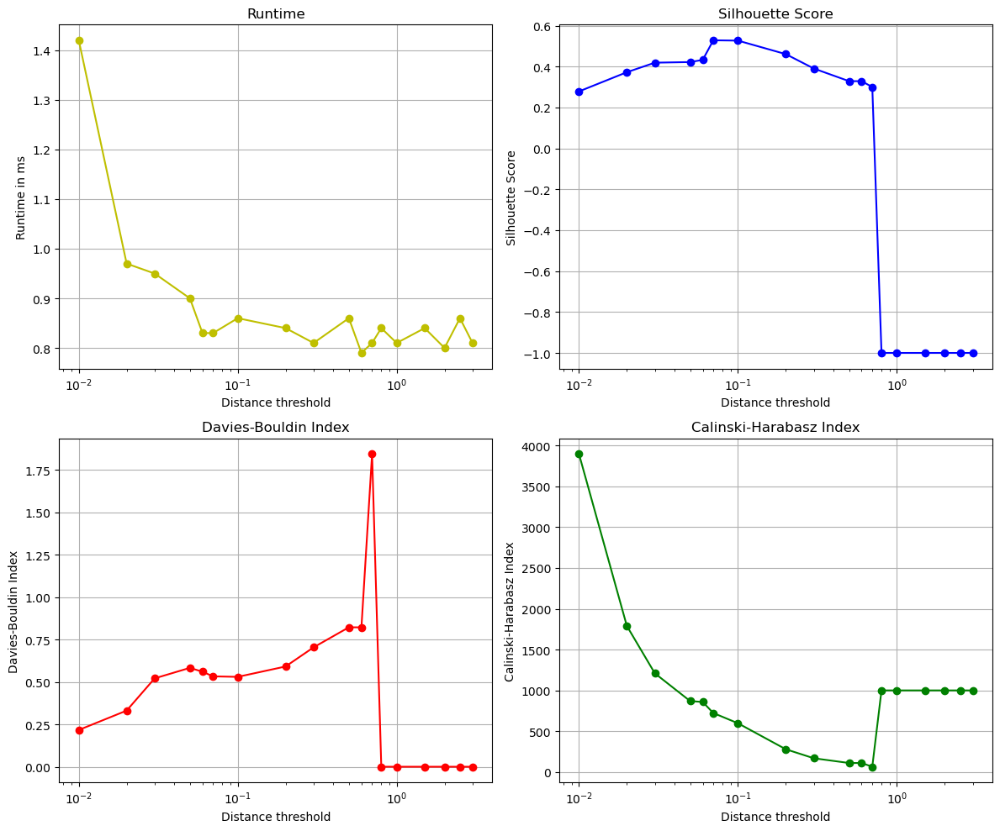

Linkage:  average
Only 1 cluster or as many clusters as points for this model with distance:  0.5
Only 1 cluster or as many clusters as points for this model with distance:  0.6
Only 1 cluster or as many clusters as points for this model with distance:  0.7
Only 1 cluster or as many clusters as points for this model with distance:  0.8
Only 1 cluster or as many clusters as points for this model with distance:  1.0
Only 1 cluster or as many clusters as points for this model with distance:  1.5
Only 1 cluster or as many clusters as points for this model with distance:  2.0
Only 1 cluster or as many clusters as points for this model with distance:  2.5
Only 1 cluster or as many clusters as points for this model with distance:  3.0


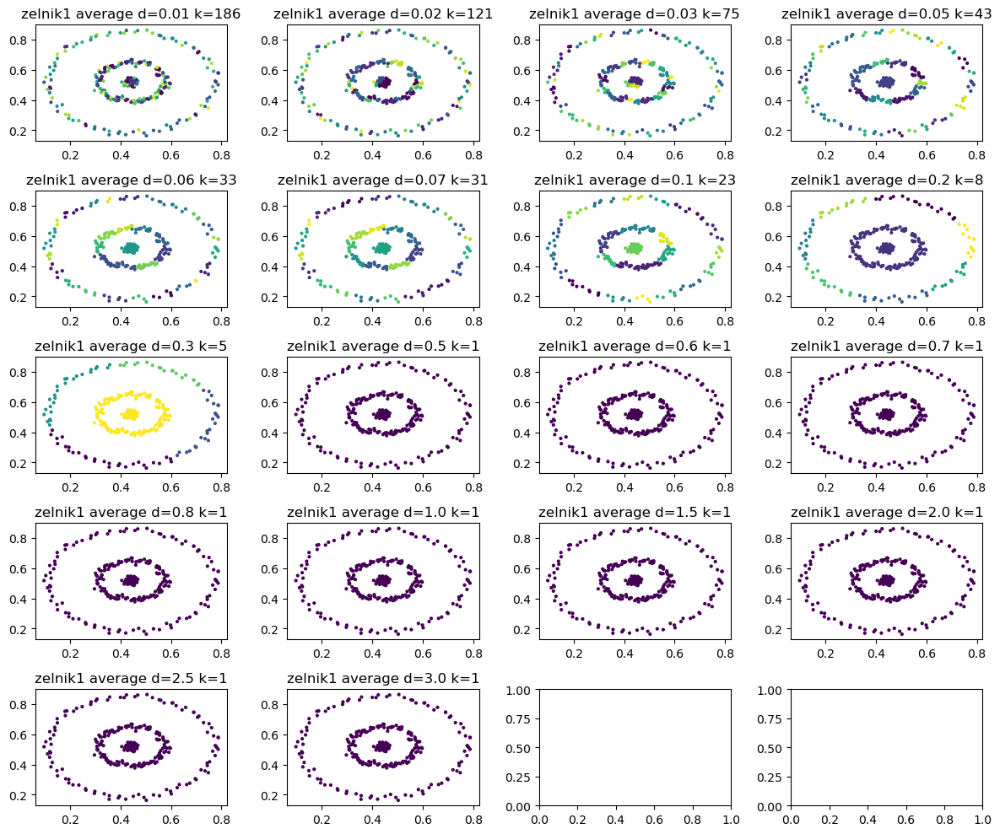

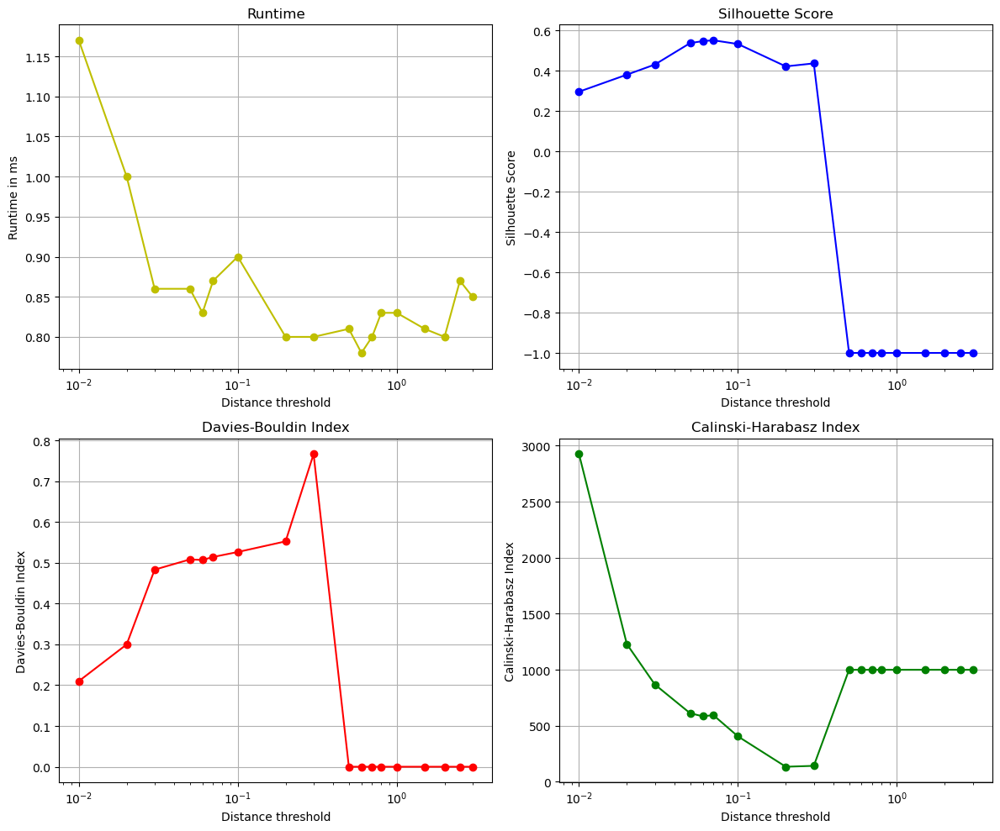

Linkage:  single
Only 1 cluster or as many clusters as points for this model with distance:  0.2
Only 1 cluster or as many clusters as points for this model with distance:  0.3
Only 1 cluster or as many clusters as points for this model with distance:  0.5
Only 1 cluster or as many clusters as points for this model with distance:  0.6
Only 1 cluster or as many clusters as points for this model with distance:  0.7
Only 1 cluster or as many clusters as points for this model with distance:  0.8
Only 1 cluster or as many clusters as points for this model with distance:  1.0
Only 1 cluster or as many clusters as points for this model with distance:  1.5
Only 1 cluster or as many clusters as points for this model with distance:  2.0
Only 1 cluster or as many clusters as points for this model with distance:  2.5
Only 1 cluster or as many clusters as points for this model with distance:  3.0


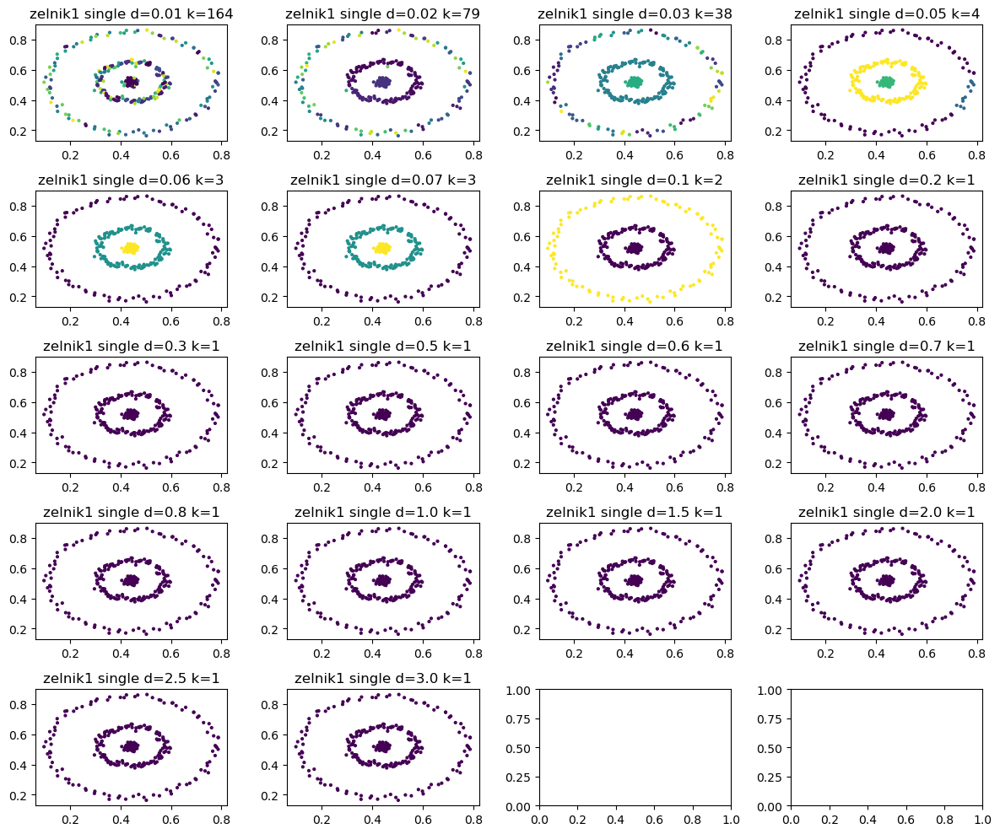

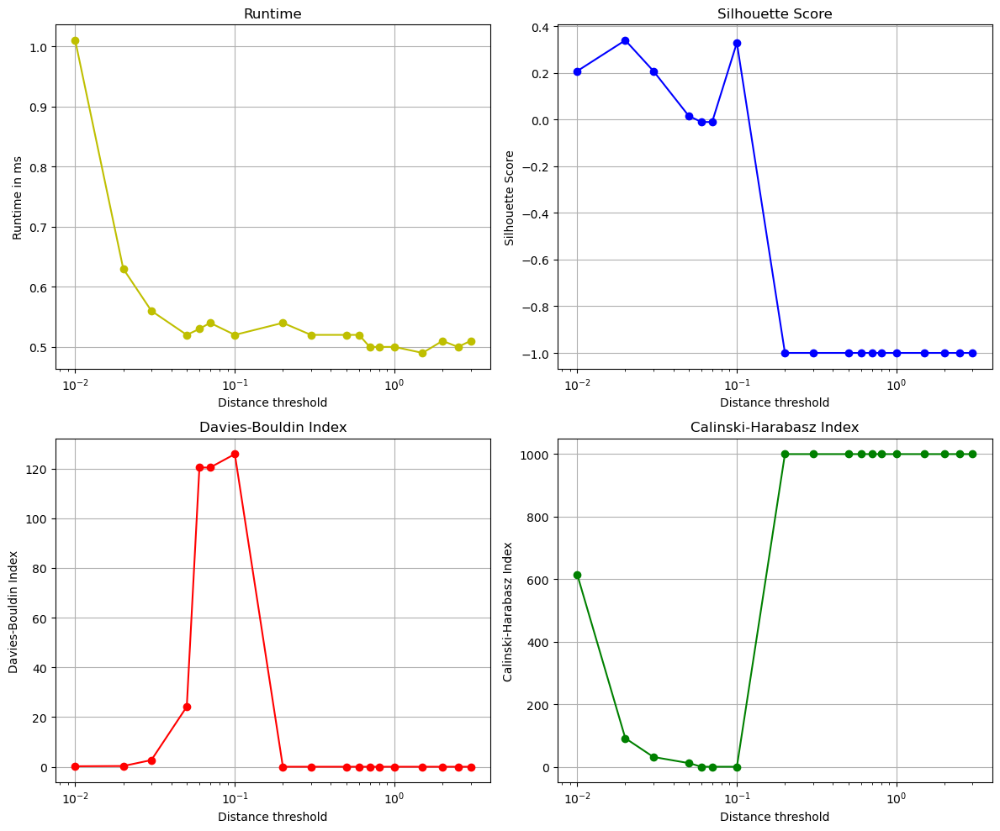

In [18]:
print("Evaluation with d")
dists=[0.01, 0.02, 0.03, 0.05, 0.06, 0.07, 0.1, 0.2, 0.3, 0.5, 0.6, 0.7, 0.8, 1., 1.5, 2., 2.5, 3.,]
linkage = ['ward', 'complete', 'average', 'single']
for l in linkage:
    print("Linkage: ", l)
    evaluate_clustering("zelnik1", "agglomerative", ks, l, use_distance_threshold=True, dists=dists)

Evaluating with linkage single
2 single
3 single
4 single
6 single
7 single
8 single
10 single
15 single
20 single


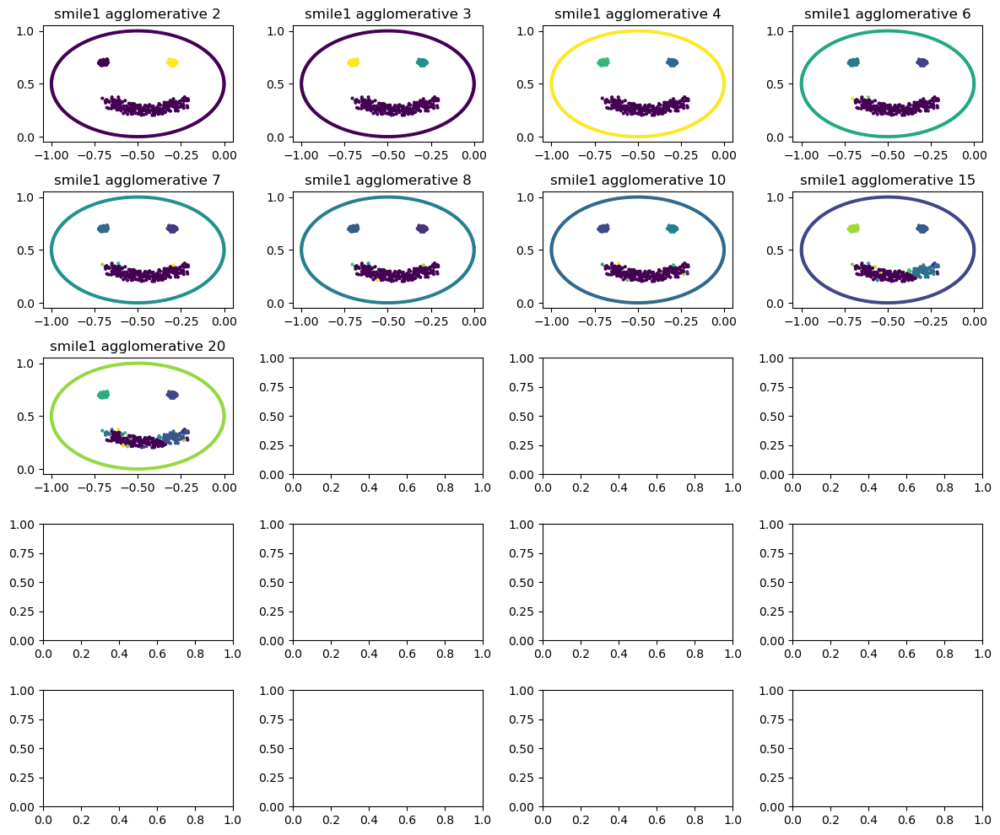

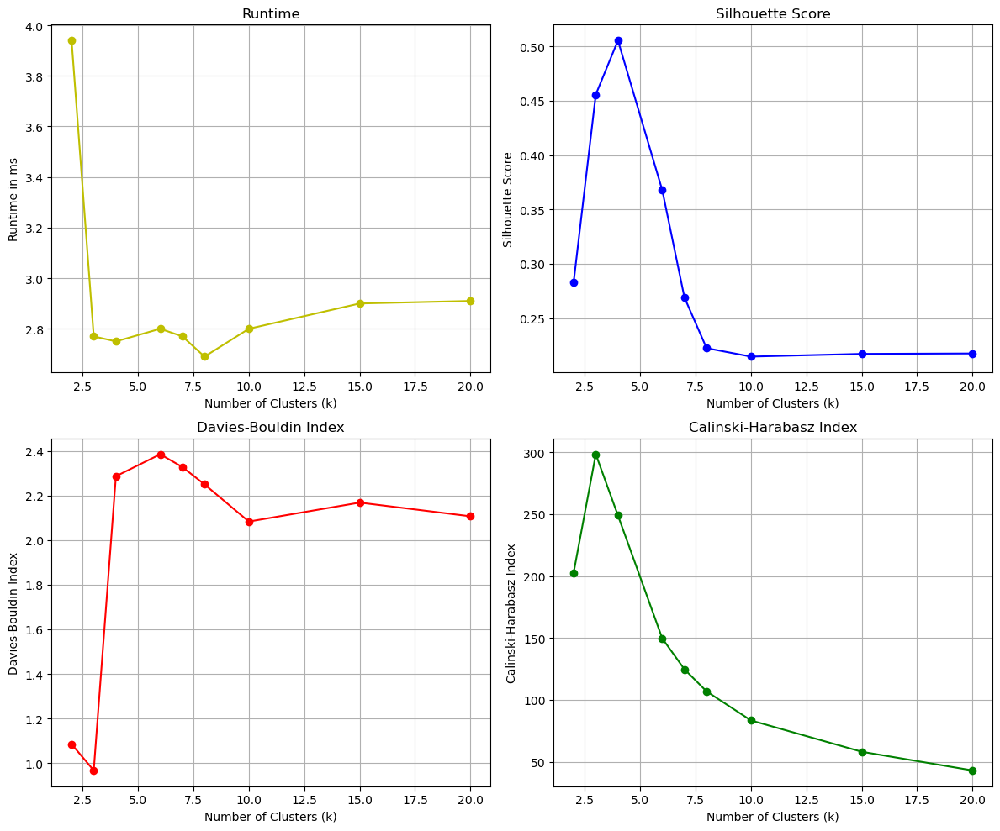

Evaluating with linkage average
2 average
3 average
4 average
6 average
7 average
8 average
10 average
15 average
20 average


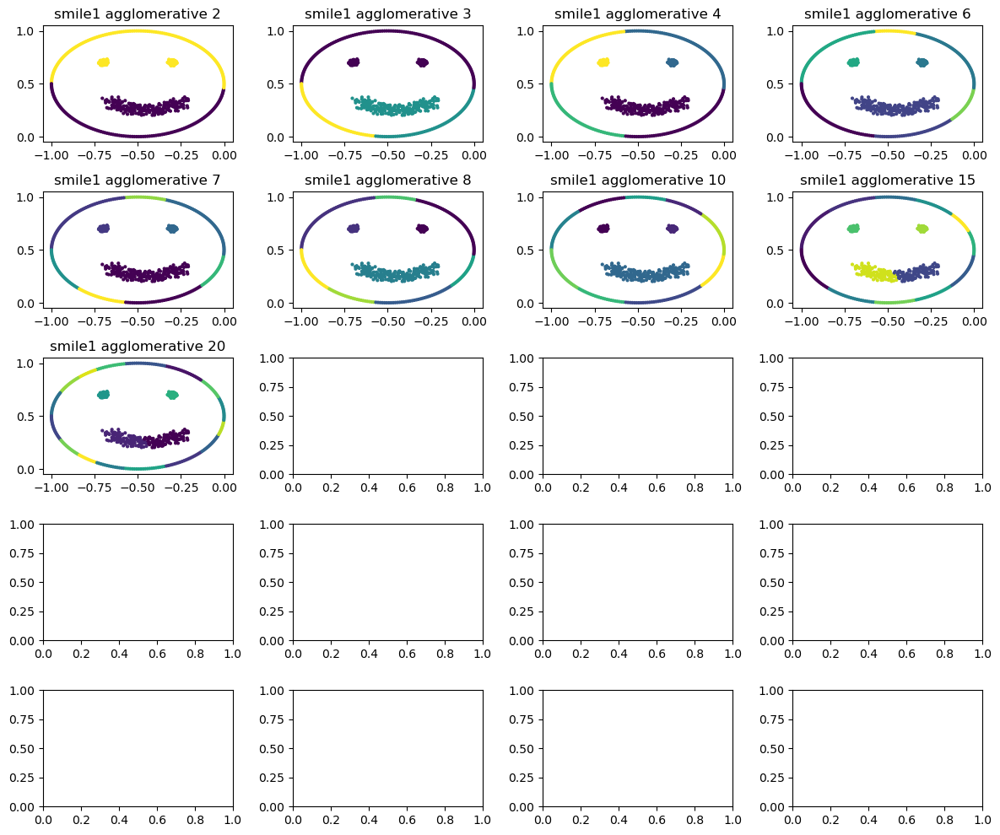

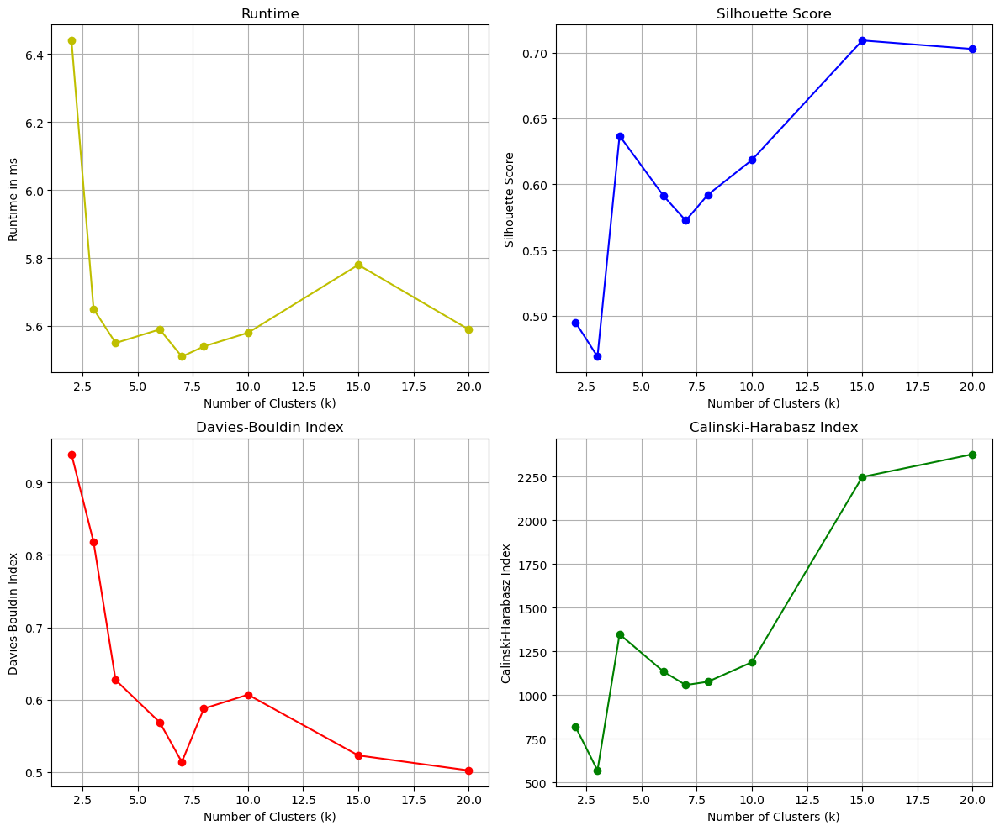

Evaluating with linkage complete
2 complete
3 complete
4 complete
6 complete
7 complete
8 complete
10 complete
15 complete
20 complete


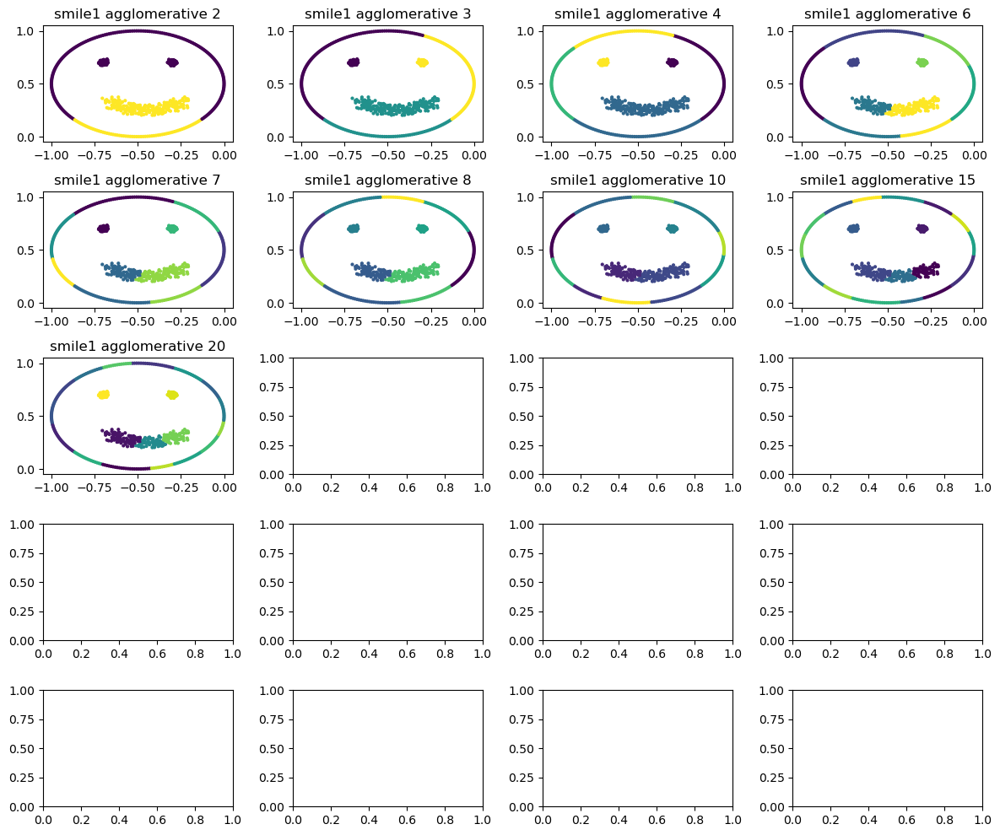

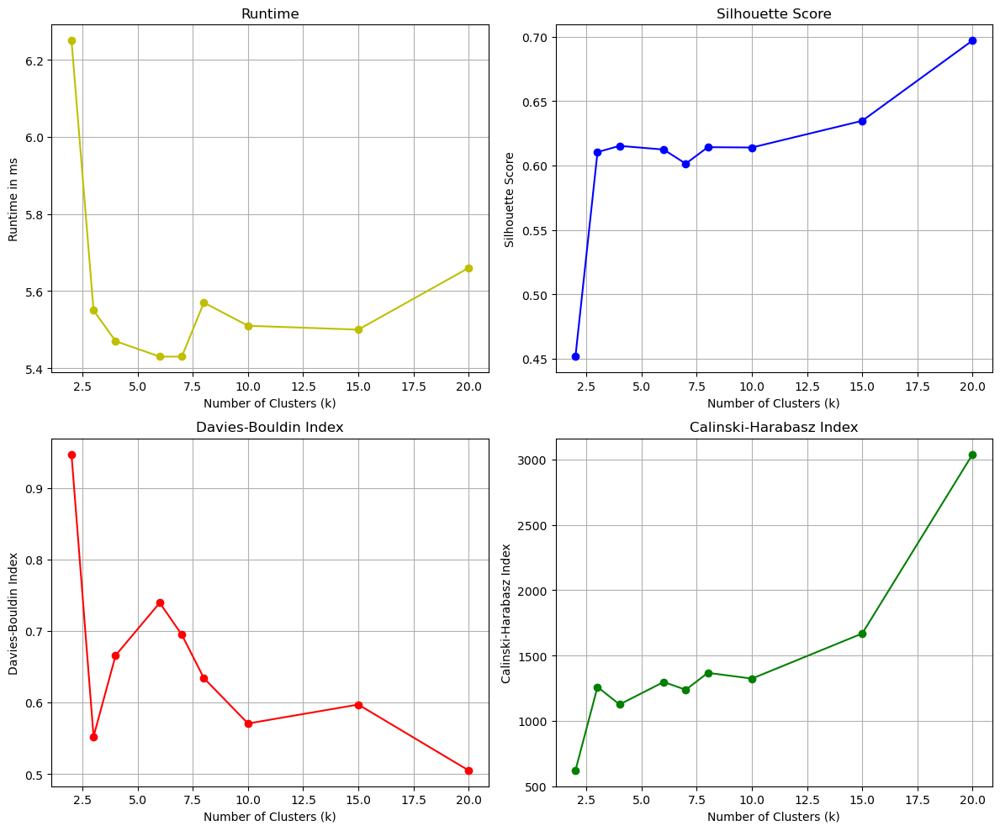

Evaluating with linkage ward
2 ward
3 ward
4 ward
6 ward
7 ward
8 ward
10 ward
15 ward
20 ward


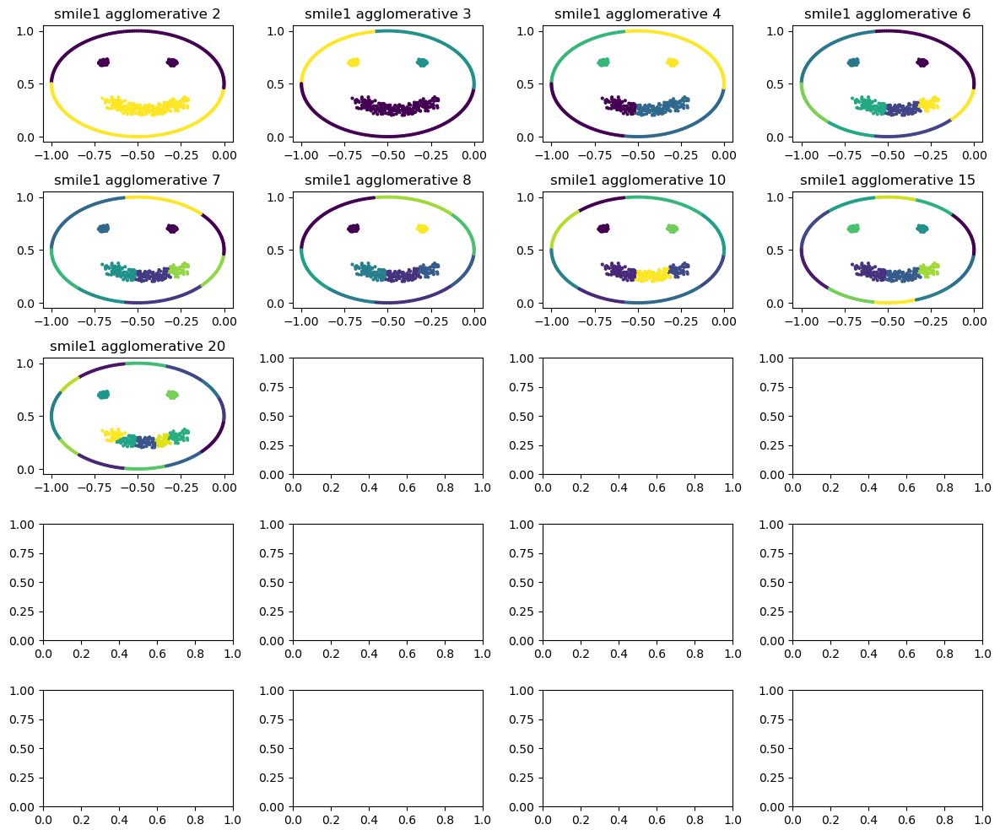

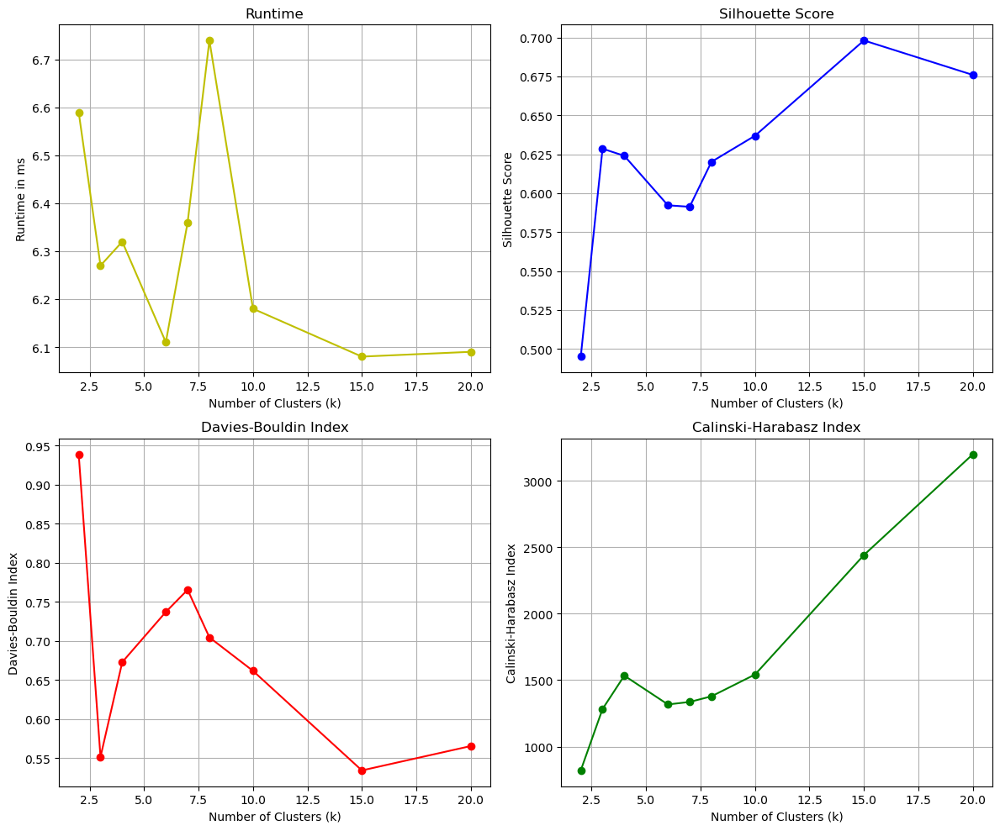

In [19]:
ks = [2,3,4,6,7,8,10,15,20]
print("Evaluating with linkage single")
evaluate_clustering("smile1", "agglomerative", ks, 'single')
print("Evaluating with linkage average")
evaluate_clustering("smile1", "agglomerative", ks, 'average')
print("Evaluating with linkage complete")
evaluate_clustering("smile1", "agglomerative", ks, 'complete')
print("Evaluating with linkage ward")
evaluate_clustering("smile1", "agglomerative", ks, 'ward')

Evaluation with d
Linkage:  ward


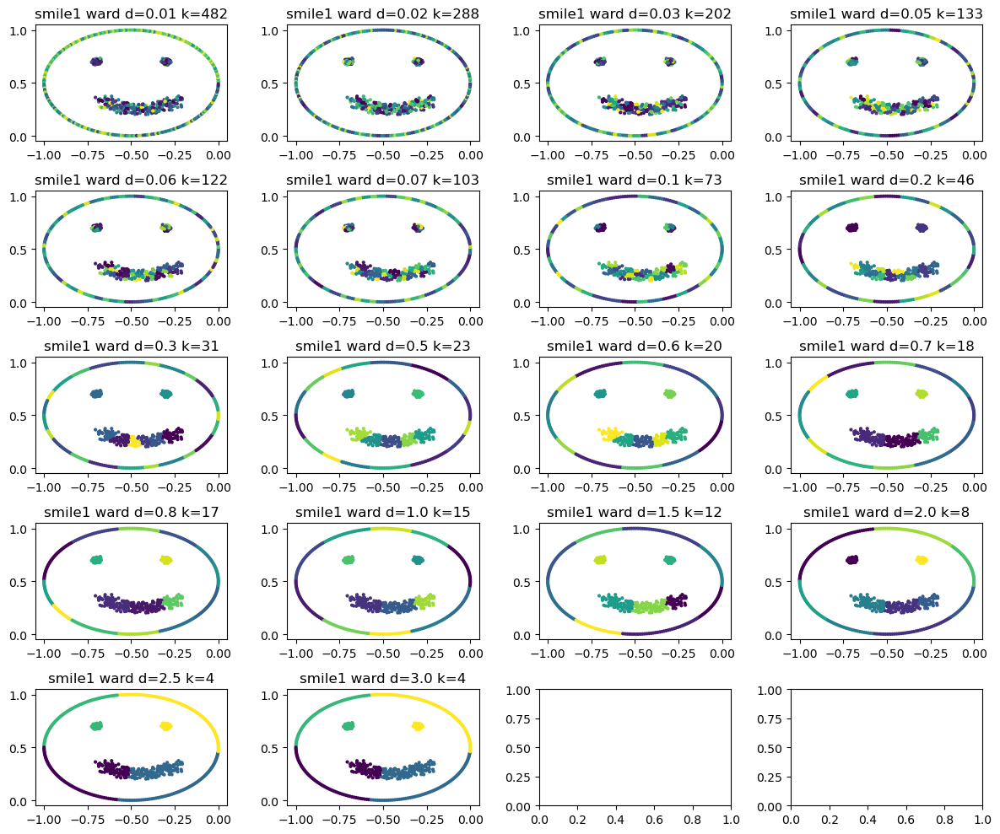

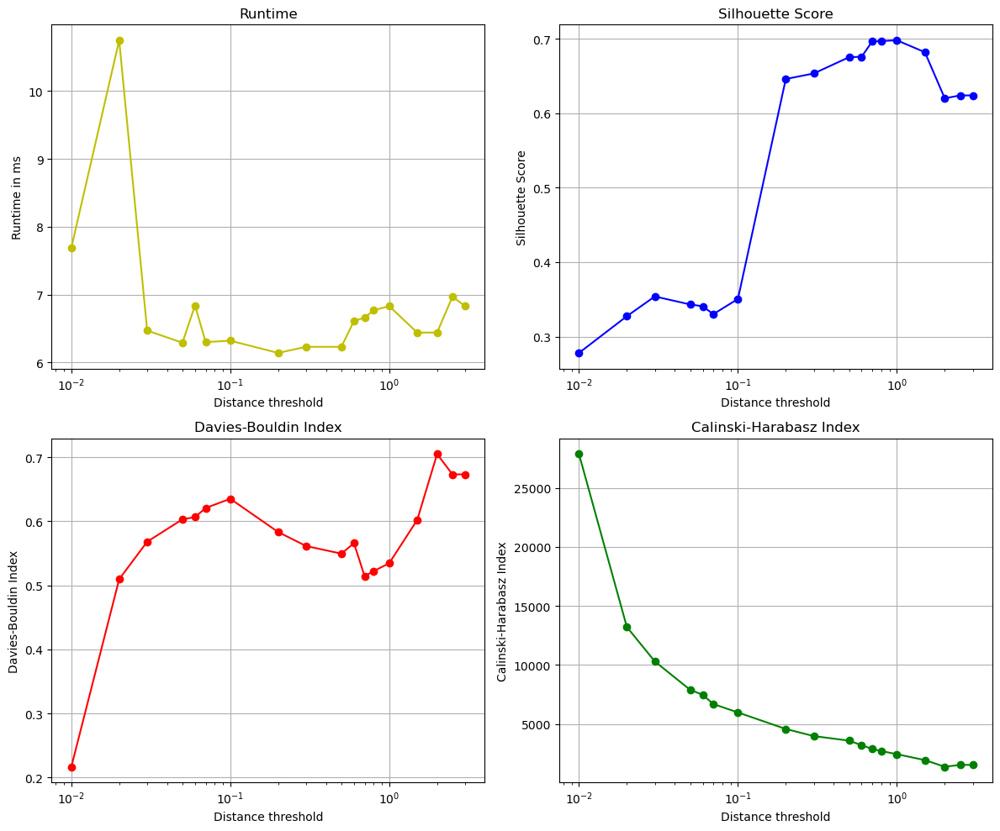

Linkage:  complete
Only 1 cluster or as many clusters as points for this model with distance:  1.5
Only 1 cluster or as many clusters as points for this model with distance:  2.0
Only 1 cluster or as many clusters as points for this model with distance:  2.5
Only 1 cluster or as many clusters as points for this model with distance:  3.0


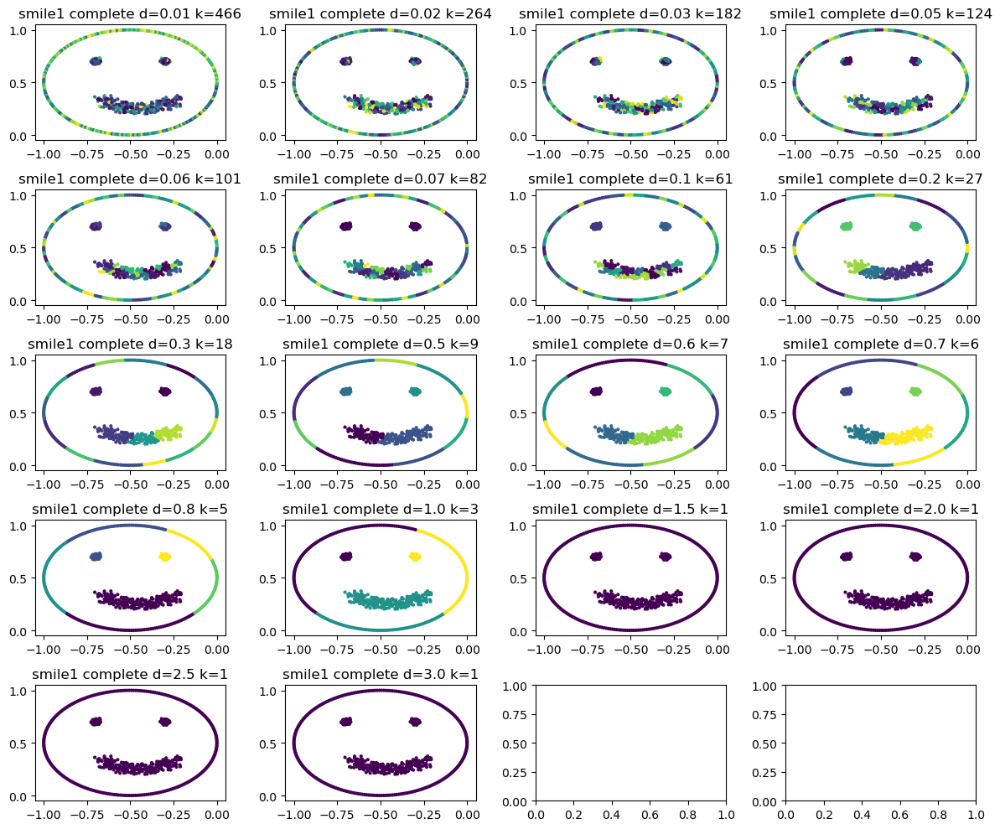

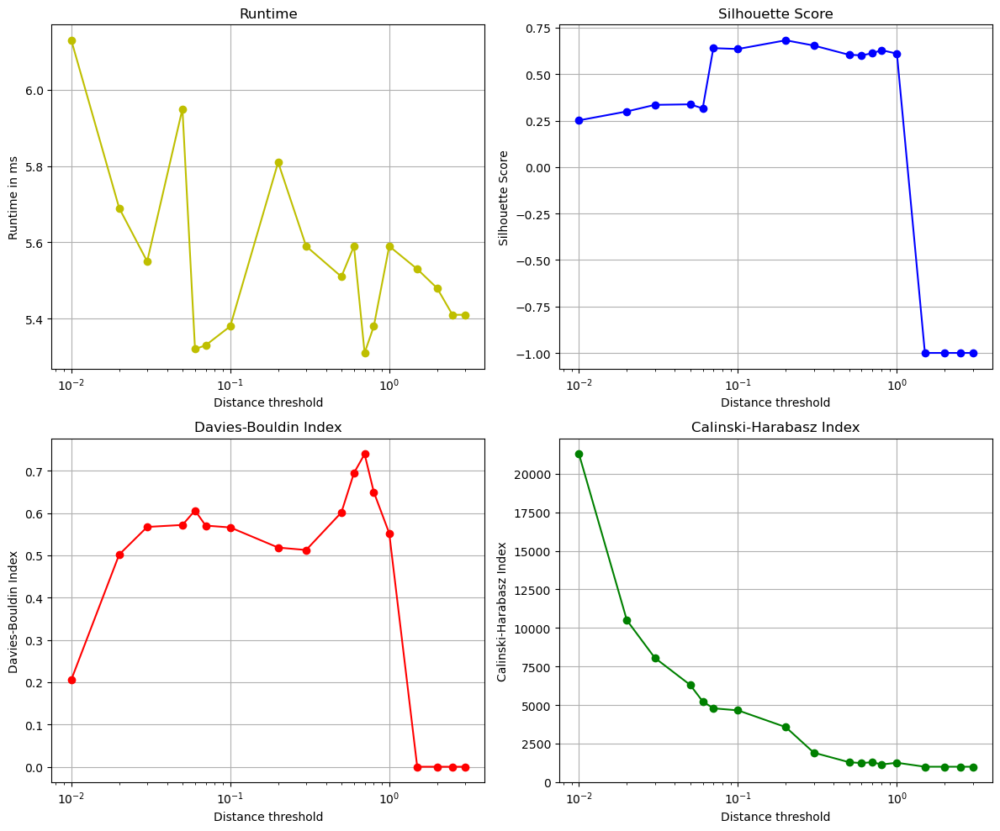

Linkage:  average
Only 1 cluster or as many clusters as points for this model with distance:  0.6
Only 1 cluster or as many clusters as points for this model with distance:  0.7
Only 1 cluster or as many clusters as points for this model with distance:  0.8
Only 1 cluster or as many clusters as points for this model with distance:  1.0
Only 1 cluster or as many clusters as points for this model with distance:  1.5
Only 1 cluster or as many clusters as points for this model with distance:  2.0
Only 1 cluster or as many clusters as points for this model with distance:  2.5
Only 1 cluster or as many clusters as points for this model with distance:  3.0


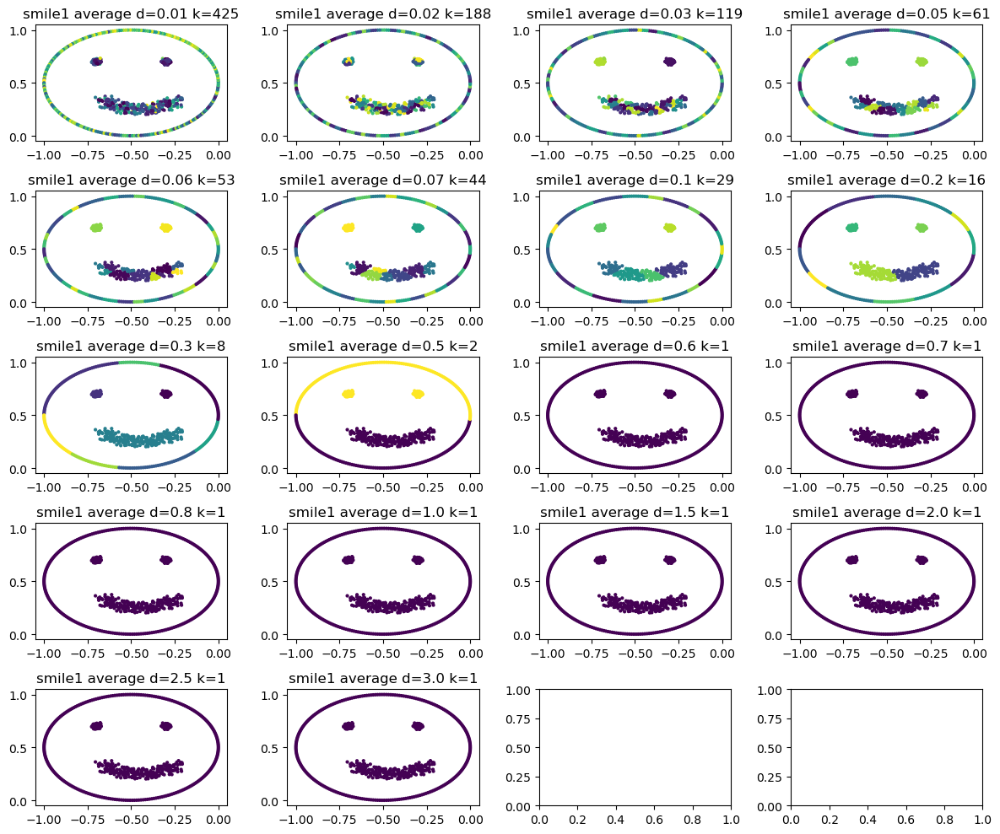

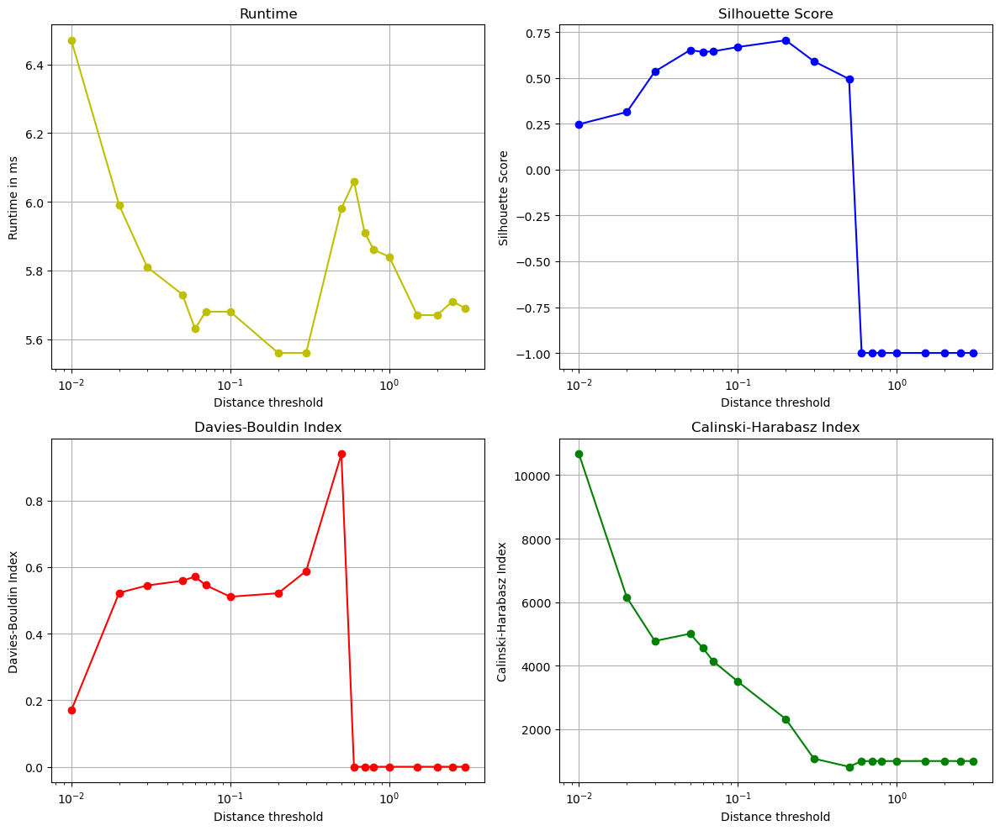

Linkage:  single
Only 1 cluster or as many clusters as points for this model with distance:  0.2
Only 1 cluster or as many clusters as points for this model with distance:  0.3
Only 1 cluster or as many clusters as points for this model with distance:  0.5
Only 1 cluster or as many clusters as points for this model with distance:  0.6
Only 1 cluster or as many clusters as points for this model with distance:  0.7
Only 1 cluster or as many clusters as points for this model with distance:  0.8
Only 1 cluster or as many clusters as points for this model with distance:  1.0
Only 1 cluster or as many clusters as points for this model with distance:  1.5
Only 1 cluster or as many clusters as points for this model with distance:  2.0
Only 1 cluster or as many clusters as points for this model with distance:  2.5
Only 1 cluster or as many clusters as points for this model with distance:  3.0


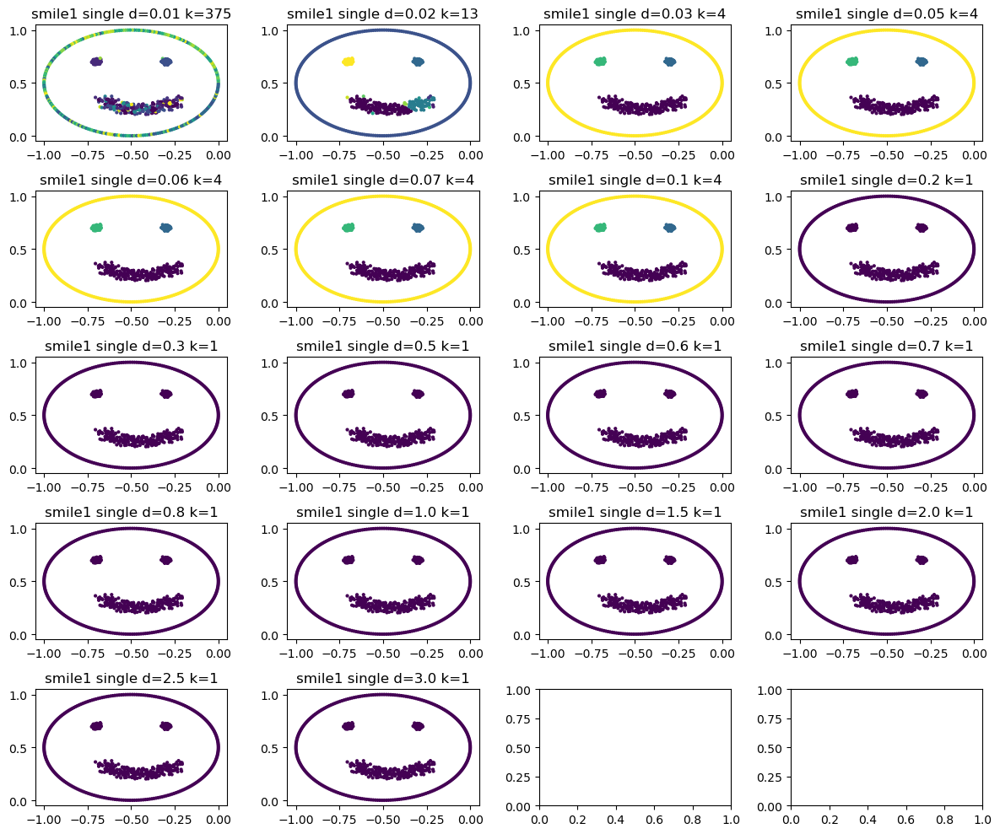

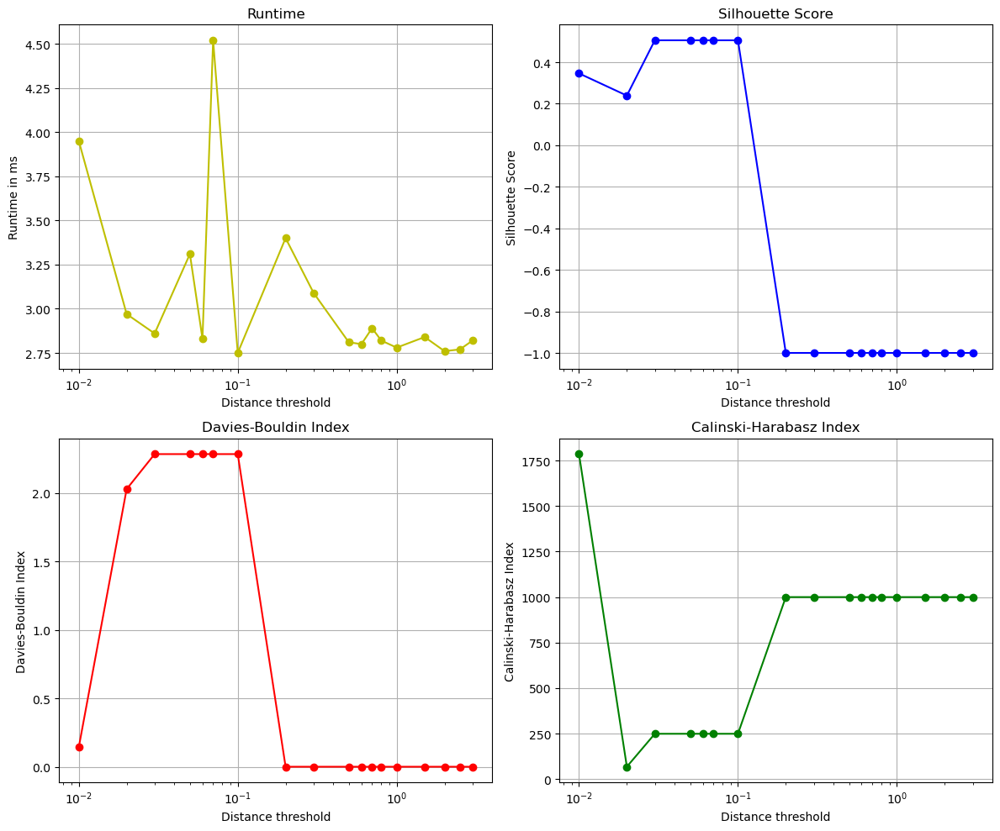

In [20]:
print("Evaluation with d")
dists=[0.01, 0.02, 0.03, 0.05, 0.06, 0.07, 0.1, 0.2, 0.3, 0.5, 0.6, 0.7, 0.8, 1., 1.5, 2., 2.5, 3.,]
linkage = ['ward', 'complete', 'average', 'single']
for l in linkage:
    print("Linkage: ", l)
    evaluate_clustering("smile1", "agglomerative", ks, l, use_distance_threshold=True, dists=dists)

Evaluating with linkage single
2 single
3 single
4 single
6 single
7 single
8 single
10 single
15 single
20 single


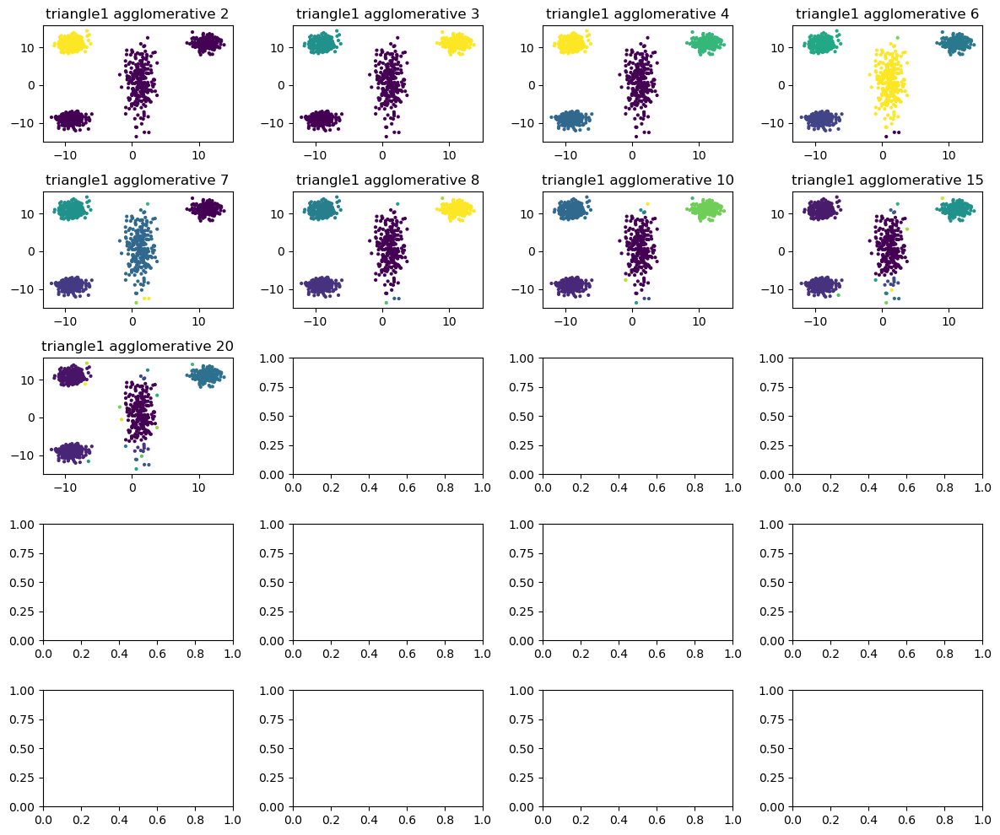

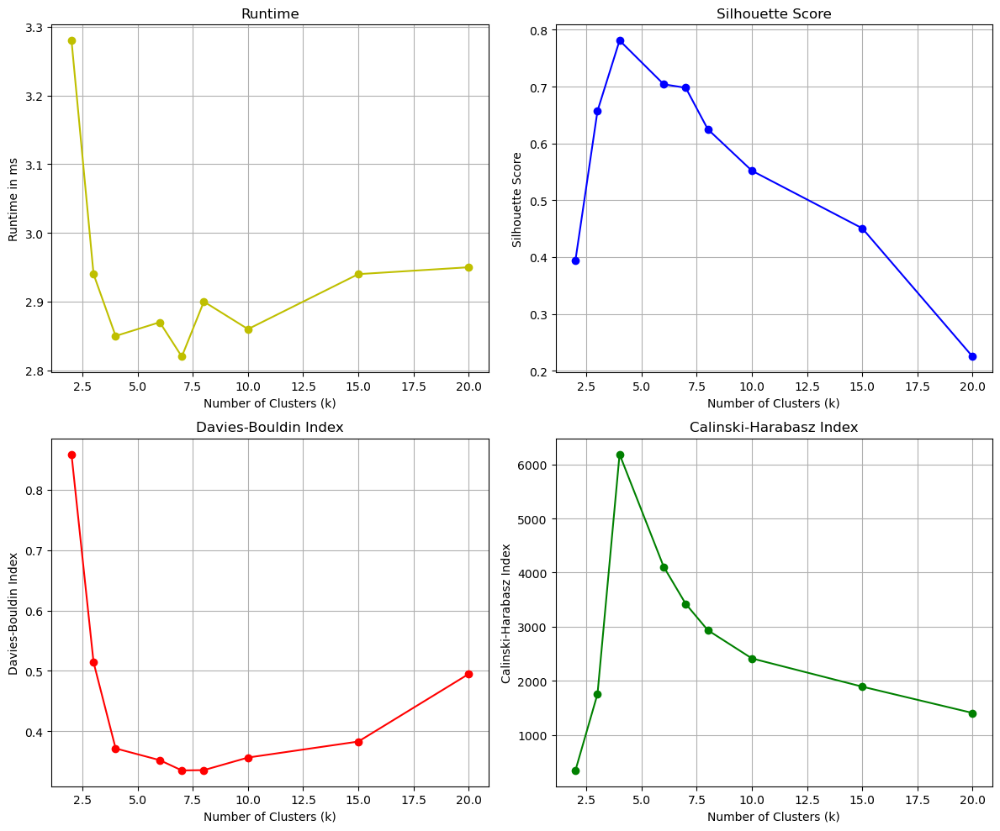

Evaluating with linkage average
2 average
3 average
4 average
6 average
7 average
8 average
10 average
15 average
20 average


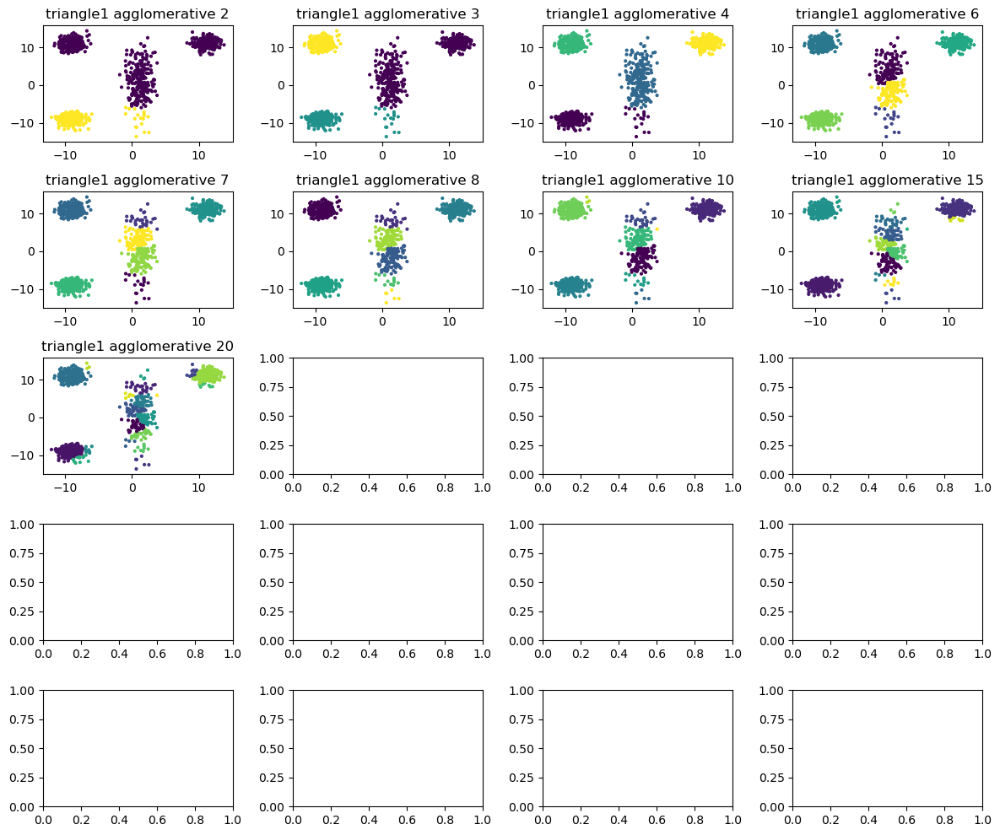

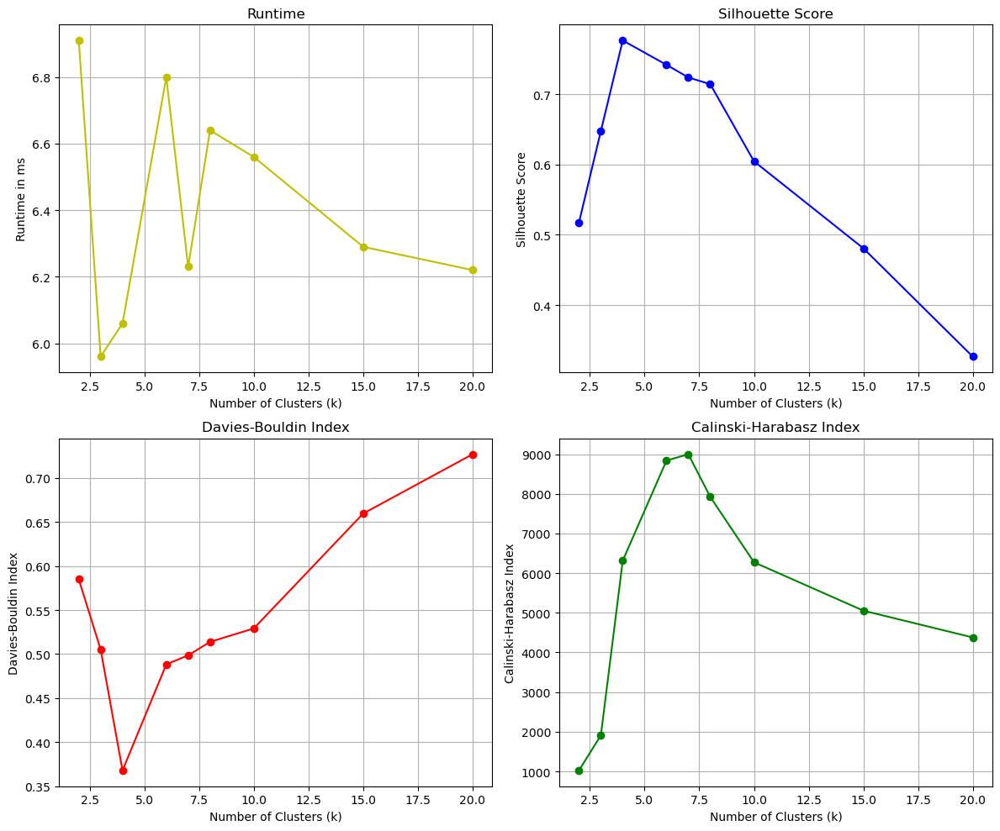

Evaluating with linkage complete
2 complete
3 complete
4 complete
6 complete
7 complete
8 complete
10 complete
15 complete
20 complete


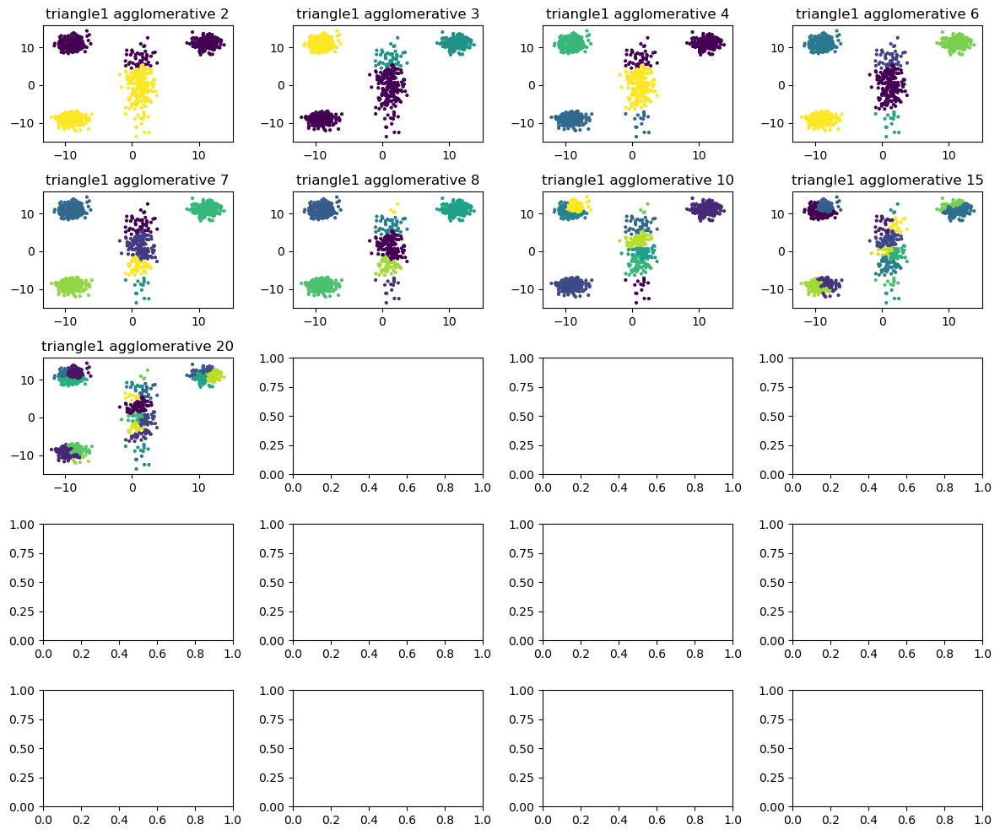

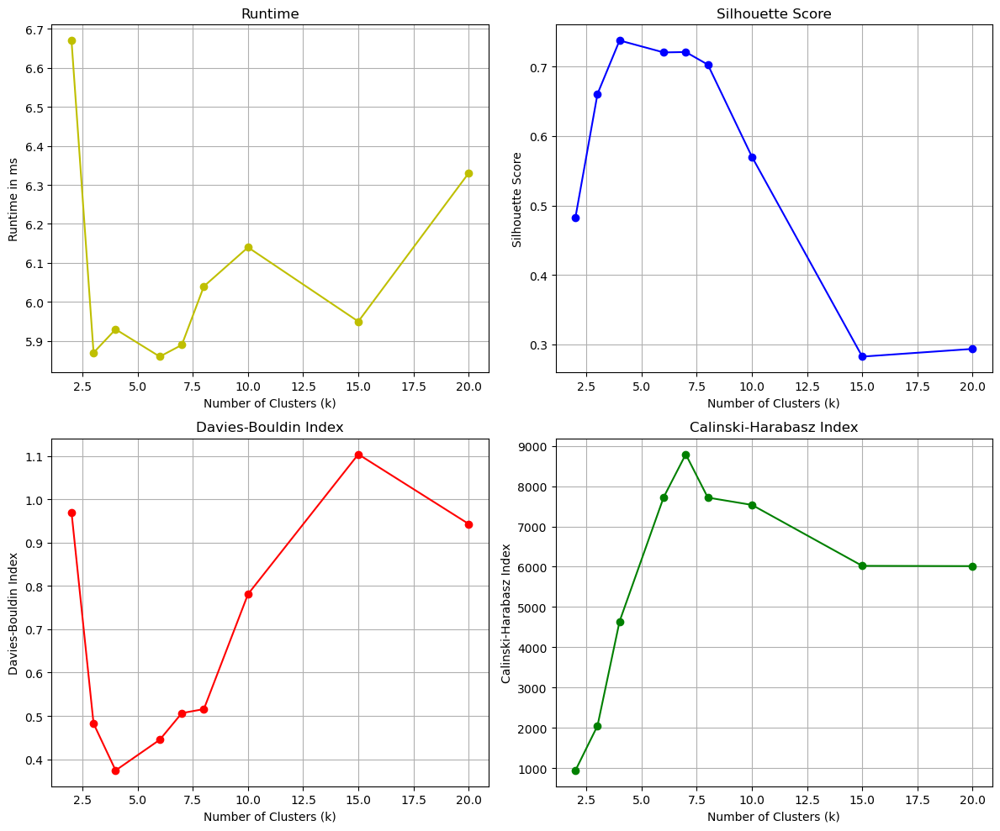

Evaluating with linkage ward
2 ward
3 ward
4 ward
6 ward
7 ward
8 ward
10 ward
15 ward
20 ward


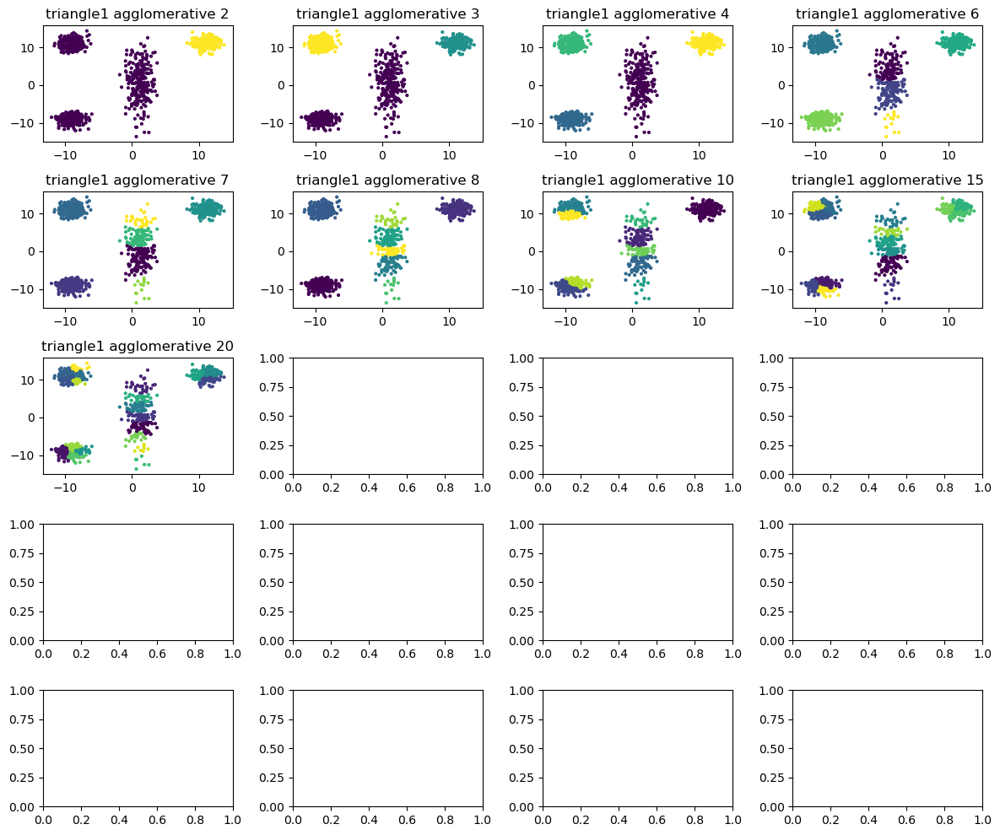

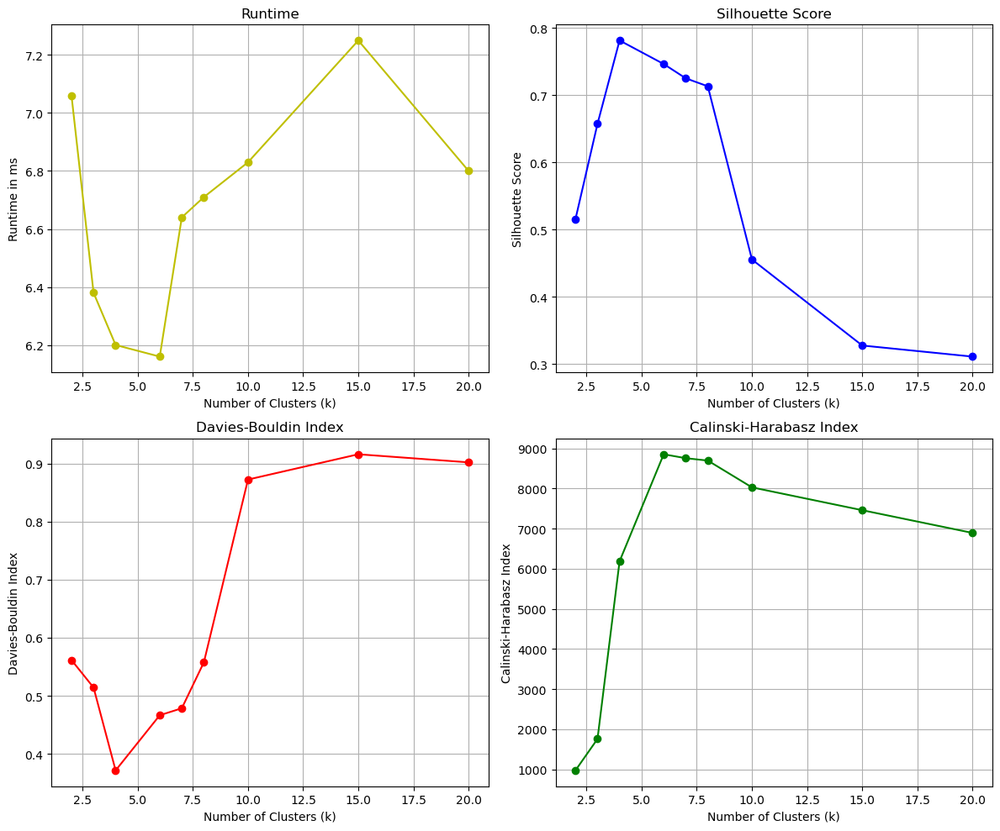

In [21]:
ks = [2,3,4,6,7,8,10,15,20]
print("Evaluating with linkage single")
evaluate_clustering("triangle1", "agglomerative", ks, 'single')
print("Evaluating with linkage average")
evaluate_clustering("triangle1", "agglomerative", ks, 'average')
print("Evaluating with linkage complete")
evaluate_clustering("triangle1", "agglomerative", ks, 'complete')
print("Evaluating with linkage ward")
evaluate_clustering("triangle1", "agglomerative", ks, 'ward')

Evaluation with d
Linkage:  ward


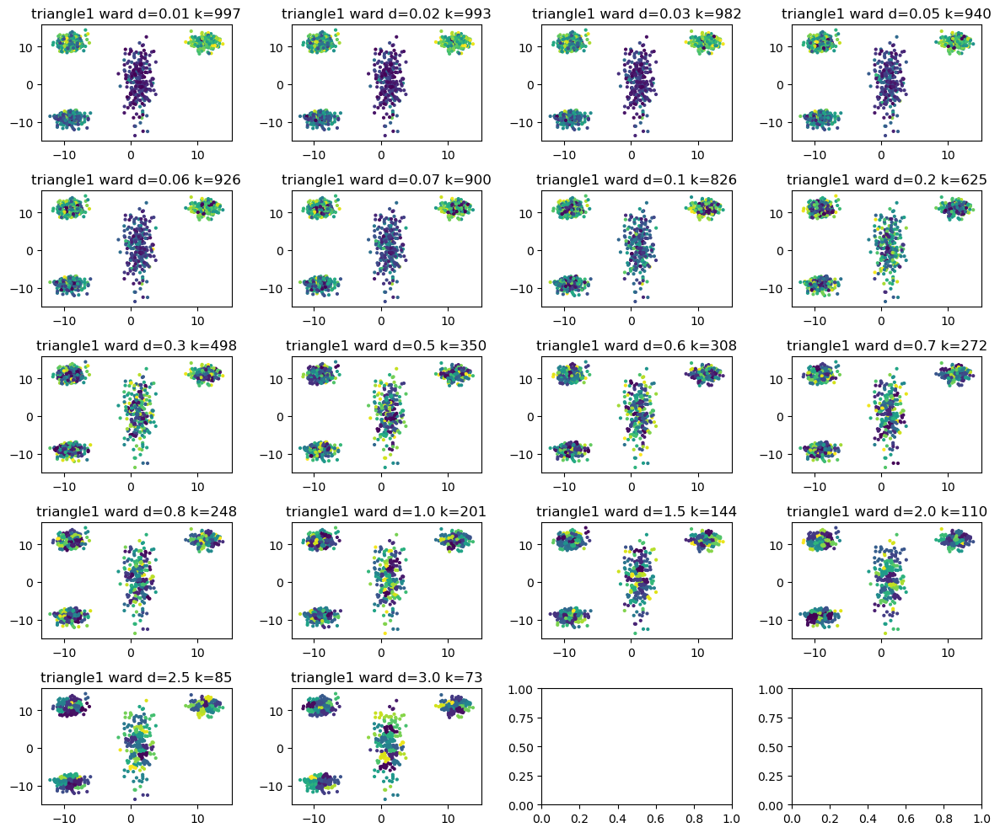

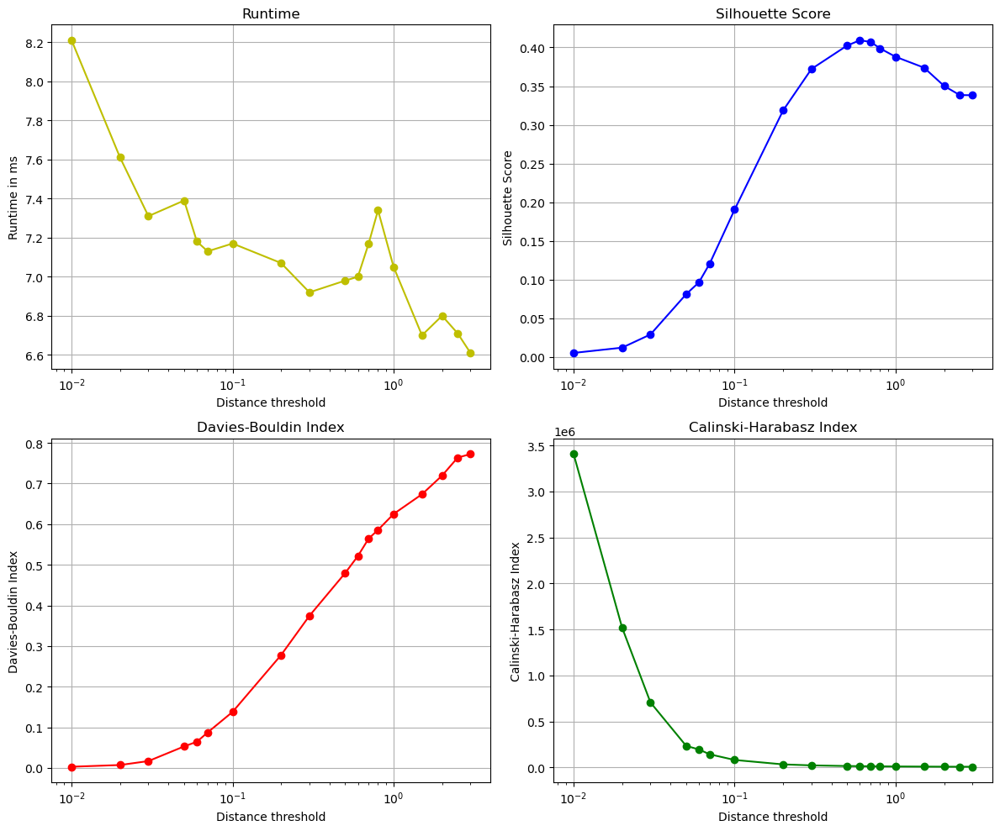

Linkage:  complete


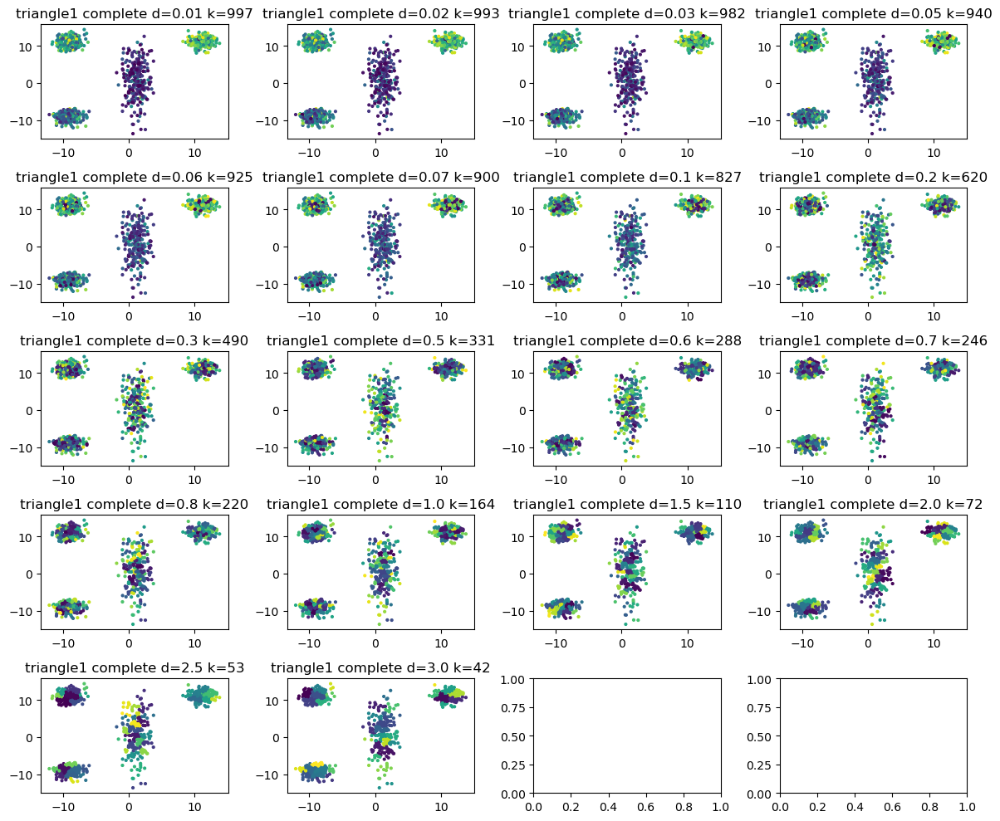

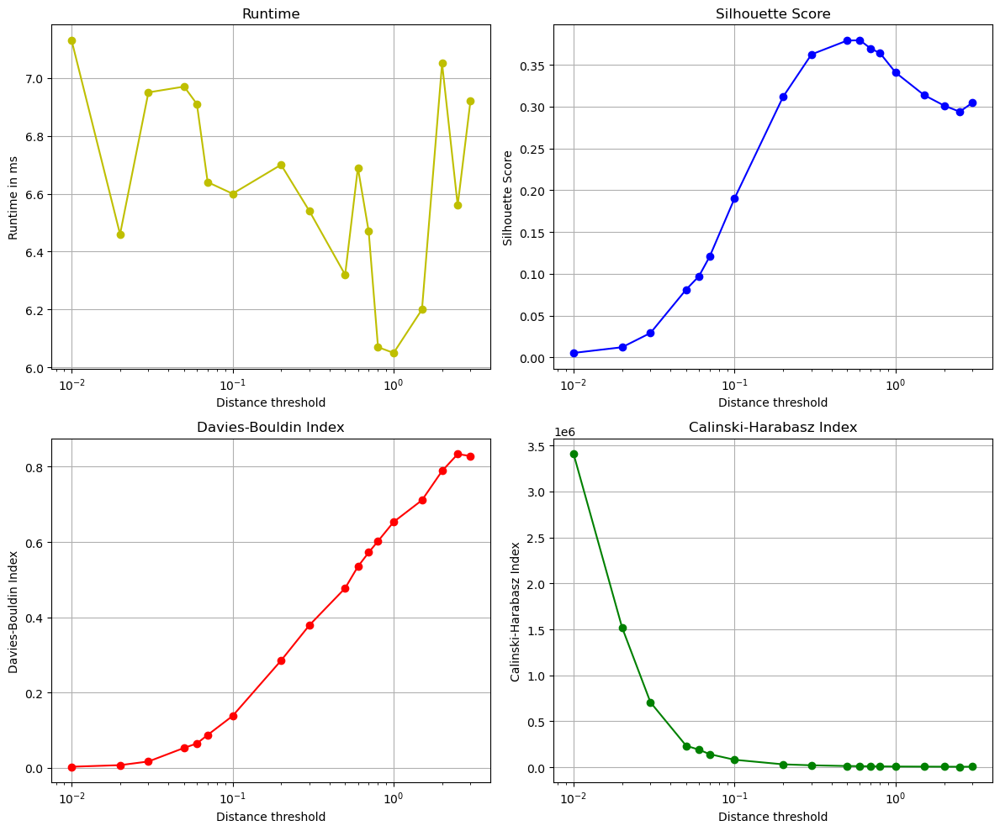

Linkage:  average


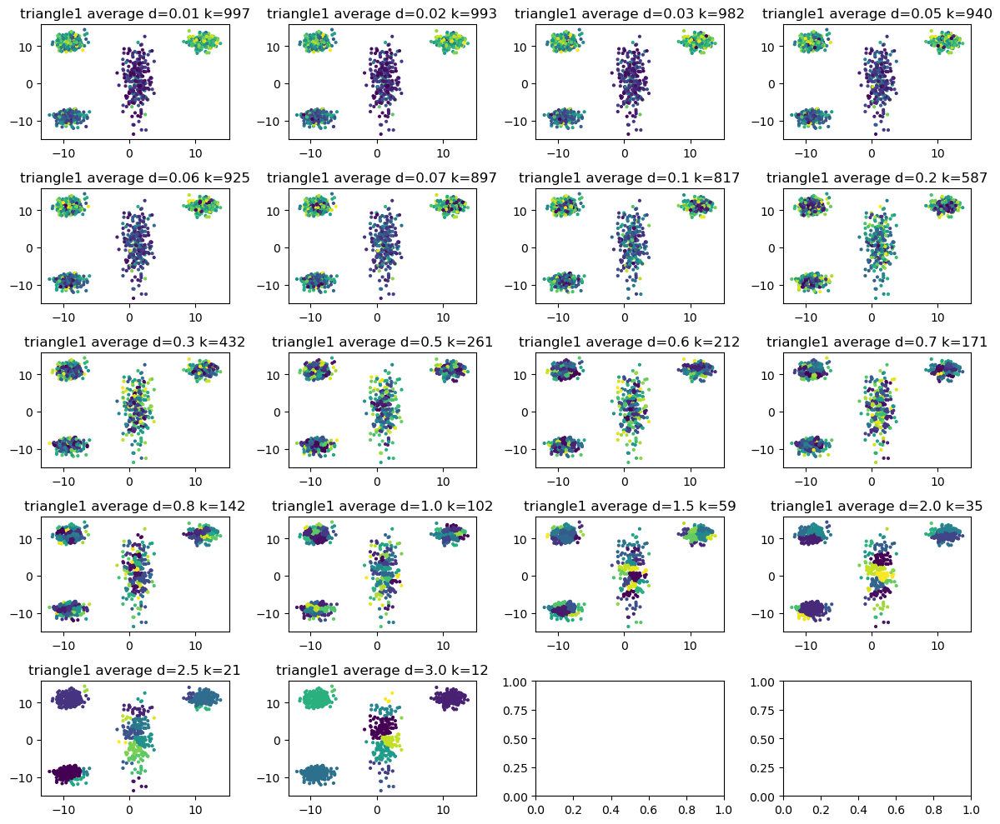

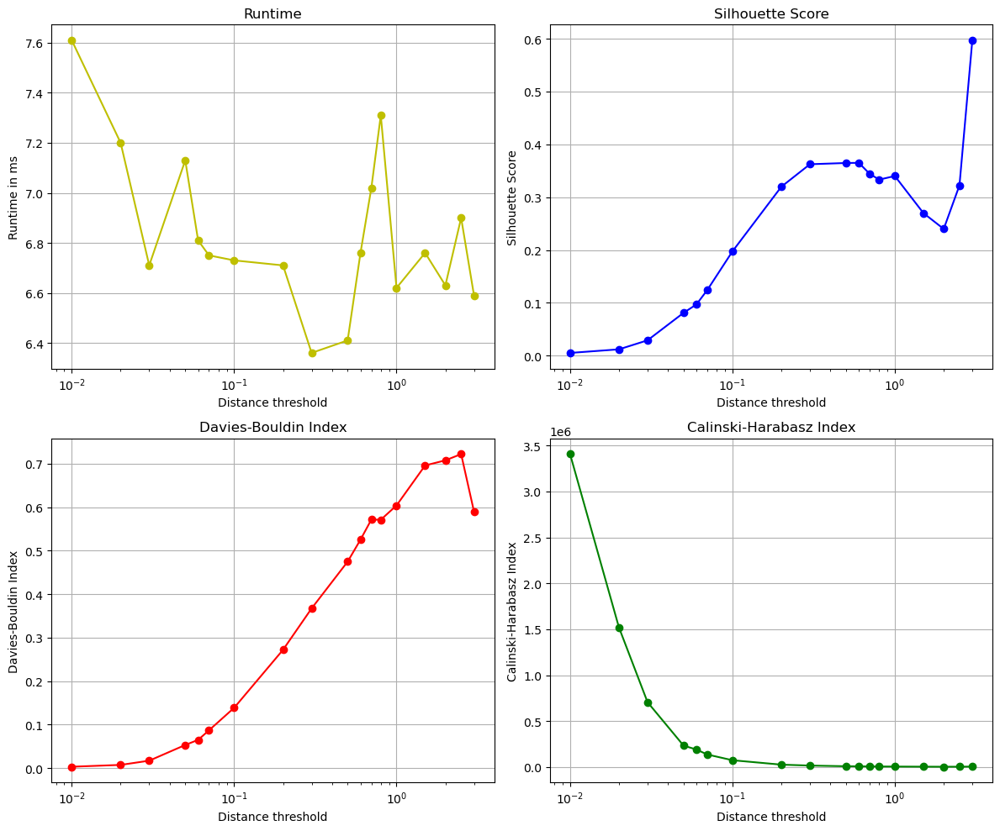

Linkage:  single


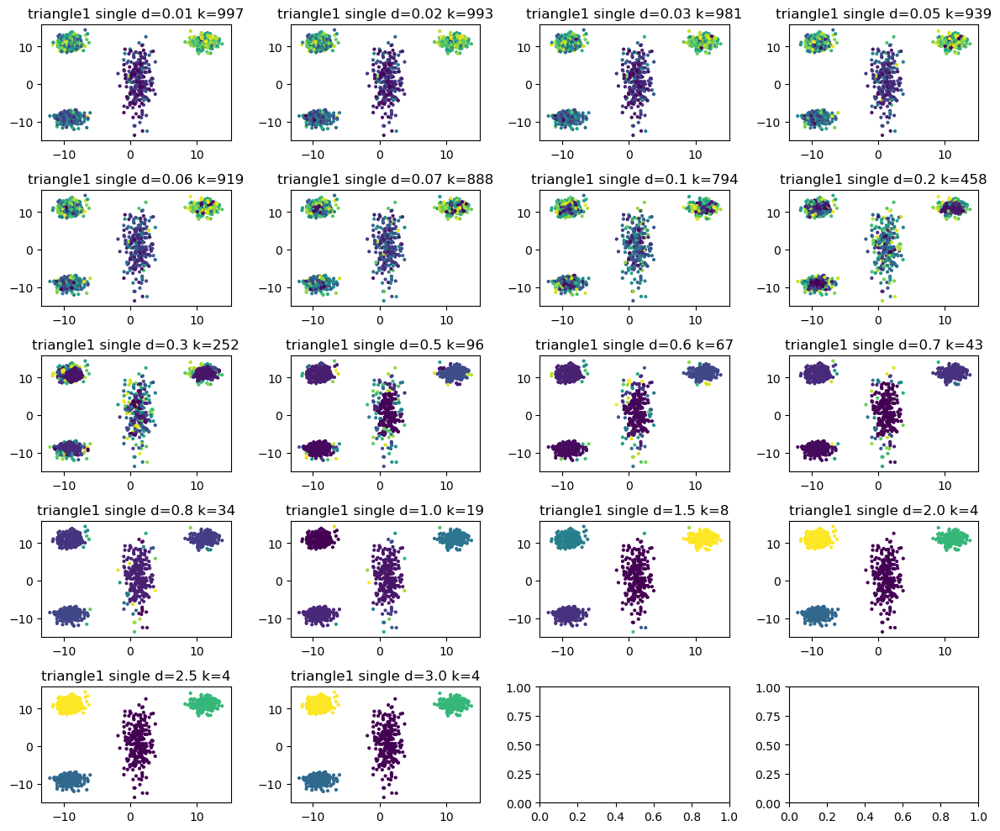

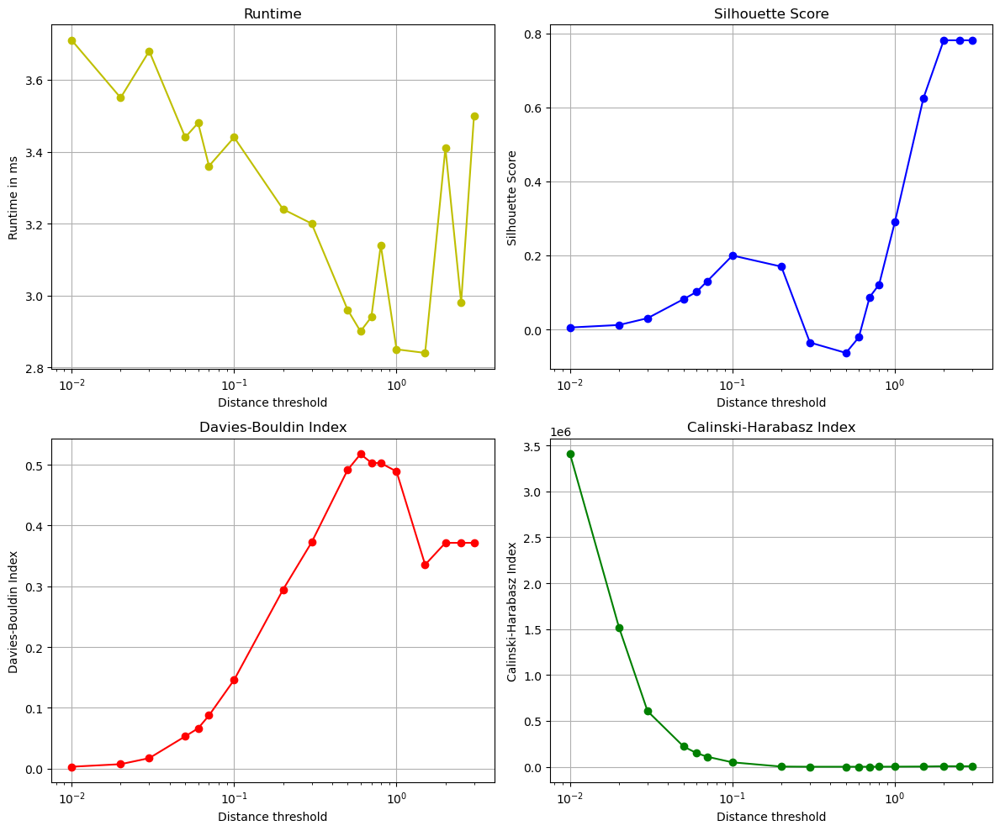

In [22]:
print("Evaluation with d")
dists=[0.01, 0.02, 0.03, 0.05, 0.06, 0.07, 0.1, 0.2, 0.3, 0.5, 0.6, 0.7, 0.8, 1., 1.5, 2., 2.5, 3.,]
linkage = ['ward', 'complete', 'average', 'single']
for l in linkage:
    print("Linkage: ", l)
    evaluate_clustering("triangle1", "agglomerative", ks, l, use_distance_threshold=True, dists=dists)

# Part 2

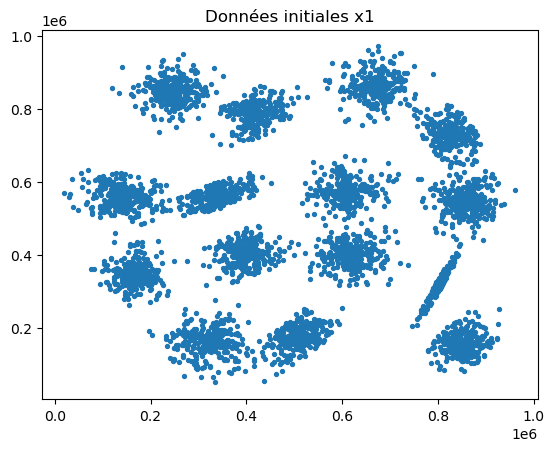

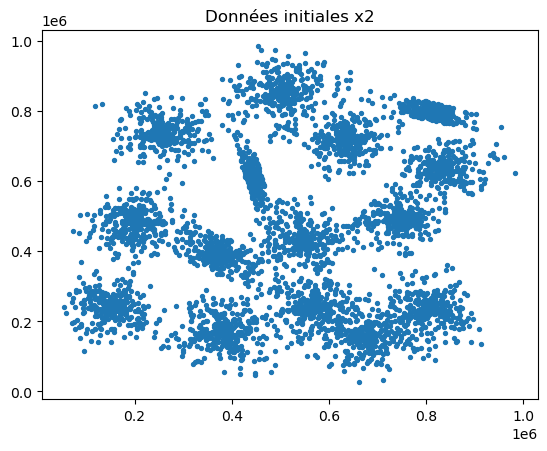

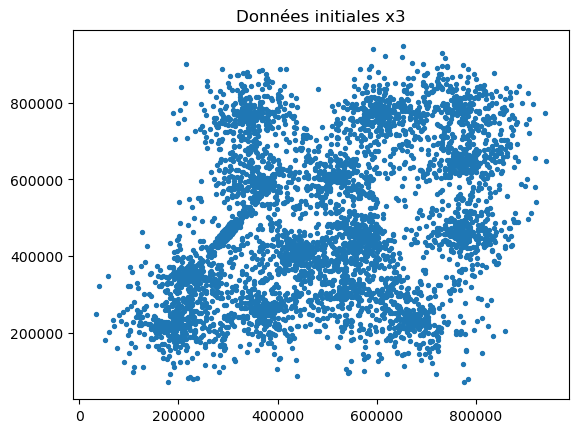

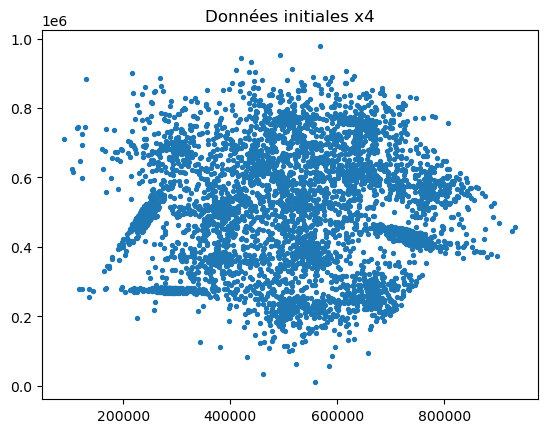

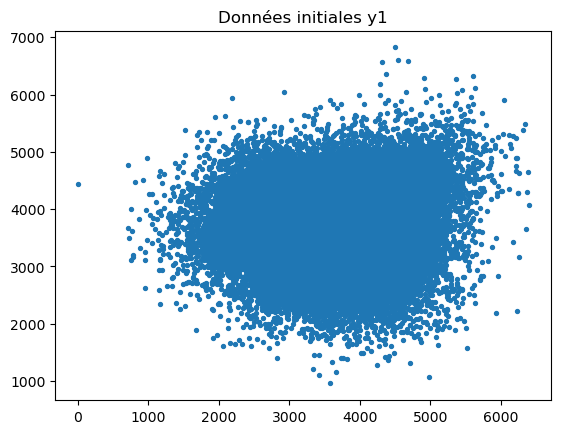

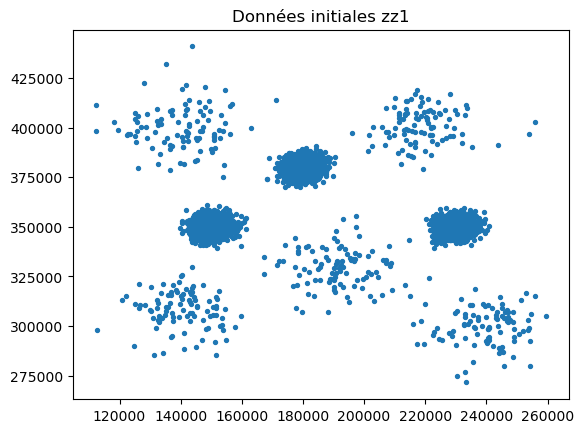

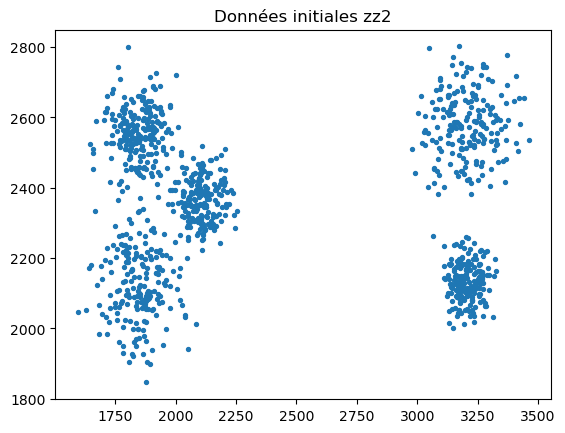

In [23]:
path_rapport = './dataset-rapport'

# Load the dataset
# The data is x y coordinates in 2 columns

files = ['x1', 'x2', 'x3', 'x4', 'y1', 'zz1', 'zz2']

for filename in files:
    data = np.loadtxt(path_rapport + '/' + filename + '.txt')
    f0 = data[:,0]
    f1 = data[:,1]


    # Plot the data
    plt.scatter(f0, f1, s=8)
    plt.title("Données initiales " + filename)
    plt.show()

Evaluating with K-means
2 ward
3 ward
4 ward
5 ward
6 ward
8 ward
10 ward
12 ward
13 ward
14 ward
15 ward
16 ward


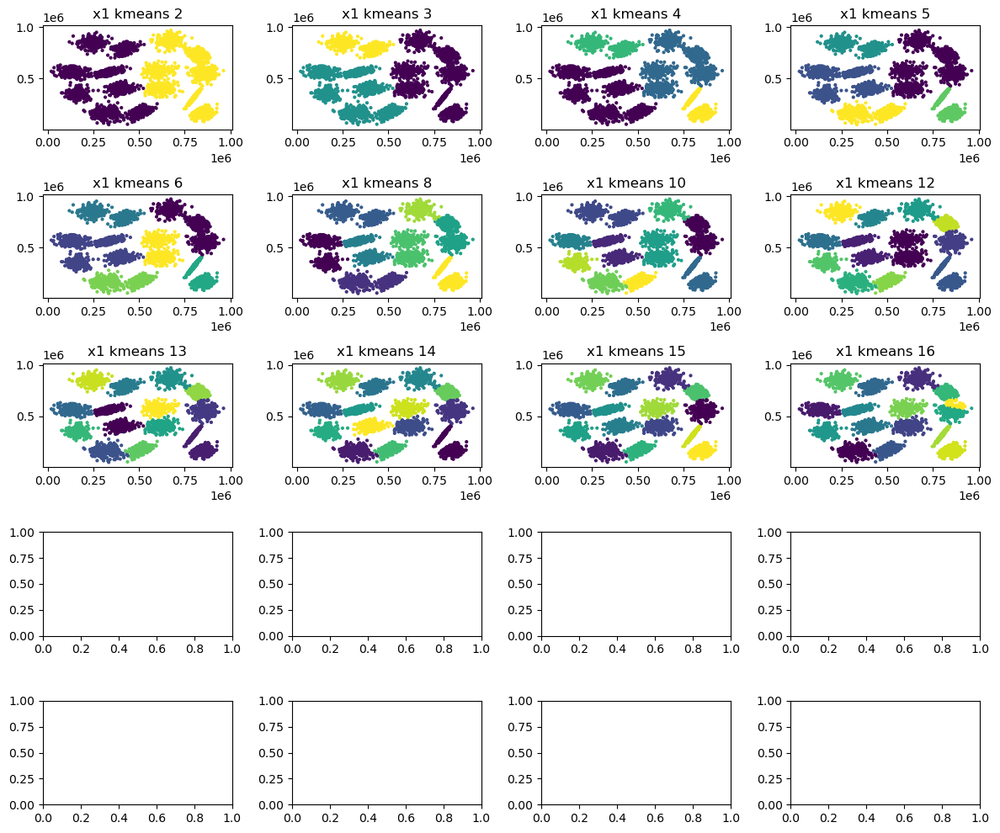

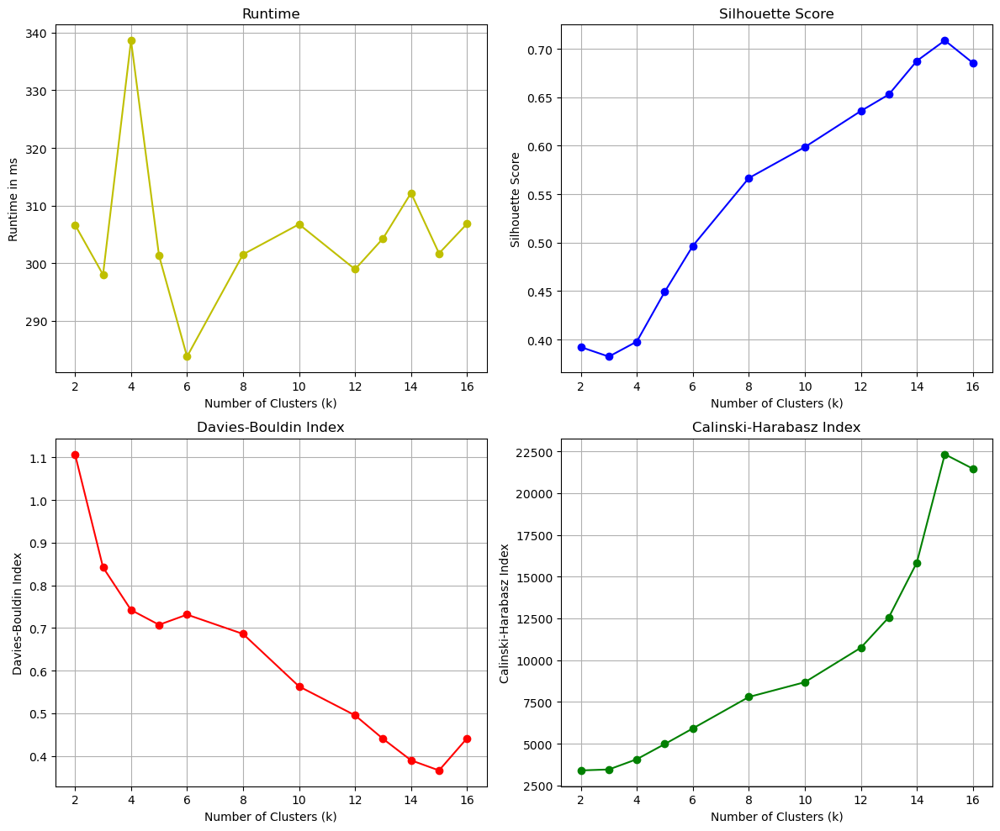

Evaluating with K-means
2 ward
3 ward
4 ward
5 ward
6 ward
8 ward
10 ward
12 ward
13 ward
14 ward
15 ward
16 ward


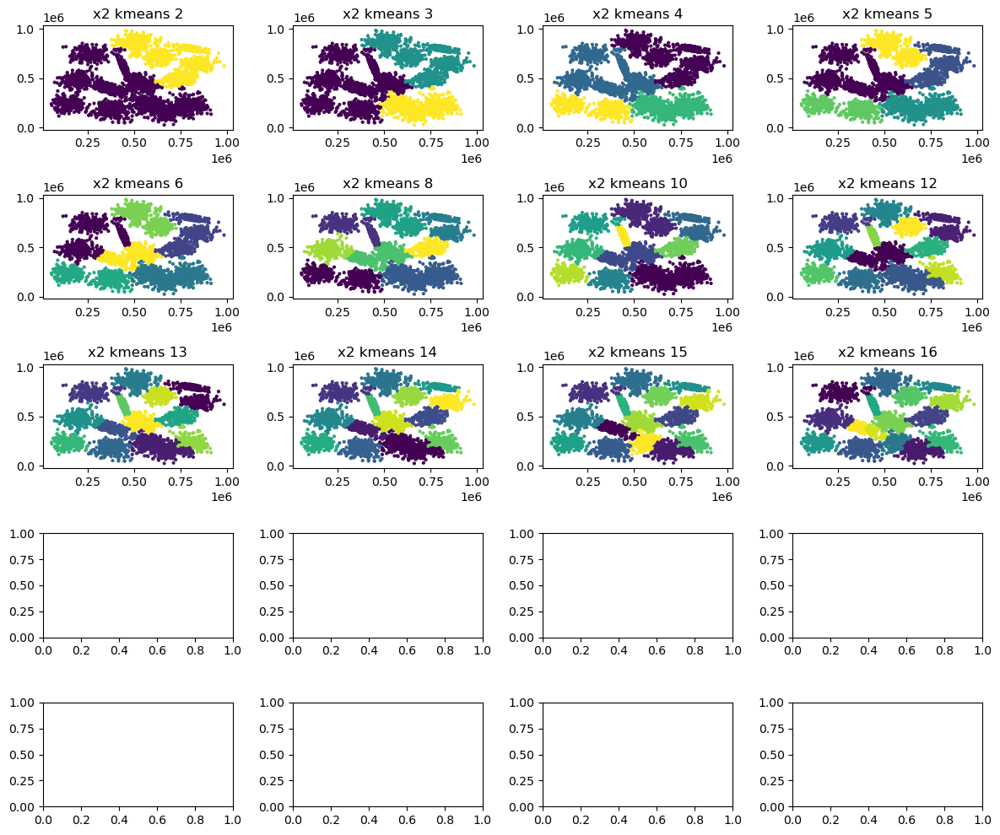

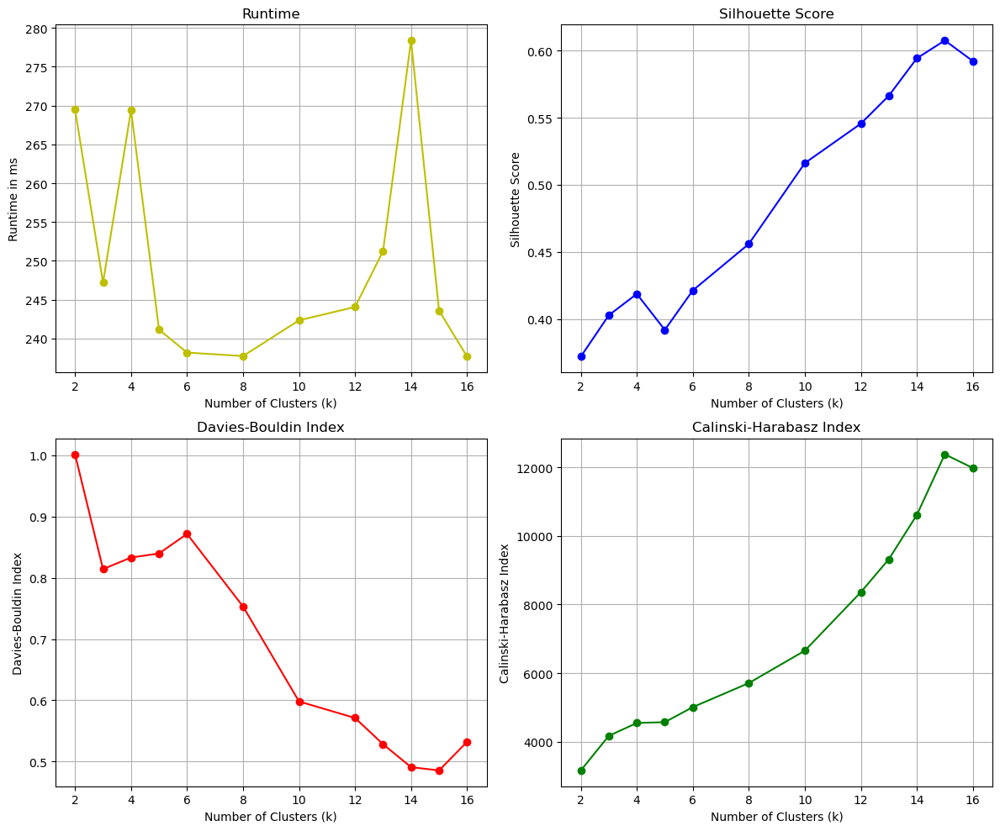

Evaluating with K-means
2 ward
3 ward
4 ward
5 ward
6 ward
8 ward
10 ward
12 ward
13 ward
14 ward
15 ward
16 ward


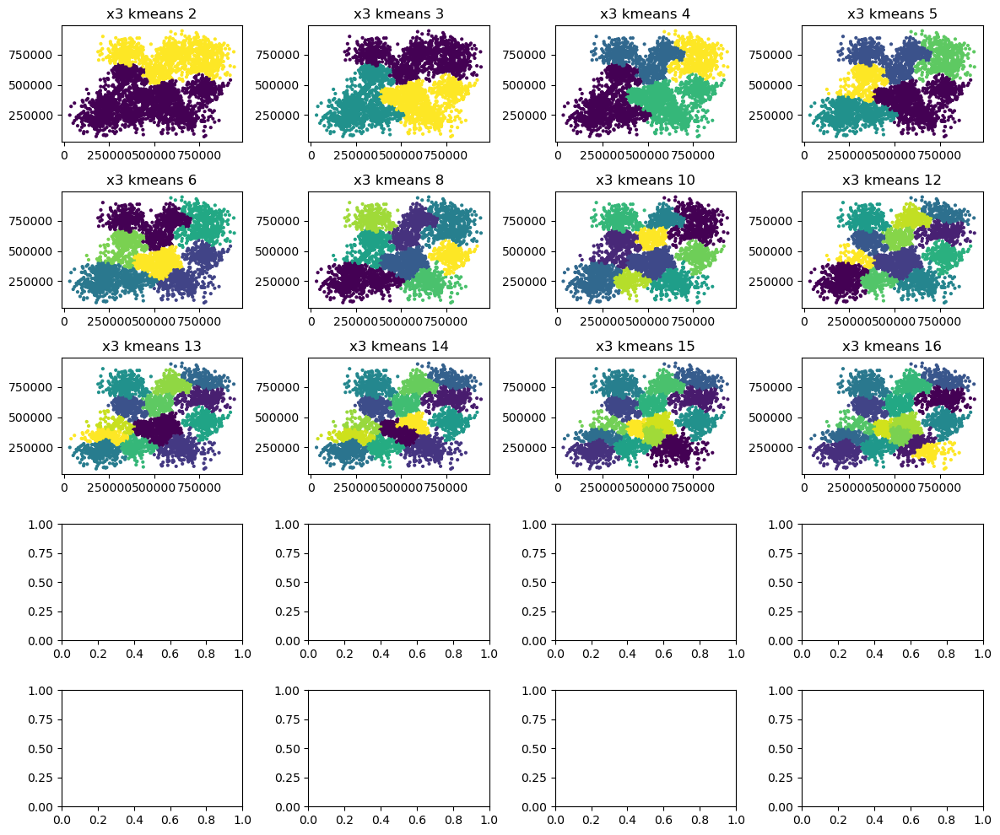

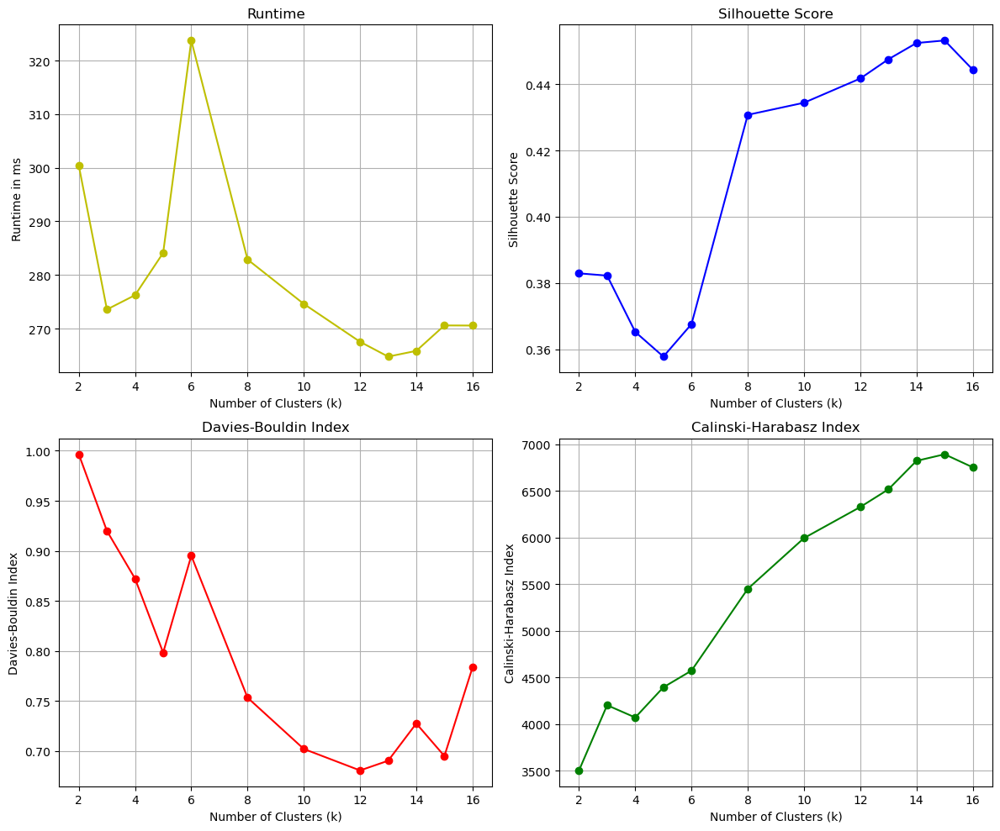

Evaluating with K-means
2 ward
3 ward
4 ward
5 ward
6 ward
8 ward
10 ward
12 ward
13 ward
14 ward
15 ward
16 ward


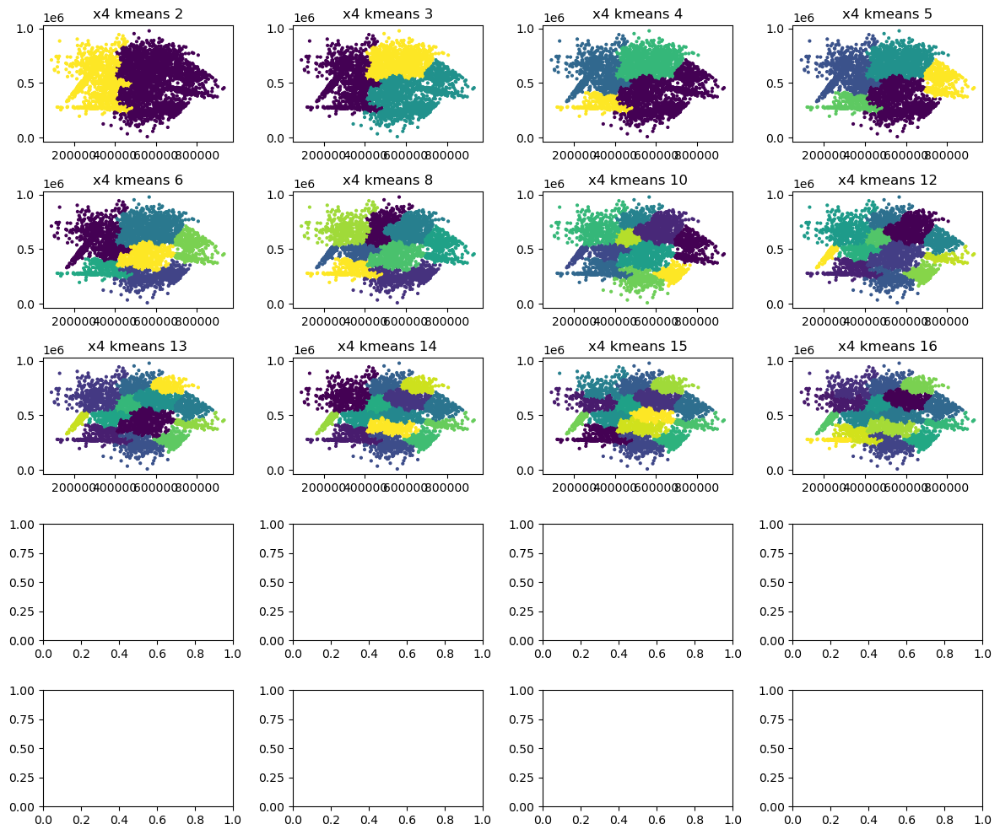

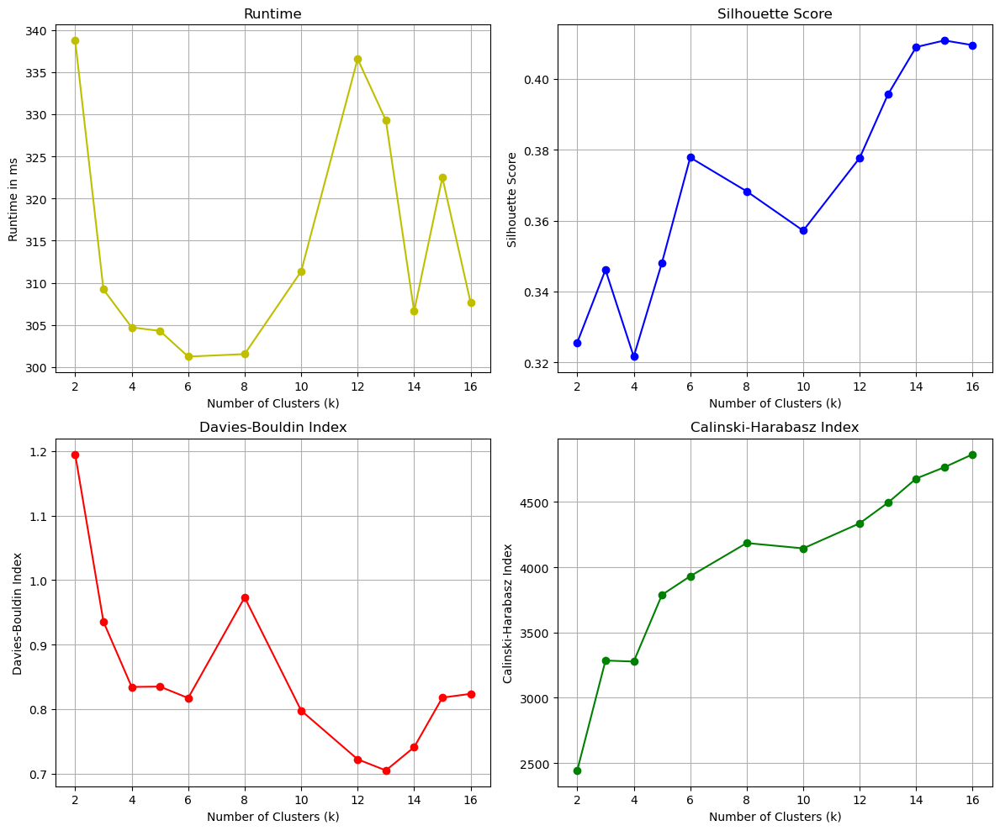

Evaluating with K-means
2 ward
3 ward
4 ward
5 ward
6 ward
8 ward
10 ward
12 ward
13 ward
14 ward
15 ward
16 ward


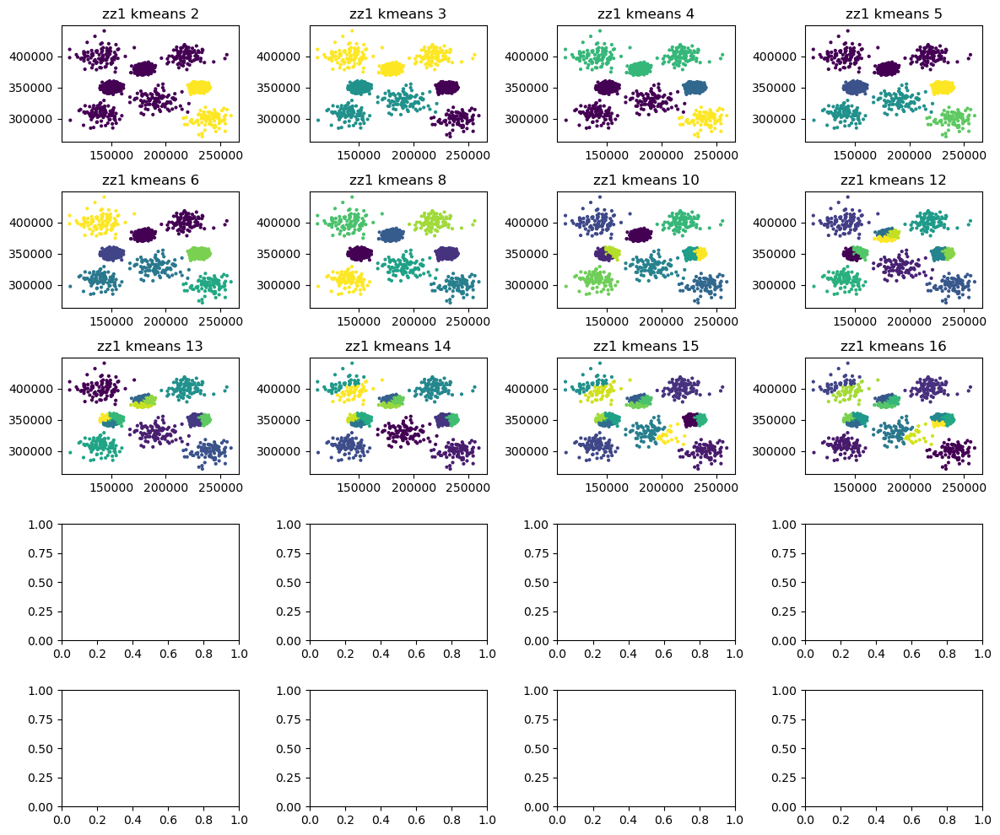

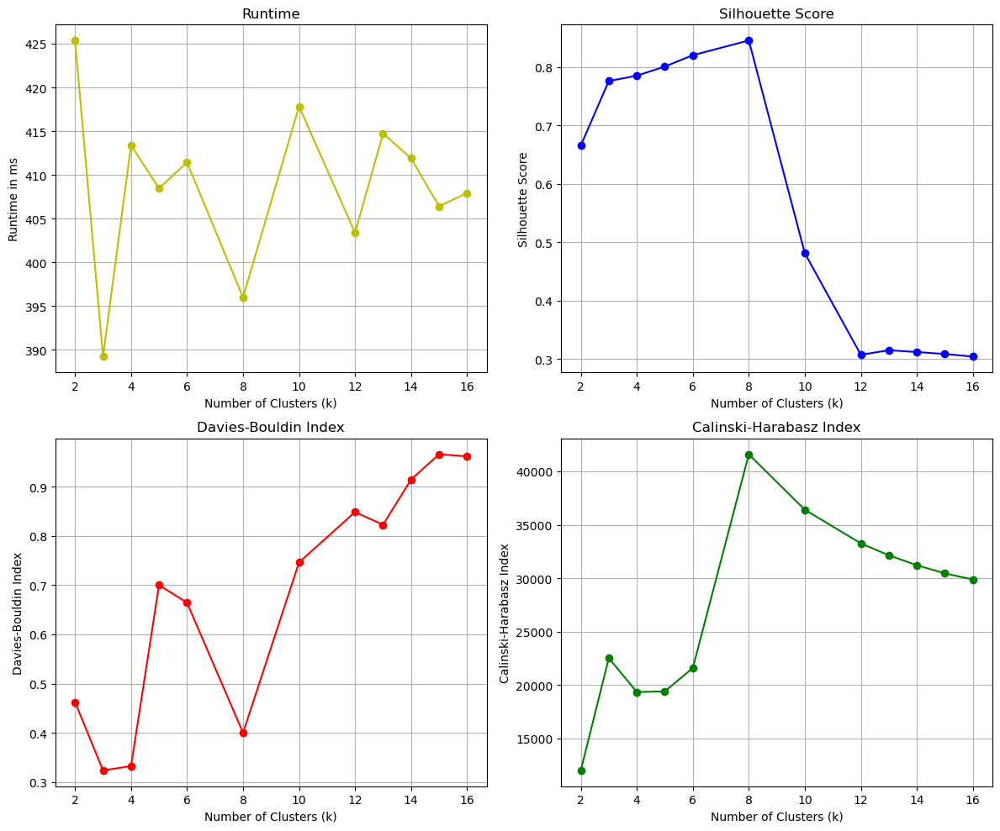

Evaluating with K-means
2 ward
3 ward
4 ward
5 ward
6 ward
8 ward
10 ward
12 ward
13 ward
14 ward
15 ward
16 ward


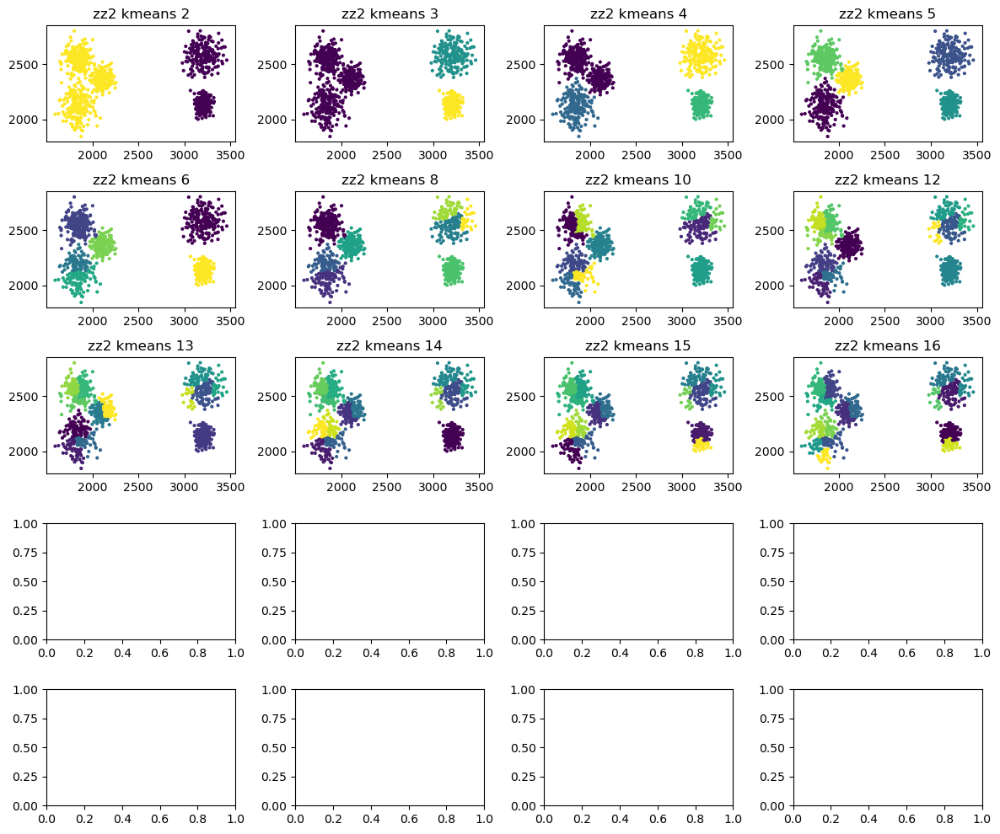

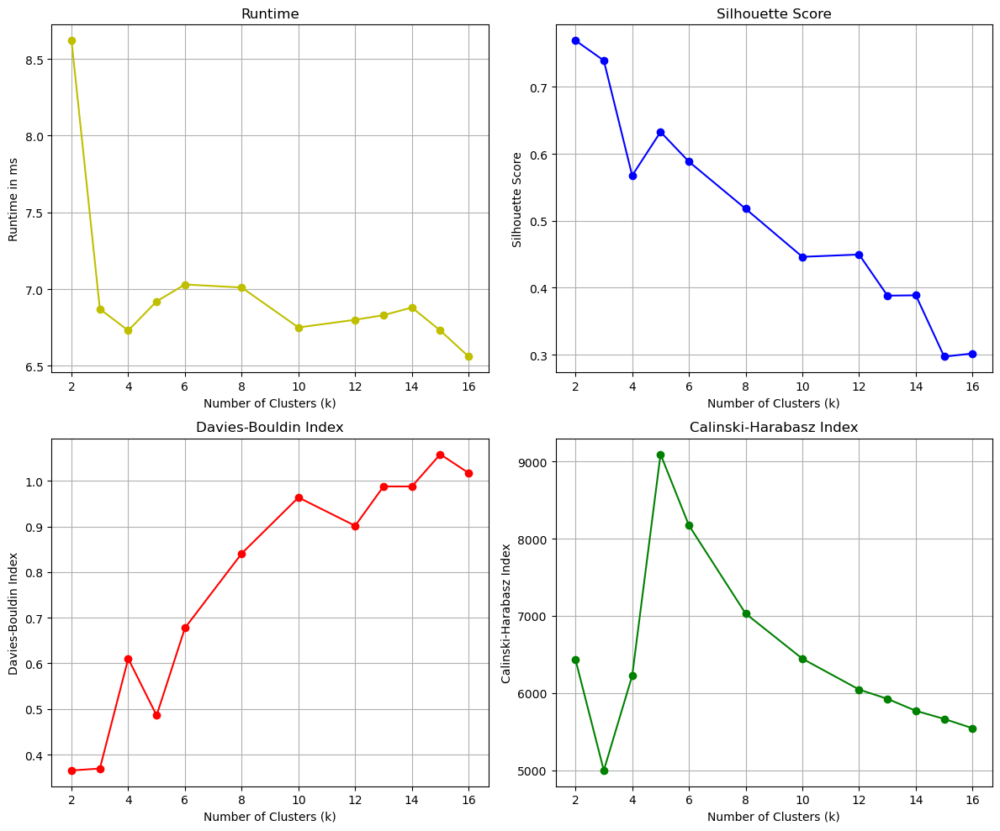

In [24]:
path_rapport = './dataset-rapport'

# Load the dataset
# The data is x y coordinates in 2 columns

files = ['x1', 'x2', 'x3', 'x4', 'y1', 'zz1', 'zz2']

for filename in files:
    data = np.loadtxt(path_rapport + '/' + filename + '.txt')
    f0 = data[:,0]
    f1 = data[:,1]

    # Evaluating
    if filename != 'y1':
        ks = [2,3,4,5,6,8,10,12,13,14,15,16]
        print("Evaluating with K-means")
        evaluate_clustering(filename, "kmeans", ks, path=path_rapport)

2 single
3 single
4 single
5 single
6 single
8 single
10 single
12 single
13 single
14 single
15 single
16 single
100 single
500 single


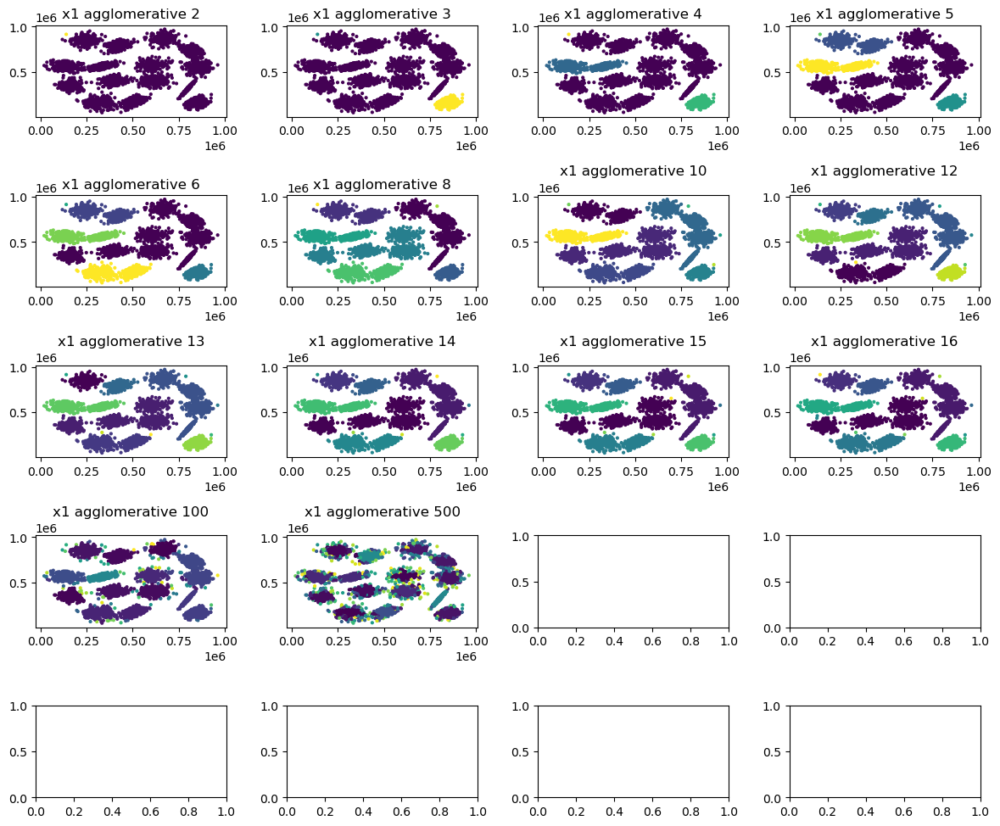

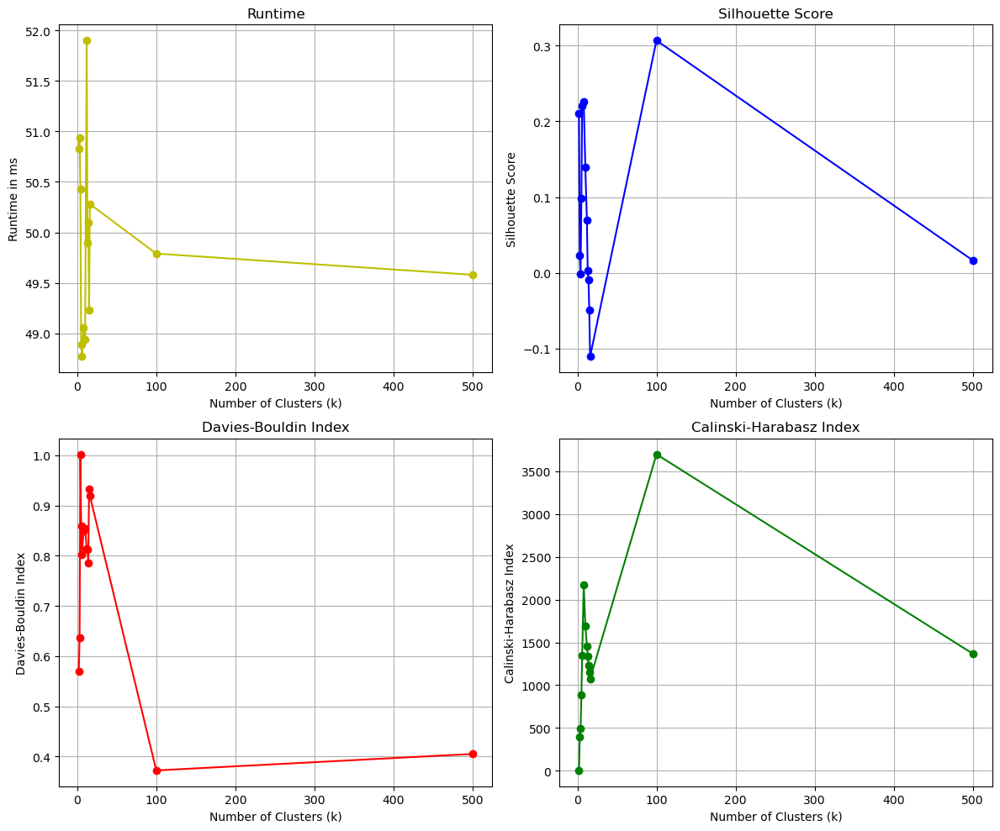

2 single
3 single
4 single
5 single
6 single
8 single
10 single
12 single
13 single
14 single
15 single
16 single
100 single
500 single


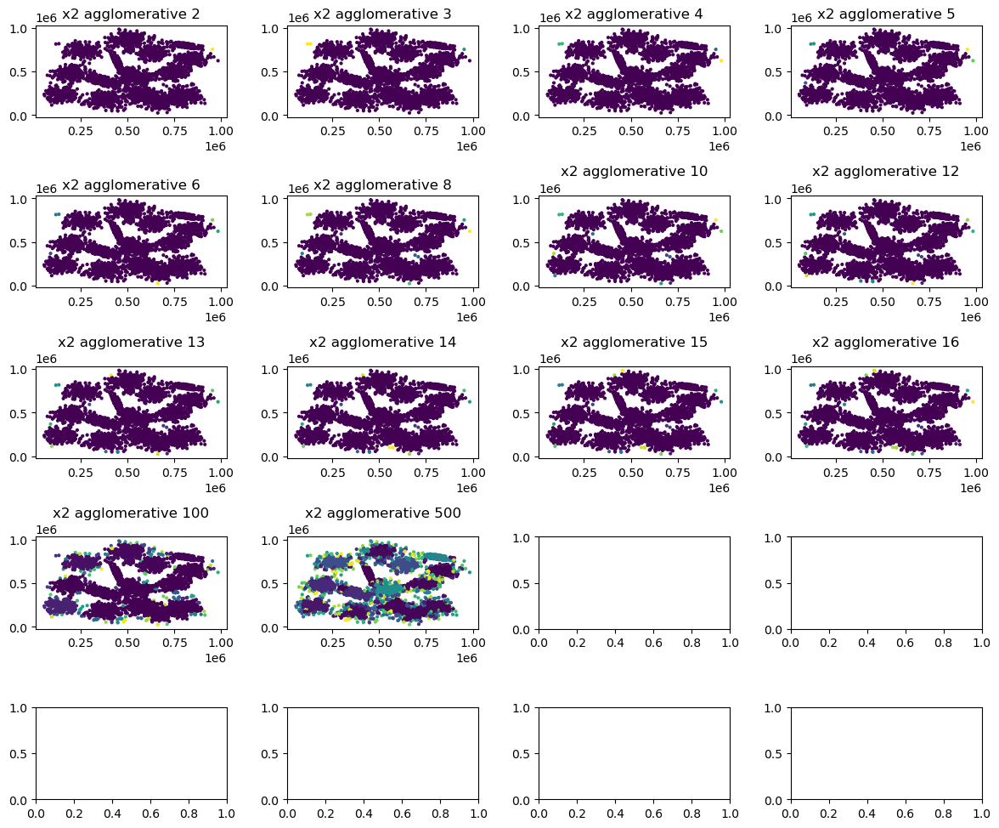

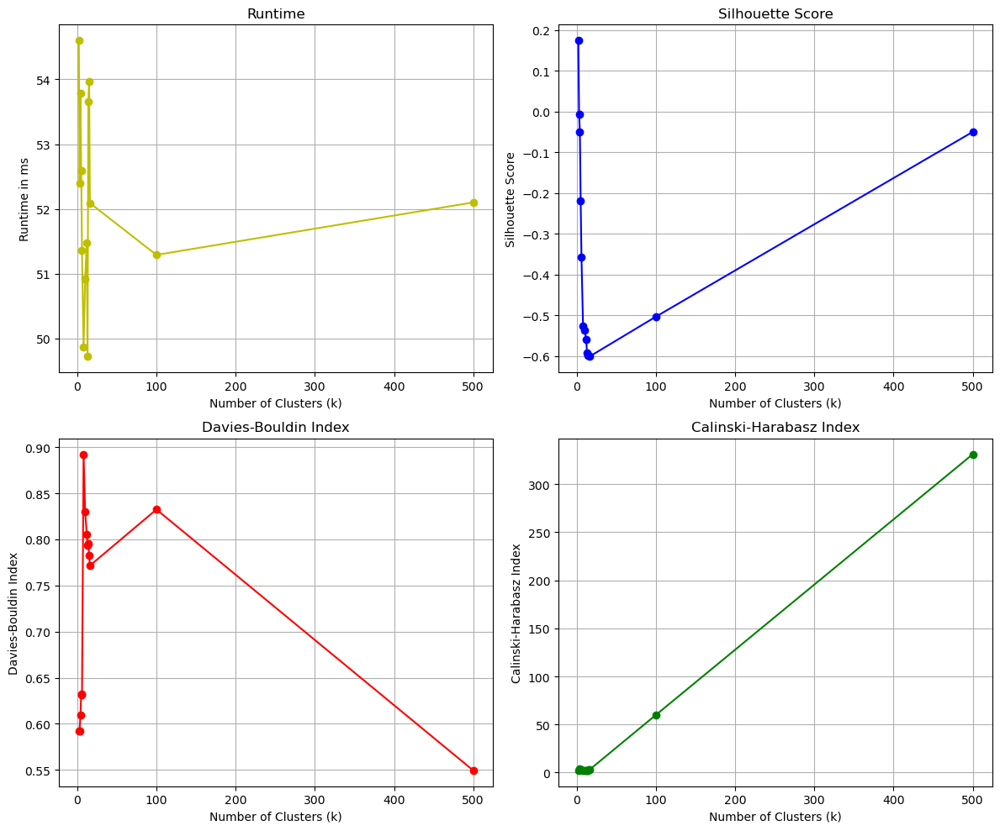

2 single
3 single
4 single
5 single
6 single
8 single
10 single
12 single
13 single
14 single
15 single
16 single
100 single
500 single


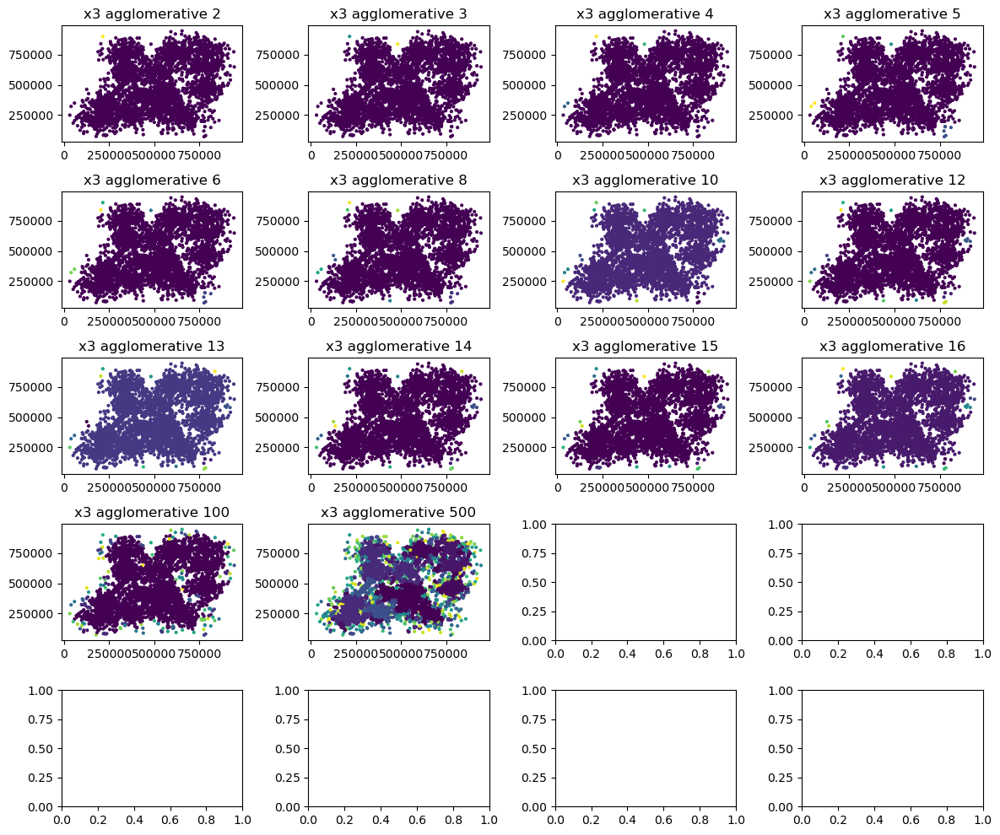

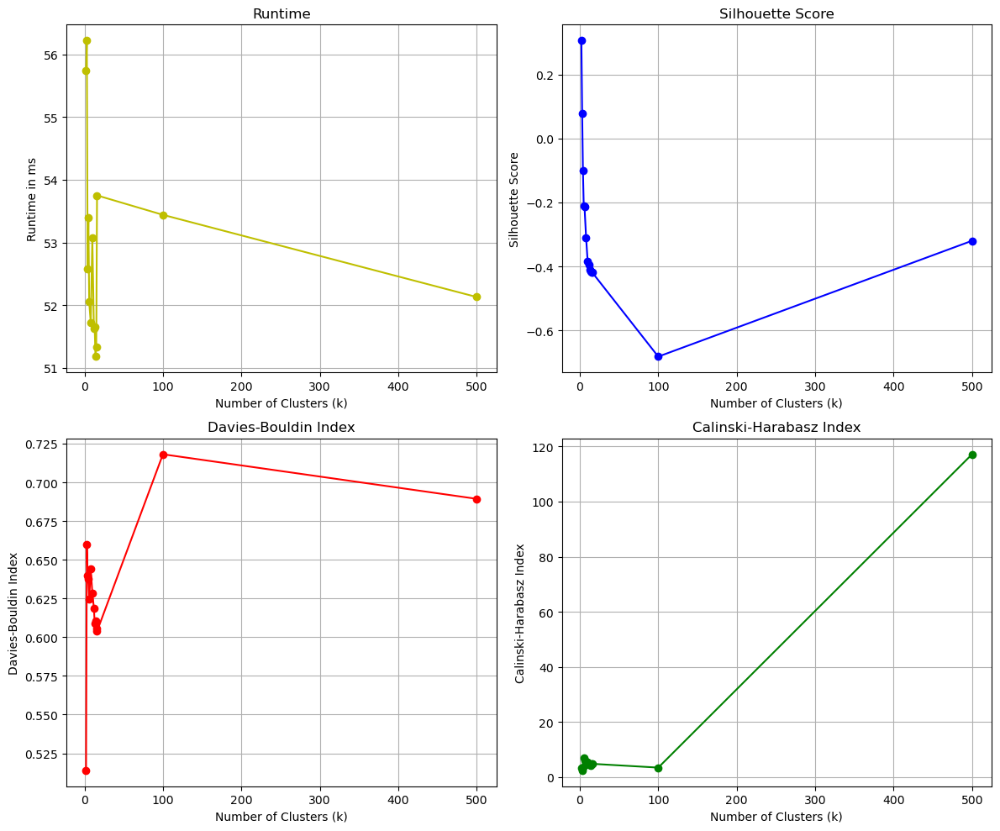

2 single
3 single
4 single
5 single
6 single
8 single
10 single
12 single
13 single
14 single
15 single
16 single
100 single
500 single


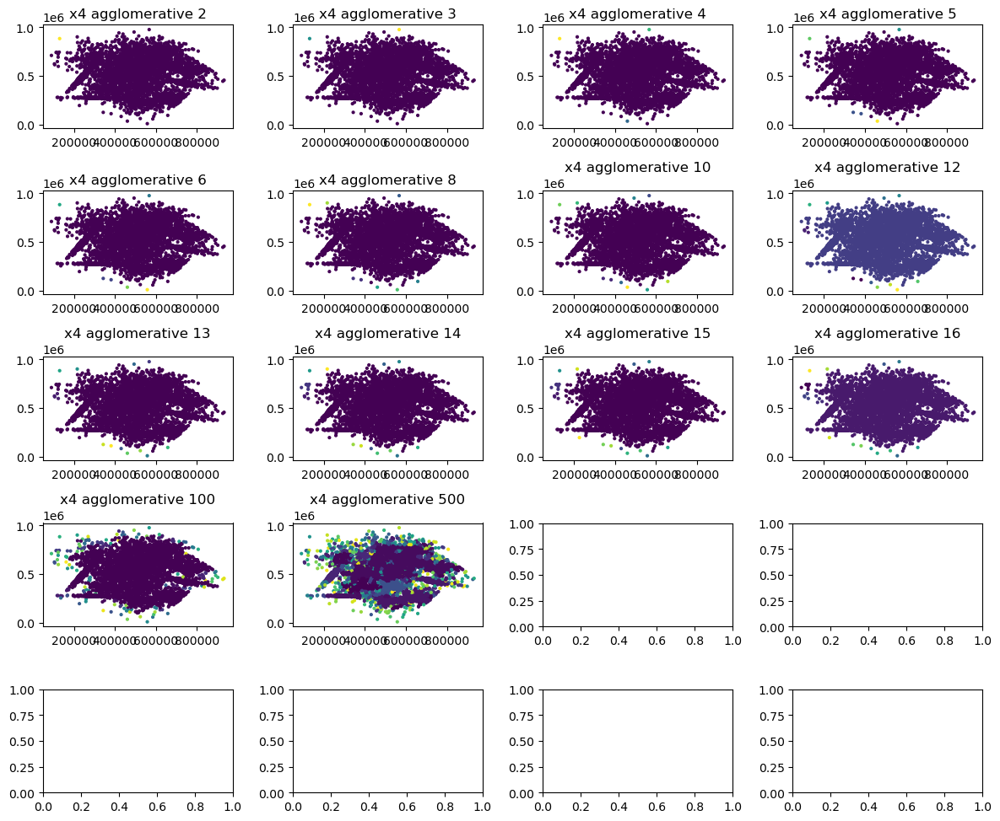

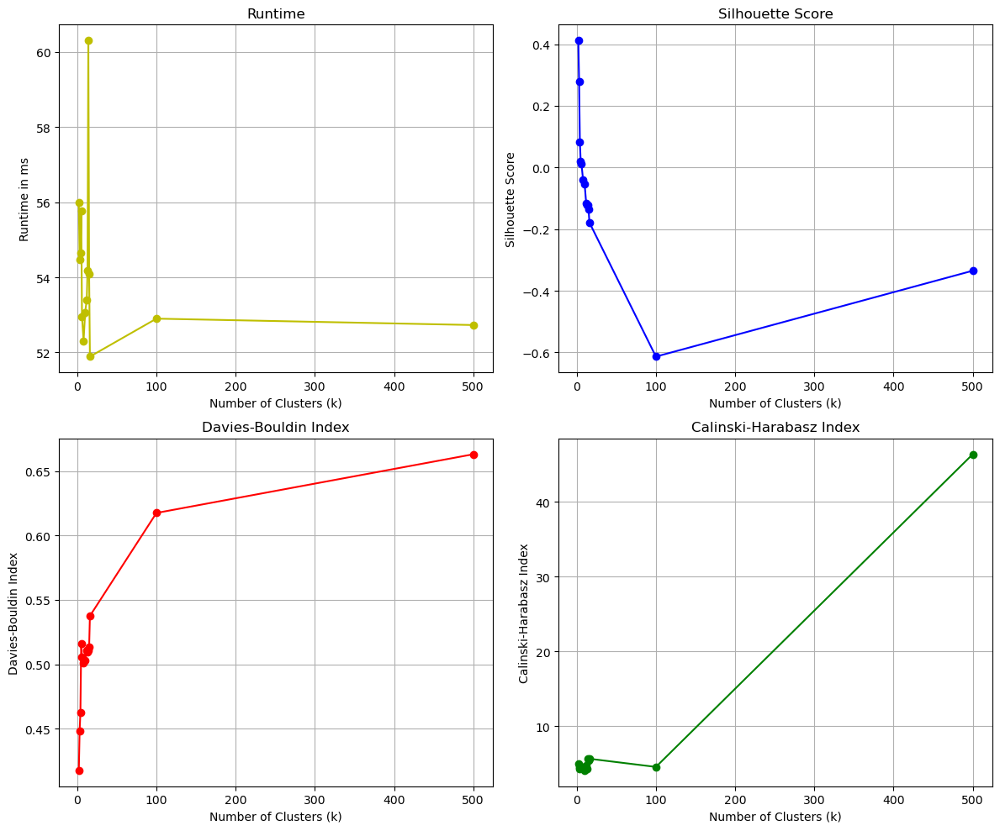

2 single
3 single
4 single
5 single
6 single
8 single
10 single
12 single
13 single
14 single
15 single
16 single
100 single
500 single


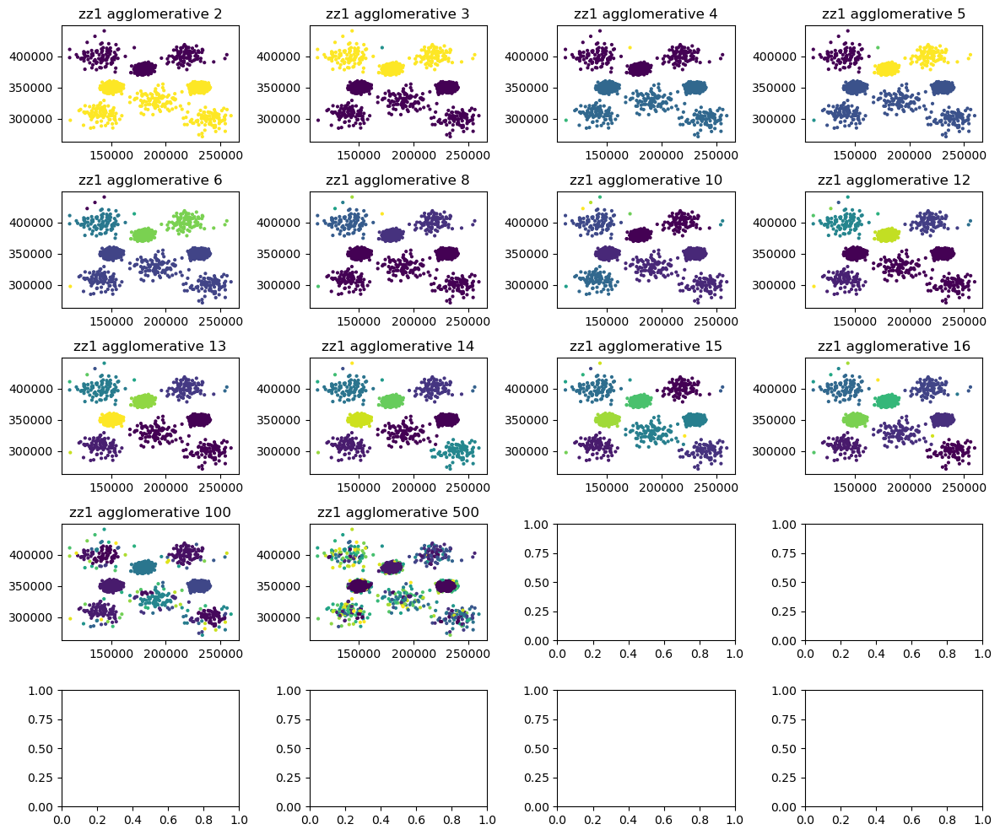

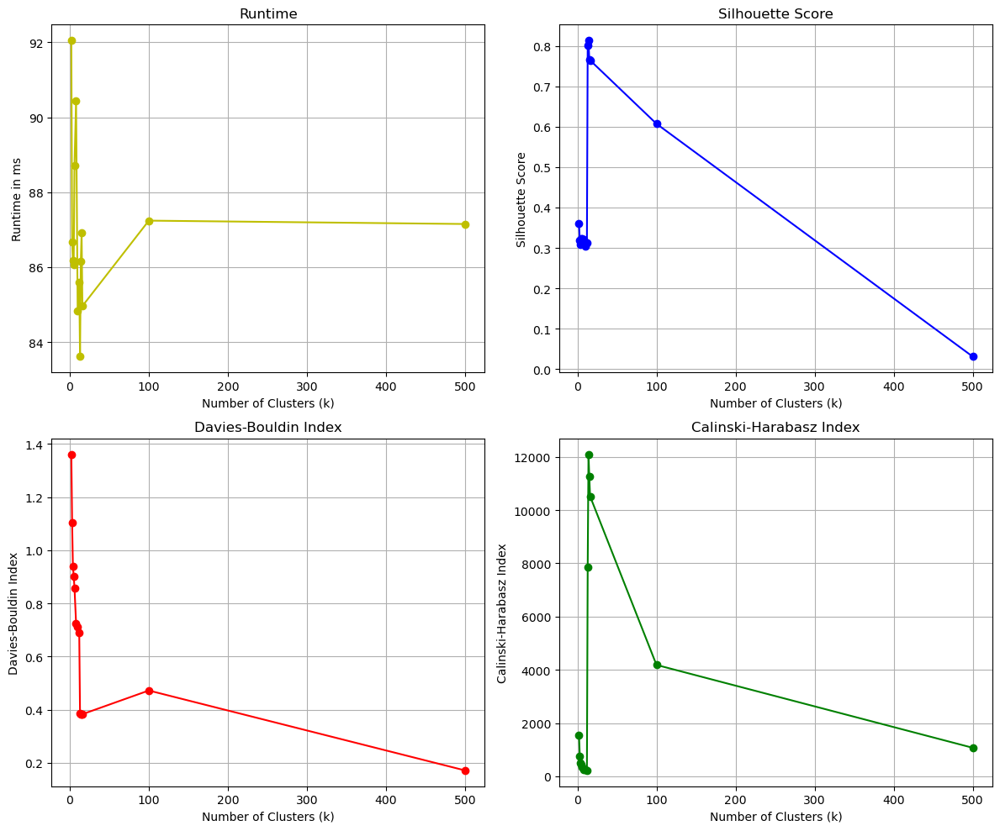

2 single
3 single
4 single
5 single
6 single
8 single
10 single
12 single
13 single
14 single
15 single
16 single
100 single
500 single


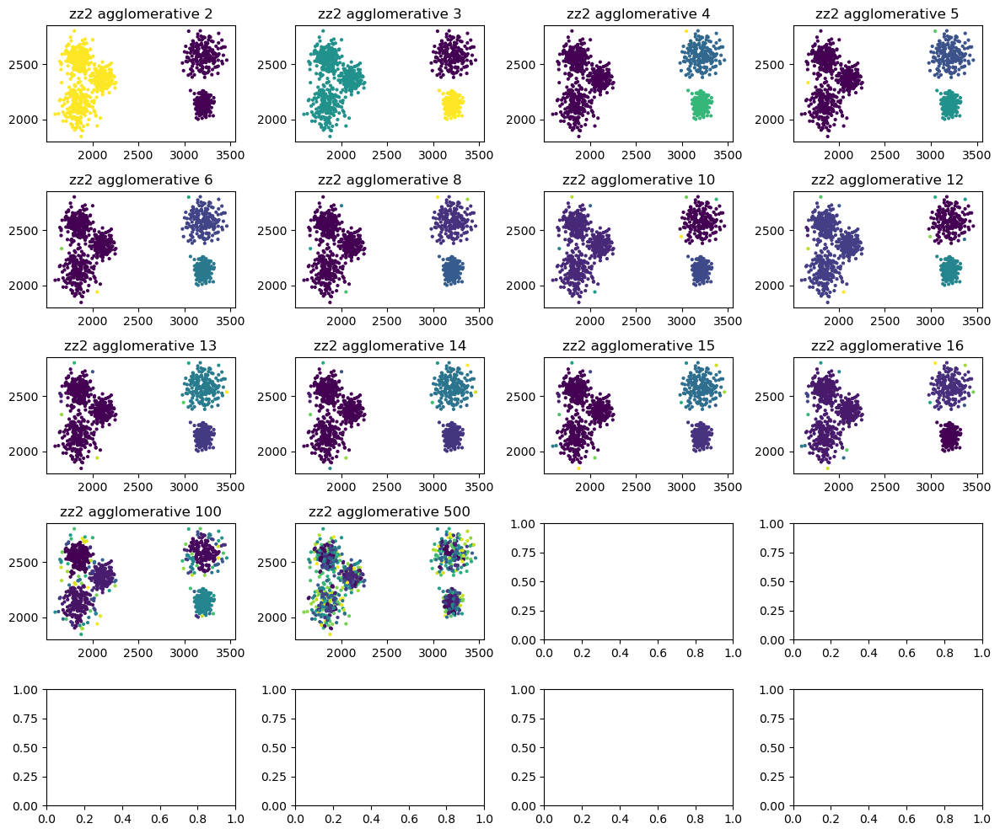

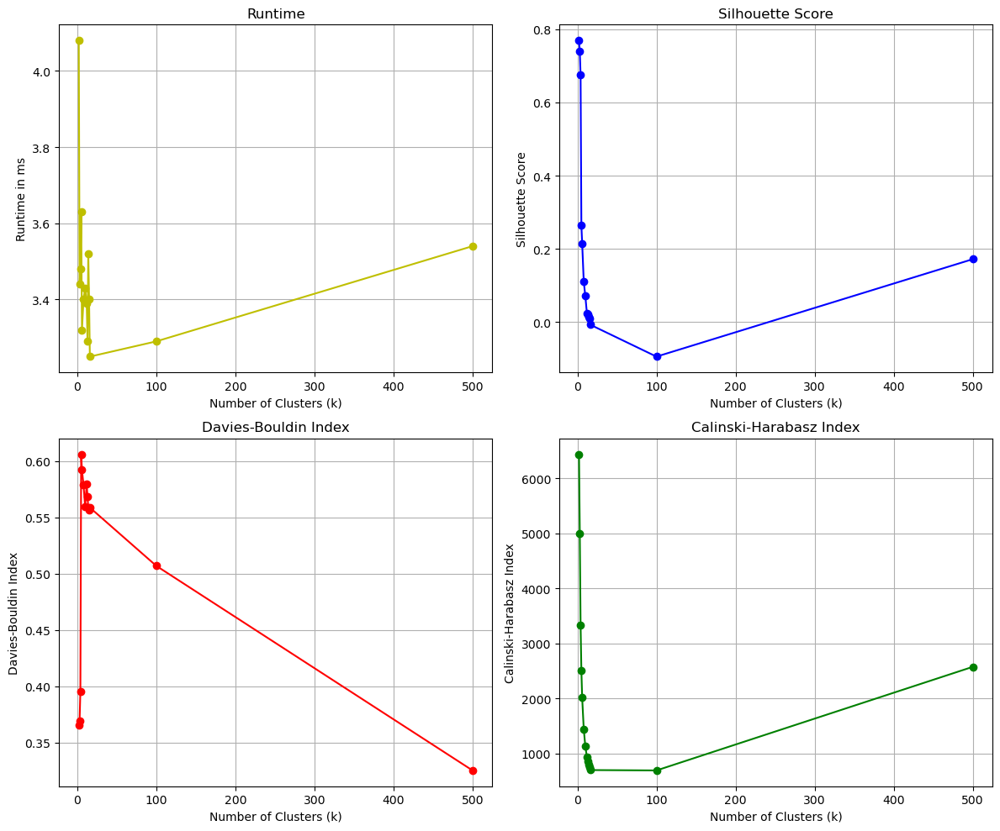

In [25]:
path_rapport = './dataset-rapport'

# Load the dataset
# The data is x y coordinates in 2 columns

files = ['x1', 'x2', 'x3', 'x4', 'y1', 'zz1', 'zz2']

for filename in files:
    data = np.loadtxt(path_rapport + '/' + filename + '.txt')
    f0 = data[:,0]
    f1 = data[:,1]

    # Evaluating
    if filename != 'y1':
        ks = [2,3,4,5,6,8,10,12,13,14,15,16, 100, 500]
        evaluate_clustering(filename, "agglomerative", agglo_linkage='single', n_clusters=ks, path=path_rapport)
    

Only 1 cluster or as many clusters as points for this model with distance:  0.1
Only 1 cluster or as many clusters as points for this model with distance:  10


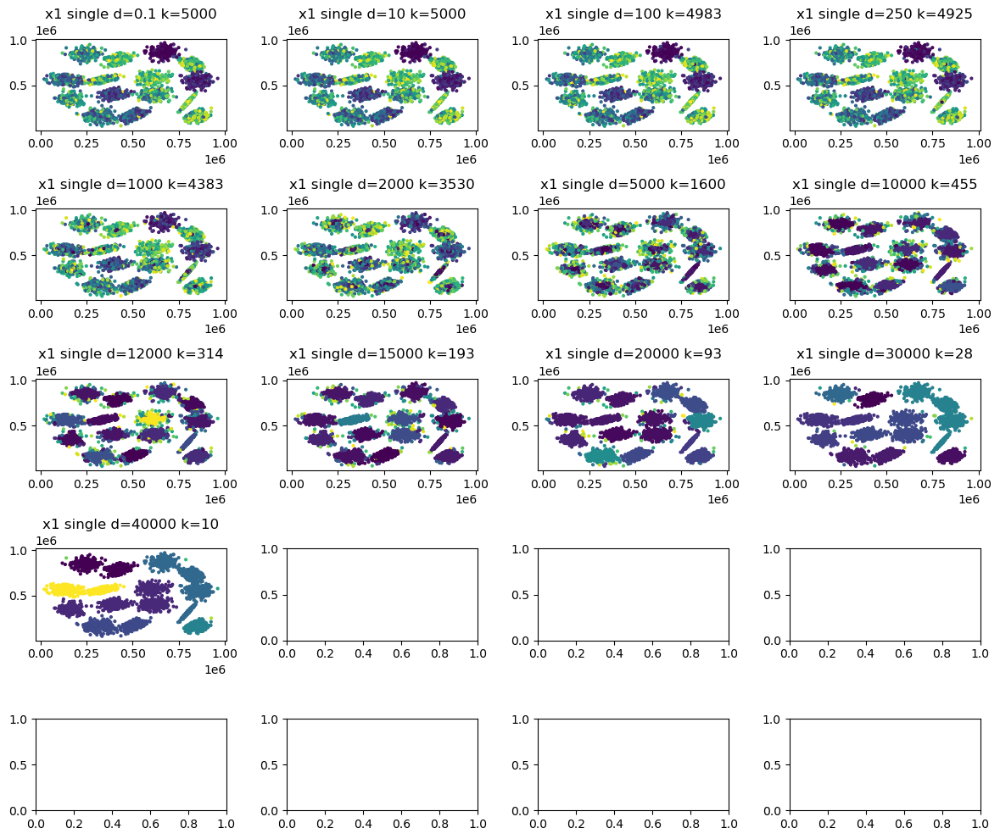

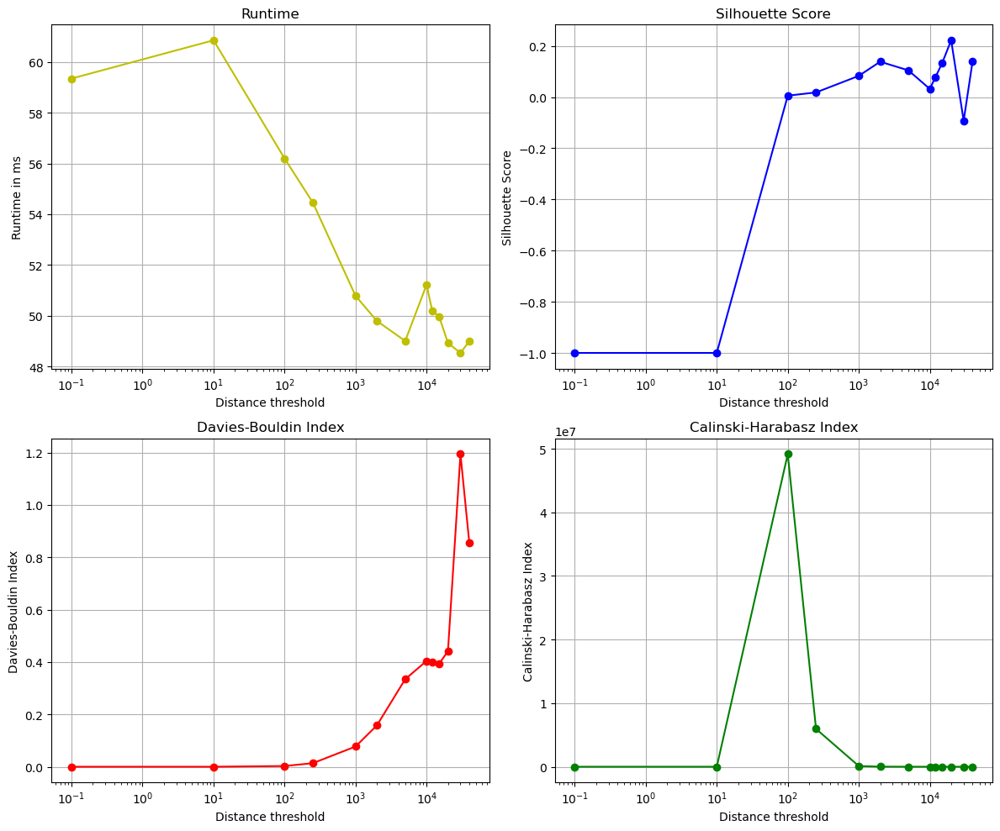

Only 1 cluster or as many clusters as points for this model with distance:  0.1
Only 1 cluster or as many clusters as points for this model with distance:  10


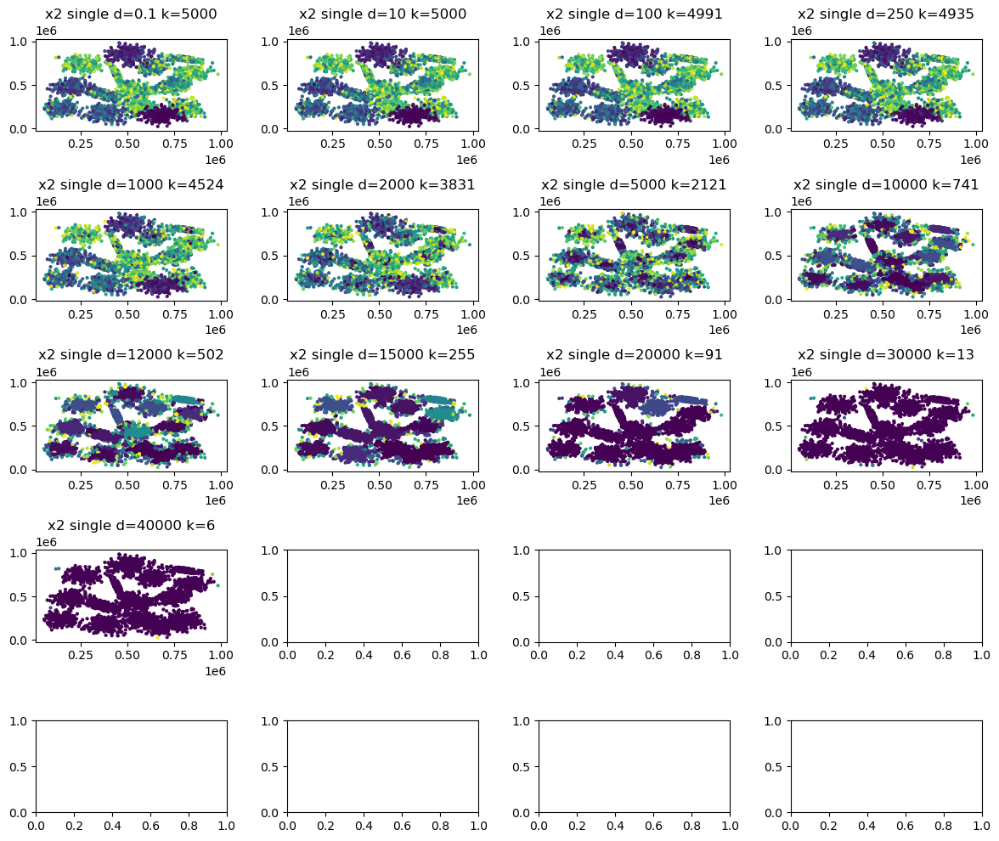

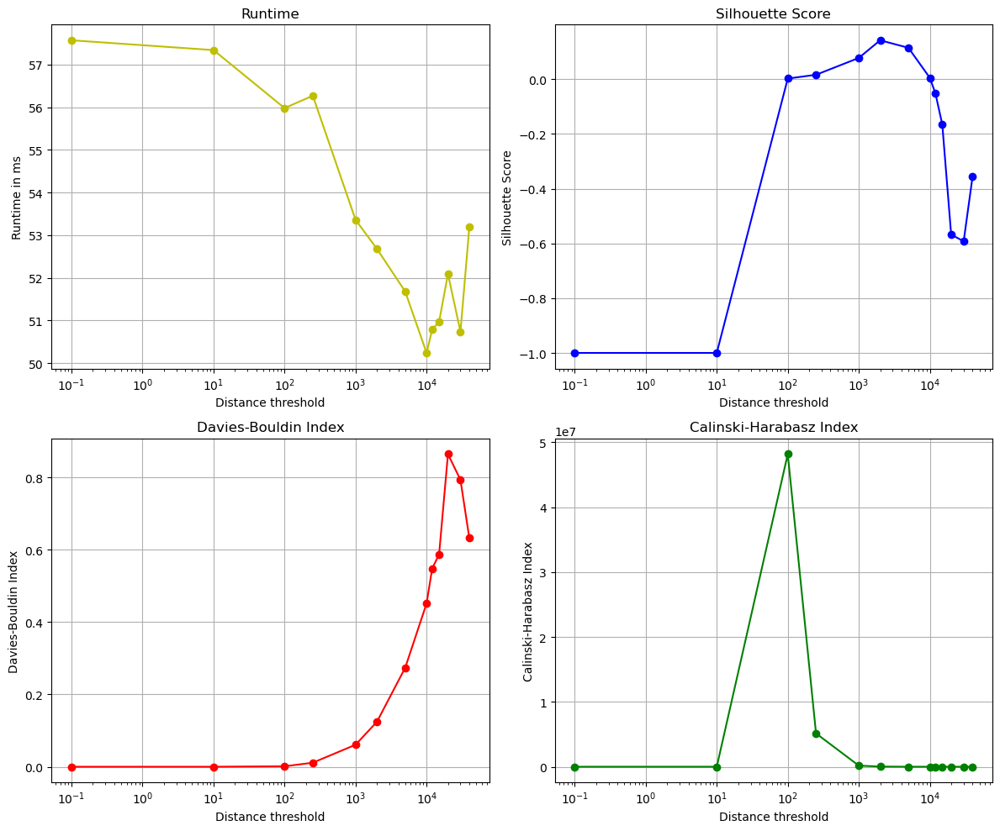

Only 1 cluster or as many clusters as points for this model with distance:  0.1
Only 1 cluster or as many clusters as points for this model with distance:  10


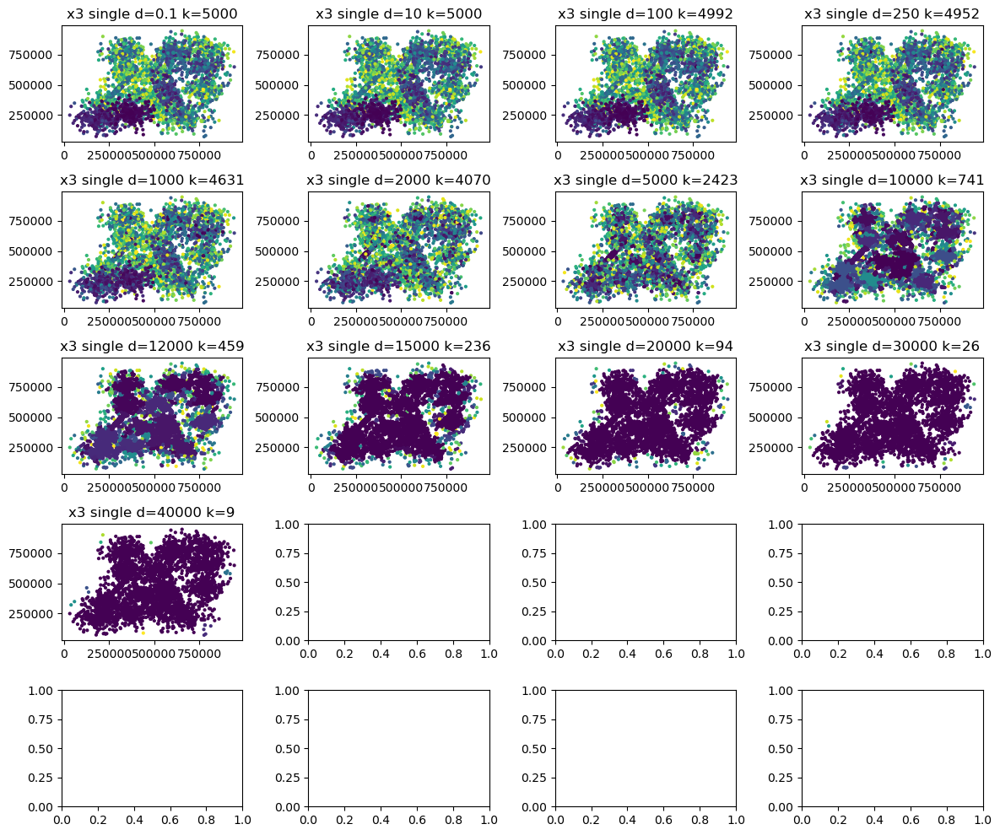

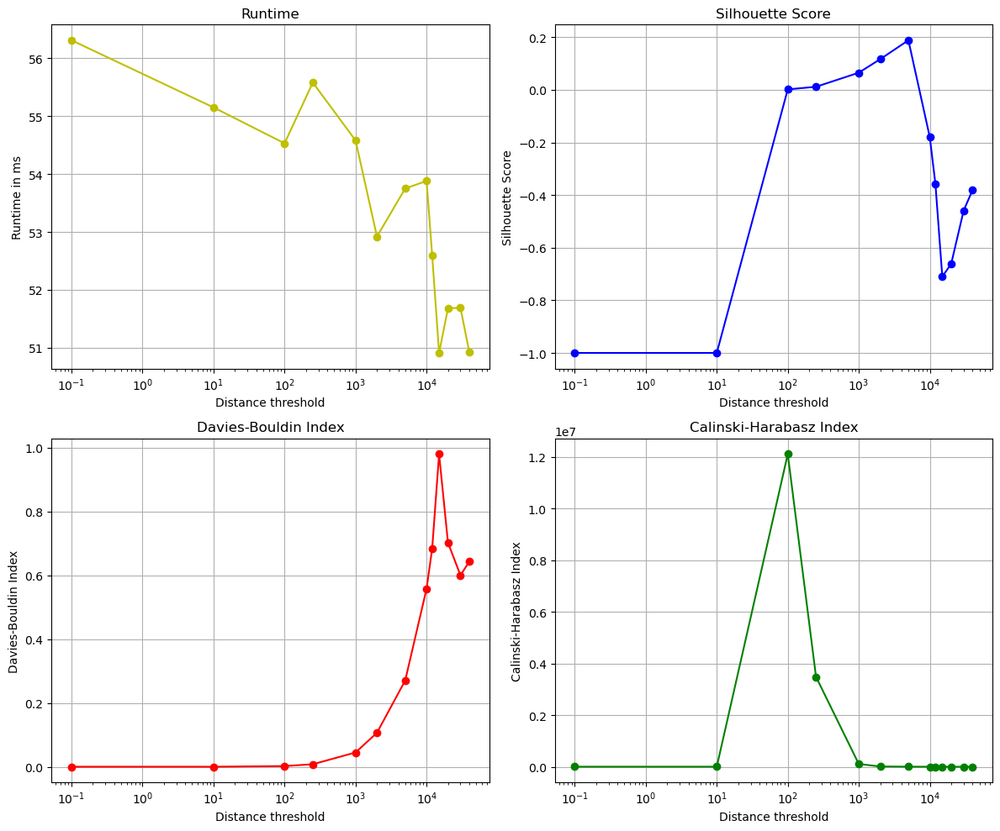

Only 1 cluster or as many clusters as points for this model with distance:  0.1
Only 1 cluster or as many clusters as points for this model with distance:  10


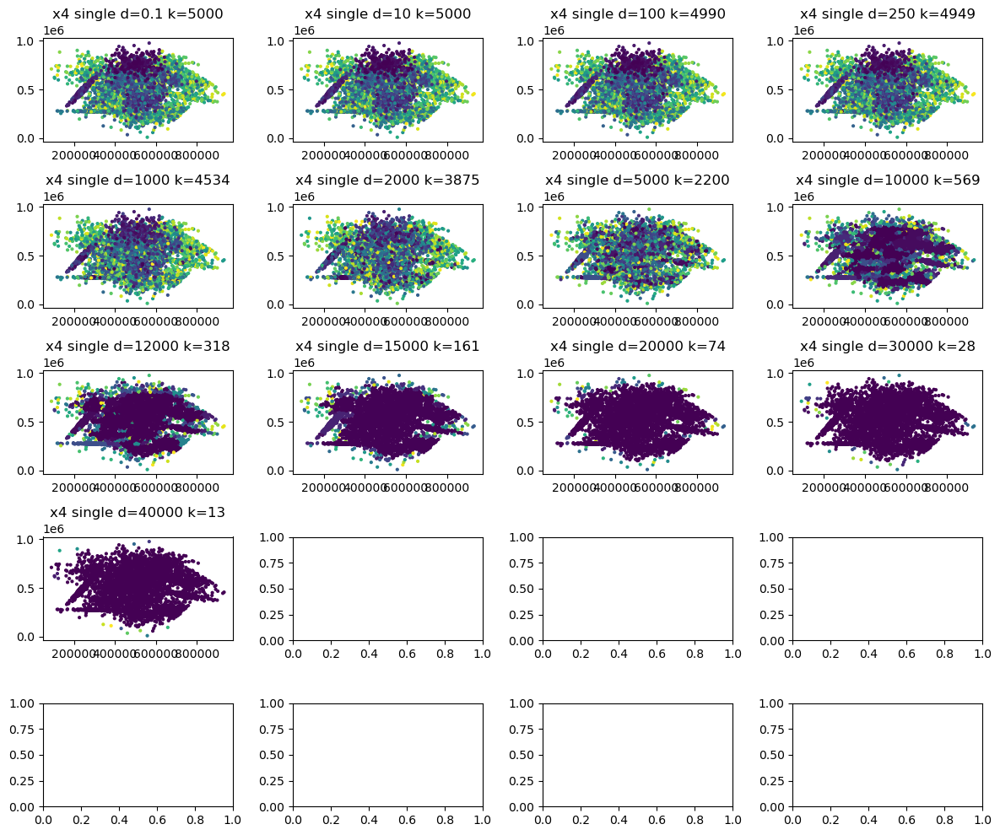

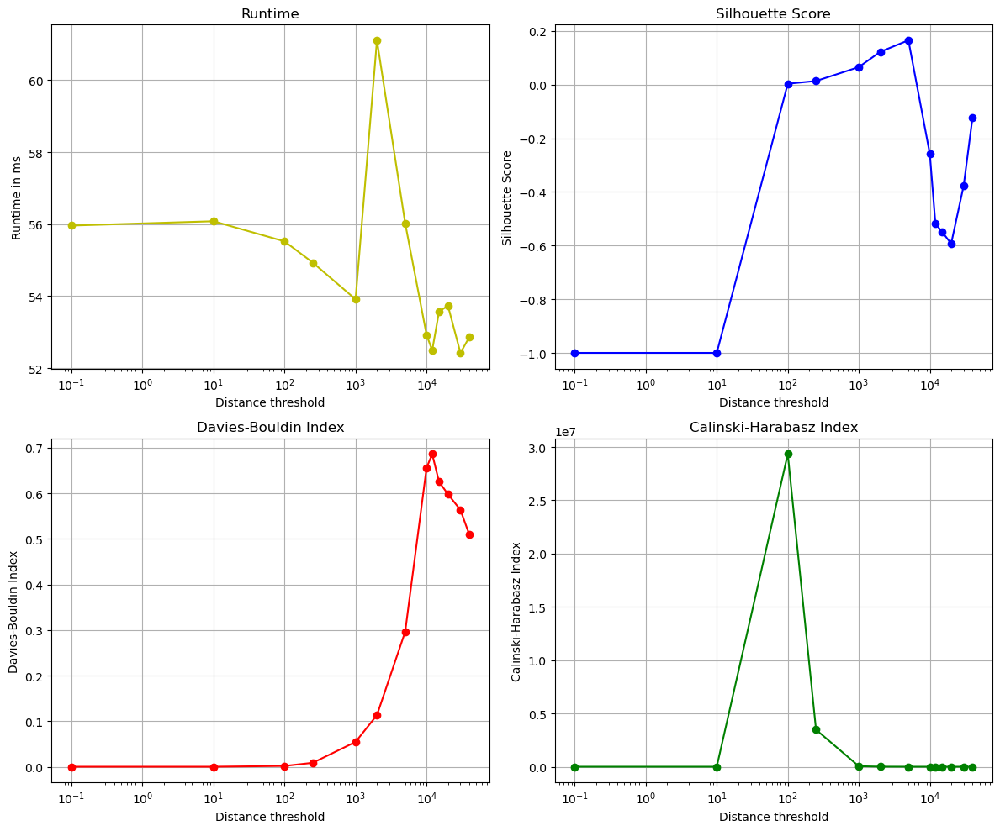

Only 1 cluster or as many clusters as points for this model with distance:  0.1
Only 1 cluster or as many clusters as points for this model with distance:  15000
Only 1 cluster or as many clusters as points for this model with distance:  20000
Only 1 cluster or as many clusters as points for this model with distance:  30000
Only 1 cluster or as many clusters as points for this model with distance:  40000


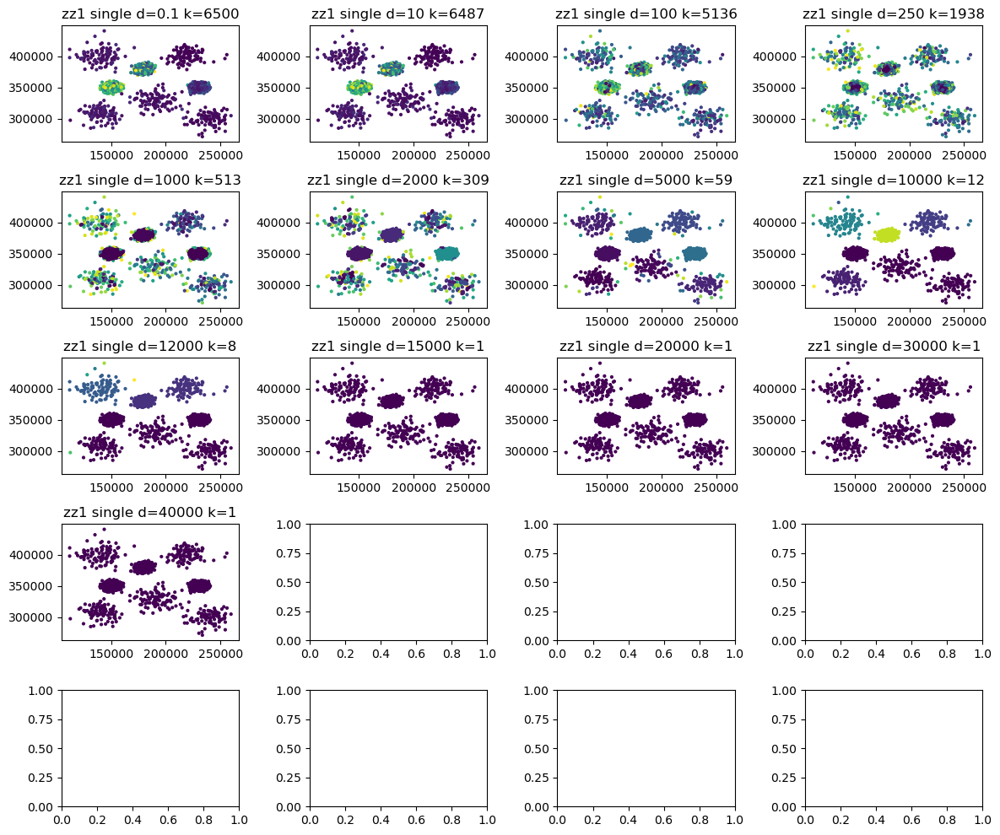

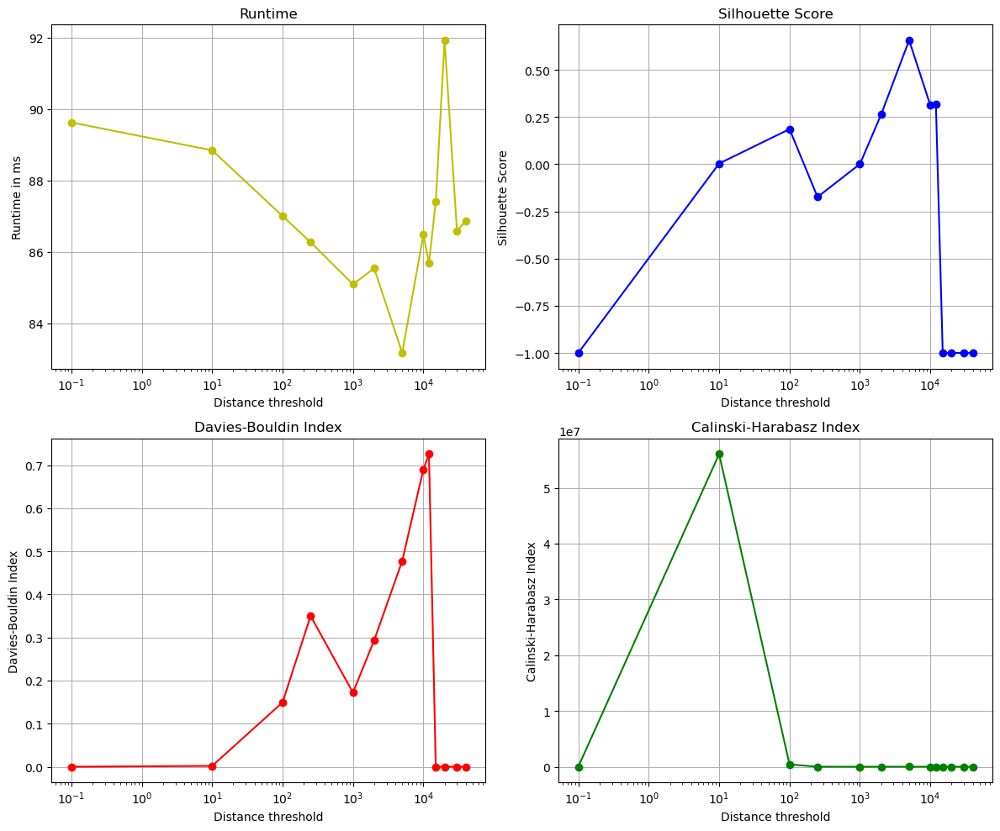

Only 1 cluster or as many clusters as points for this model with distance:  0.1
Only 1 cluster or as many clusters as points for this model with distance:  1000
Only 1 cluster or as many clusters as points for this model with distance:  2000
Only 1 cluster or as many clusters as points for this model with distance:  5000
Only 1 cluster or as many clusters as points for this model with distance:  10000
Only 1 cluster or as many clusters as points for this model with distance:  12000
Only 1 cluster or as many clusters as points for this model with distance:  15000
Only 1 cluster or as many clusters as points for this model with distance:  20000
Only 1 cluster or as many clusters as points for this model with distance:  30000
Only 1 cluster or as many clusters as points for this model with distance:  40000


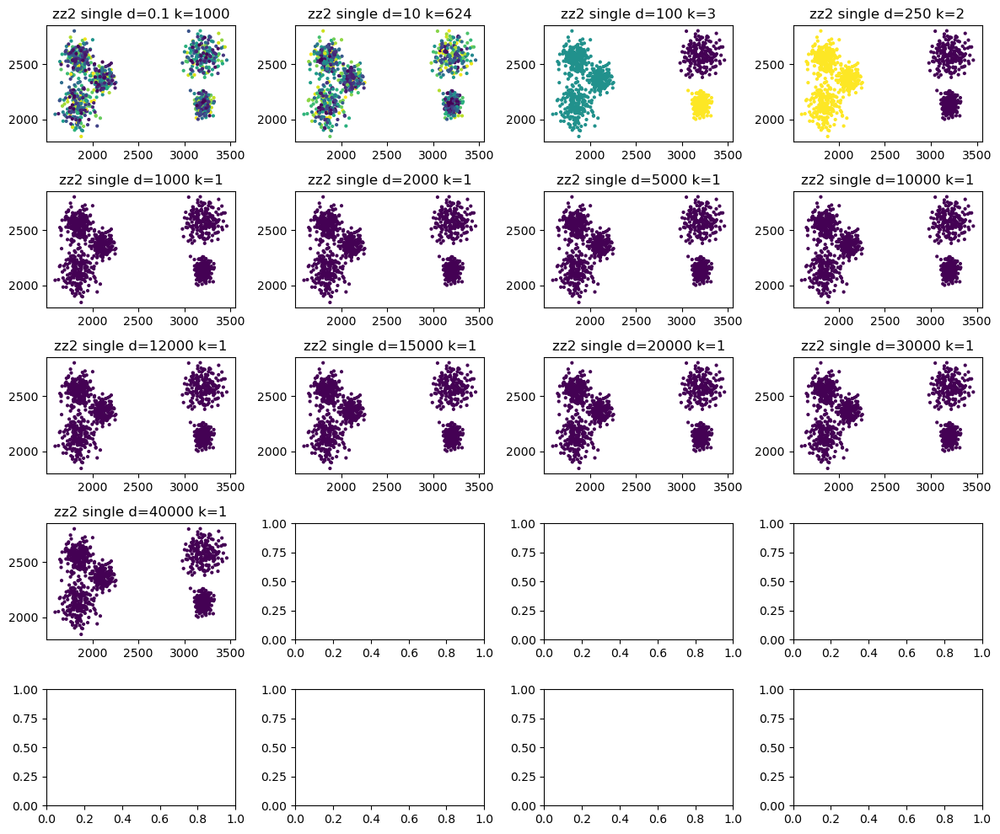

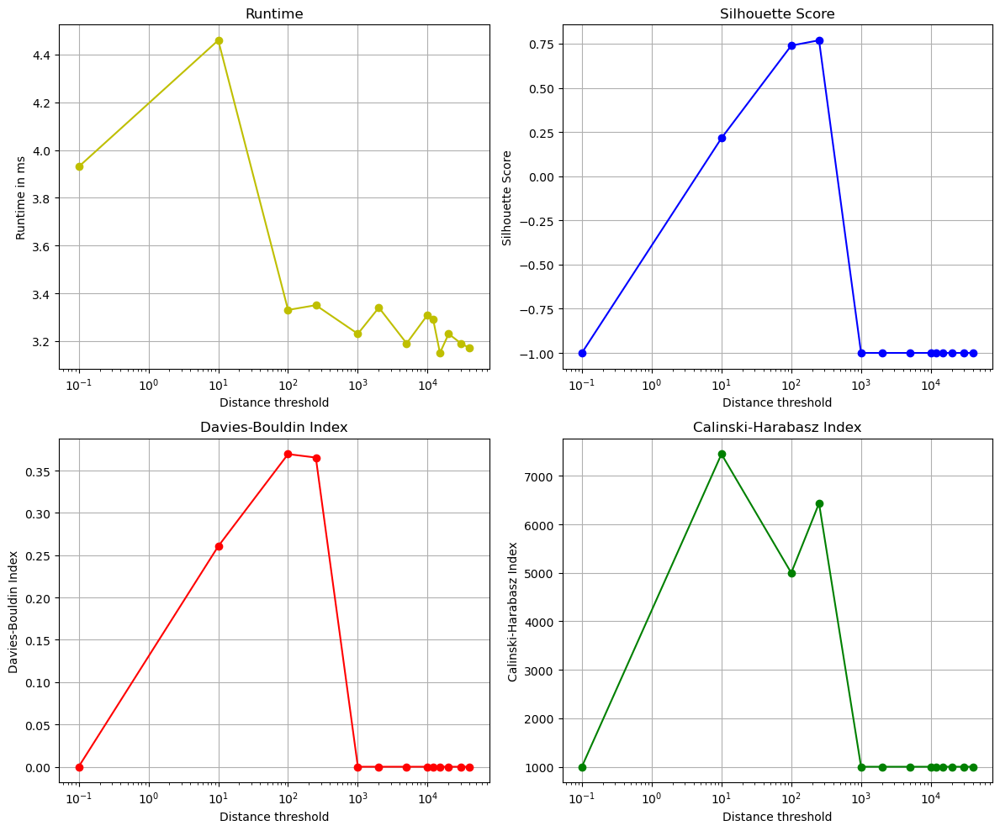

In [26]:
path_rapport = './dataset-rapport'

# Load the dataset
# The data is x y coordinates in 2 columns

files = ['x1', 'x2', 'x3', 'x4', 'y1', 'zz1', 'zz2']

for filename in files:
    data = np.loadtxt(path_rapport + '/' + filename + '.txt')
    f0 = data[:,0]
    f1 = data[:,1]

    # Evaluating
    if filename != 'y1':
        dists = [0.1, 10, 100, 250, 1000, 2000, 5000, 10000, 12000, 15000, 20000, 30000, 40000]
        evaluate_clustering(filename, "agglomerative", agglo_linkage='single', use_distance_threshold=True, dists=dists, path=path_rapport)
    

# Y1

In [27]:
path_rapport = './dataset-rapport'


data = np.loadtxt(path_rapport + '/' + 'y1' + '.txt')
f0 = data[:,0]
f1 = data[:,1]

ks = [2,3,4,5,6,8,10,12,13,14,15,16, 100, 500]
dists = [0.1, 10, 100, 250, 1000, 2000, 5000, 10000, 12000, 15000, 20000, 30000, 40000]
evaluate_clustering('y1', "kmeans", ks, path=path_rapport)

2 ward


MemoryError: Unable to allocate 41.5 GiB for an array with shape (5575627200,) and data type float64

In [ ]:
path_rapport = './dataset-rapport'


data = np.loadtxt(path_rapport + '/' + 'y1' + '.txt')
f0 = data[:,0]
f1 = data[:,1]

ks = [2,3,4,5,6,8,10,12,13,14,15,16, 100, 500]
dists = [0.1, 10, 100, 250, 1000, 2000, 5000, 10000, 12000, 15000, 20000, 30000, 40000]

evaluate_clustering('y1', "agglomerative", agglo_linkage='single', n_clusters=ks, path=path_rapport)


In [ ]:
path_rapport = './dataset-rapport'


data = np.loadtxt(path_rapport + '/' + 'y1' + '.txt')
f0 = data[:,0]
f1 = data[:,1]

ks = [2,3,4,5,6,8,10,12,13,14,15,16, 100, 500]
dists = [0.1, 10, 100, 250, 1000, 2000, 5000, 10000, 12000, 15000, 20000, 30000, 40000]
evaluate_clustering('y1', "agglomerative", agglo_linkage='single', use_distance_threshold=True, dists=dists, path=path_rapport)